In [1]:
!pwd
import sys

/c/Users/81908/jupyter_notebook/tf_2_work/Probspace_geme_compe/notebook


In [2]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline
sys.executable

'C:\\Users\\81908\\Anaconda3\\envs\\tfgpu\\python.exe'

# 対戦ゲームデータ分析甲子園
- https://prob.space/competitions/game_winner/data/62

In [3]:
import os
import gc
import sys
import joblib
import warnings
import itertools

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import optuna
from joblib import Parallel, delayed
from sklearn import preprocessing
from sklearn.feature_selection import RFECV
from sklearn.inspection import permutation_importance
from sklearn.model_selection import *
from sklearn.metrics import *
import lightgbm as lgb
from lightgbm import *

sys.path.append(r"C:\Users\81908\Git\xfeat")
import xfeat
from xfeat import *
from xfeat.selector import *
from xfeat.utils import compress_df

sns.set()
warnings.simplefilter(action="ignore", category=FutureWarning)
pd.set_option("display.max_columns", None)

In [4]:
OUT_DATA = r"C:\Users\81908\jupyter_notebook\tf_2_work\Probspace_geme_compe\data\second"
os.makedirs(OUT_DATA, exist_ok=True)

OUT_MODEL = (
    r"C:\Users\81908\jupyter_notebook\tf_2_work\Probspace_geme_compe\model\second"
)
os.makedirs(OUT_MODEL, exist_ok=True)

ORIG = r"C:\Users\81908\jupyter_notebook\tf_2_work\Probspace_geme_compe\data\orig"
train_df = pd.read_csv(f"{ORIG}/train_data.csv")
test_df = pd.read_csv(f"{ORIG}/test_data.csv")
df_all = train_df.append(test_df).reset_index(drop=True)

helper関数

In [5]:
def target_corr(df, target_col="y", png_path=None):
    """目的変数との数値列との相関係数確認"""
    num_cols = df.select_dtypes(
        include=["int", "int32", "int64", "float", "float32", "float64"]
    ).columns.to_list()
    if target_col in num_cols:
        num_cols.remove(target_col)
    corrs = []
    for col in num_cols:
        s1 = df[col]
        s2 = df[target_col]
        corr = s1.corr(s2)
        corrs.append(abs(round(corr, 3)))

    df_corr = pd.DataFrame({"feature": num_cols, "y_corr": corrs}).sort_values(
        by="y_corr", ascending=False
    )

    plt.figure(figsize=(8, 10))
    sns.barplot(
        x="y_corr", y="feature", data=df_corr.head(50),
    )
    plt.title(f"target_corr")
    plt.tight_layout()
    if png_path is not None:
        plt.savefig(png_path)

    return df_corr

# 特徴量追加

In [6]:
def time_cols(df, date_col):
    df[date_col] = pd.to_datetime(df[date_col])  # dtype を datetime64 に変換
    # 期間短いから週と時間だけにしておく
    # df['year'] = df[date_col].dt.year
    # df['month'] = df[date_col].dt.month
    # df['day'] = df[date_col].dt.day
    # df['dayofyear'] = df[date_col].dt.dayofyear
    df["dayofweek"] = df[date_col].dt.dayofweek
    df["weekend"] = (df[date_col].dt.dayofweek.values >= 5).astype(int)
    df["hour"] = df[date_col].dt.hour
    return df


df_all["period"] = pd.to_datetime(df_all["period"], format="%Y-%m-%d %H:%M:%S")
df_all = df_all.set_index("period", drop=False)
df_all = time_cols(df_all, "period")
print(df_all.shape)

(94465, 35)


In [7]:
# 不要な列削除
df_all = df_all.drop(["id", "period", "game-ver", "lobby"], axis=1)

base_num_cols = df_all.select_dtypes(
    include=["int", "int32", "int64", "float", "float32", "float64"]
).columns.to_list()
base_cate_cols = df_all.select_dtypes(
    include=["object", "category", "bool"]
).columns.to_list()
print(df_all.shape)

(94465, 31)


In [8]:
def log1p(df, num_cols):
    for col in num_cols:
        df[f"{col}_log1p"] = np.log(df[col] + 1)
    return df


log1p_cols = [
    "A2-level",
    "A3-level",
    "A4-level",
    "B1-level",
    "B2-level",
    "B3-level",
    "B4-level",
]
df_all = log1p(df_all, log1p_cols)
print(df_all.shape)

(94465, 38)


In [9]:
def add_cate(df, cat_features):
    # 文字列を2列結合
    for col1, col2 in tqdm(itertools.combinations(cat_features, 2)):
        new_col_name = "_".join([col1, col2])
        new_values = df[col1].map(str) + "_" + df[col2].map(str)
        # encoder = preprocessing.LabelEncoder()
        df[new_col_name] = new_values  # encoder.fit_transform(new_values)

    return df

# rankと武器のペアで列作成
for i in range(1,5):
    df_all = add_cate(df_all, [f"A{i}-rank", f"A{i}-weapon"])
    df_all = add_cate(df_all, [f"B{i}-rank", f"B{i}-weapon"])
# display(df_all)
print(df_all.shape)

1it [00:00, 31.70it/s]
1it [00:00, 33.42it/s]
1it [00:00, 33.42it/s]
1it [00:00, 32.37it/s]
1it [00:00, 33.42it/s]
1it [00:00, 33.42it/s]
1it [00:00, 33.39it/s]
1it [00:00, 32.32it/s]


(94465, 46)


In [10]:
def add_cates(df, cols, new_col_name):
    """複数列一気に連結"""
    df[new_col_name] = df[cols[0]].str.cat(df[cols[1:]], sep='_')
    return df


# Aチーム 4人 vs Bチーム 4人で戦ってるっぽいからA毎、B毎に組み合わせる
a_ranks = [
    "A1-rank",
    "A2-rank",
    "A3-rank",
    "A4-rank",
]
a_weapons = [
    "A1-weapon",
    "A2-weapon",
    "A3-weapon",
    "A4-weapon",
]
b_ranks = [
    "B1-rank",
    "B2-rank",
    "B3-rank",
    "B4-rank",
]
b_weapons = [
    "B1-weapon",
    "B2-weapon",
    "B3-weapon",
    "B4-weapon",
]

df_all = add_cates(df_all, a_ranks, "A_ranks")
df_all = add_cates(df_all, a_weapons, "A_weapons")
df_all = add_cates(df_all, [*a_ranks, *a_weapons], "A_ranks_weapons")
df_all = add_cates(df_all, b_ranks, "B_ranks")
df_all = add_cates(df_all, b_weapons, "B_weapons")
df_all = add_cates(df_all, [*b_ranks, *b_weapons], "B_ranks_weapons")

# display(df_all)
print(df_all.shape)

(94465, 52)


In [12]:
# A列でグループして集計したB列は意味がありそうと仮説たててから統計値列作ること
# 目的変数をキーにして集計するとリークしたターゲットエンコーディングになるため説明変数同士で行うこと
def grouping(df, cols, agg_dict, prefix=""):
    """特定のカラムについてgroup化された特徴量の作成を行う
    Args:
        df (pd.DataFrame): 特徴量作成のもととなるdataframe
        cols (str or list): group by処理のkeyとなるカラム (listで複数指定可能)
        agg_dict (dict): 特徴量作成を行いたいカラム/集計方法を指定するdictionary
        prefix (str): 集約後のカラムに付与するprefix name

    Returns:
        df (pd.DataFrame): 特定のカラムについてgroup化された特徴量群
    """
    group_df = df.groupby(cols).agg(agg_dict)
    group_df.columns = [prefix + c[0] + "_" + c[1] for c in list(group_df.columns)]
    group_df.reset_index(inplace=True)

    return group_df


class AggUtil:
    ############## カテゴリ列 vs. 数値列について ##############
    @staticmethod
    def percentile(n):
        """パーセンタイル"""

        def percentile_(x):
            return np.percentile(x, n)

        percentile_.__name__ = "percentile_%s" % n
        return percentile_

    @staticmethod
    def diff_percentile(n1, n2):
        """パーセンタイルの差"""

        def diff_percentile_(x):
            p1 = np.percentile(x, n1)
            p2 = np.percentile(x, n2)
            return p1 - p2

        diff_percentile_.__name__ = f"diff_percentile_{n1}-{n2}"
        return diff_percentile_

    @staticmethod
    def ratio_percentile(n1, n2):
        """パーセンタイルの比"""

        def ratio_percentile_(x):
            p1 = np.percentile(x, n1)
            p2 = np.percentile(x, n2)
            return p1 / p2

        ratio_percentile_.__name__ = f"ratio_percentile_{n1}-{n2}"
        return ratio_percentile_

    @staticmethod
    def mean_var():
        """平均分散"""

        def mean_var_(x):
            x = x.dropna()
            return np.std(x) / np.mean(x)

        mean_var_.__name__ = f"mean_var"
        return mean_var_

    @staticmethod
    def diff_mean():
        """平均との差の中央値(aggは集計値でないとエラーになるから中央値をとる)"""

        def diff_mean_(x):
            x = x.dropna()
            return np.median(x - np.mean(x))

        diff_mean_.__name__ = f"diff_mean"
        return diff_mean_

    @staticmethod
    def ratio_mean():
        """平均との比の中央値(aggは一意な値でないとエラーになるから中央値をとる)"""

        def ratio_mean_(x):
            x = x.dropna()
            return np.median(x / np.mean(x))

        ratio_mean_.__name__ = f"ratio_mean"
        return ratio_mean_

    @staticmethod
    def hl_ratio():
        """平均より高いサンプル数と低いサンプル数の比率"""

        def hl_ratio_(x):
            x = x.dropna()
            n_high = x[x >= np.mean(x)].shape[0]
            n_low = x[x < np.mean(x)].shape[0]
            if n_low == 0:
                return 1.0
            else:
                return n_high / n_low

        hl_ratio_.__name__ = f"hl_ratio"
        return hl_ratio_

    @staticmethod
    def ratio_range():
        """最大/最小"""

        def ratio_range_(x):
            x = x.dropna()
            if np.min(x) == 0:
                return 1.0
            else:
                return np.max(x) / np.min(x)

        ratio_range_.__name__ = f"ratio_range"
        return ratio_range_

    @staticmethod
    def beyond1std():
        """1stdを超える比率"""

        def beyond1std_(x):
            x = x.dropna()
            if x.shape[0] == 0:
                return 1.0
            else:
                return x[np.abs(x) > np.abs(np.std(x))].shape[0] / x.shape[0]

        beyond1std_.__name__ = "beyond1std"
        return beyond1std_

    @staticmethod
    def zscore():
        """Zスコアの中央値(aggは一意な値でないとエラーになるから中央値をとる)"""

        def zscore_(x):
            x = x.dropna()
            return np.median((x - np.mean(x)) / np.std(x))

        zscore_.__name__ = "zscore"
        return zscore_

    ######################################################

    ############## カテゴリ列 vs. カテゴリ列について ##############
    @staticmethod
    def freq_entropy():
        """出現頻度のエントロピー"""
        from scipy.stats import entropy

        def freq_entropy_(x):
            return entropy(x.value_counts().values)

        freq_entropy_.__name__ = "freq_entropy"
        return freq_entropy_

    @staticmethod
    def freq1name():
        """最も頻繁に出現するカテゴリの数"""

        def freq1name_(x):
            return x.value_counts().sort_values(ascending=False)[0]

        freq1name_.__name__ = "freq1name"
        return freq1name_

    @staticmethod
    def freq1ratio():
        """最も頻繁に出現するカテゴリ/グループの数"""

        def freq1ratio_(x):
            frq = x.value_counts().sort_values(ascending=False)
            return frq[0] / frq.shape[0]

        freq1ratio_.__name__ = "freq1ratio"
        return freq1ratio_

    #########################################################


num_aggs = [
    "max",
    "min",
    "sum",
    "mean",
    "median",
    "prod",  # 積
    "var",  # 分散
    "std",  # 標準偏差
    "sem",  # 標準誤差
    "mad",  # 中央値の絶対偏差
    "skew",  # 歪度
    pd.DataFrame.kurt,  # 尖度
    np.ptp,  # peak to peak: 最大値と最小値との差
    AggUtil().percentile(25),  # 25パーセンタイル
    AggUtil().percentile(75),  # 75パーセンタイル
    AggUtil().diff_percentile(75, 25),  # パーセンタイルの差
    AggUtil().mean_var(),  # 平均分散
    AggUtil().diff_mean(),  # 平均との差の中央値
    AggUtil().ratio_mean(),  # 平均との比の中央値
    AggUtil().ratio_range(),  # 最大/最小
    AggUtil().hl_ratio(),  # 平均より高いサンプル数と低いサンプル数の比率
    AggUtil().beyond1std(),  # 1stdを超える比率
    AggUtil().zscore(),  # Zスコアの中央値
]
cate_aggs = [
    "count",  # カウント数
    AggUtil().freq_entropy(),  # 出現頻度のエントロピー
    AggUtil().freq1name(),  # 最も頻繁に出現するカテゴリの数
    AggUtil().freq1ratio(),  # 最も頻繁に出現するカテゴリ/グループの数
]

# 集計する数値列指定
num_value_agg = {
    "A1-level": num_aggs,
    "A2-level": num_aggs,
    "A3-level": num_aggs,
    "A4-level": num_aggs,
    "B1-level": num_aggs,
    "B2-level": num_aggs,
    "B3-level": num_aggs,
    "B4-level": num_aggs,
}
# グループ化するカテゴリ列でループ
keys = df_all.select_dtypes(include=["object", "category", "bool"]).columns.to_list()
for key in tqdm(keys):
    #print(key, num_value_agg)
    feature_df = grouping(df_all, key, num_value_agg, prefix=key + "_")
    df_all = pd.merge(df_all, feature_df, how="left", on=key)

# 集計するカテゴリ列指定
keys = ["stage"]  # "lobby-mode", "mode", はなぜかエラーになる
cols = df_all.select_dtypes(include=["object", "category", "bool"]).columns.to_list()
cate_value_agg = {}
for col in cols:
    if col not in keys:
        cate_value_agg[col] = cate_aggs
# グループ化するカテゴリ列でループ
for key in tqdm(keys):
    #print(key, cate_value_agg)
    feature_df = grouping(df_all, key, cate_value_agg, prefix=key + "_")
    df_all = pd.merge(df_all, feature_df, how="left", on=key)
    
pd.set_option("display.max_columns", None)
# display(df_all)
print(df_all.shape)


100%|███████████████████████████████████████████████████████████████████████████████| 33/33 [5:05:15<00:00, 555.02s/it]

100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [06:03<00:00, 363.93s/it]


,A1-level,A1-rank,A1-weapon,A2-level,A2-rank,A2-weapon,A3-level,A3-rank,A3-weapon,A4-level,A4-rank,A4-weapon,B1-level,B1-rank,B1-weapon,B2-level,B2-rank,B2-weapon,B3-level,B3-rank,B3-weapon,B4-level,B4-rank,B4-weapon,lobby-mode,mode,stage,y,dayofweek,weekend,hour,A2-level_log1p,A3-level_log1p,A4-level_log1p,B1-level_log1p,B2-level_log1p,B3-level_log1p,B4-level_log1p,A1-rank_A1-weapon,B1-rank_B1-weapon,A2-rank_A2-weapon,B2-rank_B2-weapon,A3-rank_A3-weapon,B3-rank_B3-weapon,A4-rank_A4-weapon,B4-rank_B4-weapon,A_ranks,A_weapons,A_ranks_weapons,B_ranks,B_weapons,B_ranks_weapons,A1-rank_A1-level_max_x,A1-rank_A1-level_min_x,A1-rank_A1-level_sum_x,A1-rank_A1-level_mean_x,A1-rank_A1-level_median_x,A1-rank_A1-level_prod_x,A1-rank_A1-level_var_x,A1-rank_A1-level_std_x,A1-rank_A1-level_sem_x,A1-rank_A1-level_mad_x,A1-rank_A1-level_skew_x,A1-rank_A1-level_kurt_x,A1-rank_A1-level_ptp_x,A1-rank_A1-level_percentile_25_x,A1-rank_A1-level_percentile_75_x,A1-rank_A1-level_diff_percentile_75-25_x,A1-rank_A1-level_mean_var_x,A1-rank_A1-level_diff_mean_x,A1-rank_A1-level_ratio_mean_x,A1-rank_A1-level_ratio_range_x,A1-rank_A1-level_hl_ratio_x,A1-rank_A1-level_beyond1std_x,A1-rank_A1-level_zscore_x,A1-rank_A2-level_max_x,A1-rank_A2-level_min_x,A1-rank_A2-level_sum_x,A1-rank_A2-level_mean_x,A1-rank_A2-level_median_x,A1-rank_A2-level_prod_x,A1-rank_A2-level_var_x,A1-rank_A2-level_std_x,A1-rank_A2-level_sem_x,A1-rank_A2-level_mad_x,A1-rank_A2-level_skew_x,A1-rank_A2-level_kurt_x,A1-rank_A2-level_ptp_x,A1-rank_A2-level_percentile_25_x,A1-rank_A2-level_percentile_75_x,A1-rank_A2-level_diff_percentile_75-25_x,A1-rank_A2-level_mean_var_x,A1-rank_A2-level_diff_mean_x,A1-rank_A2-level_ratio_mean_x,A1-rank_A2-level_ratio_range_x,A1-rank_A2-level_hl_ratio_x,A1-rank_A2-level_beyond1std_x,A1-rank_A2-level_zscore_x,A1-rank_A3-level_max_x,A1-rank_A3-level_min_x,A1-rank_A3-level_sum_x,A1-rank_A3-level_mean_x,A1-rank_A3-level_median_x,A1-rank_A3-level_prod_x,A1-rank_A3-level_var_x,A1-rank_A3-level_std_x,A1-rank_A3-level_sem_x,A1-rank_A3-level_mad_x,A1-rank_A3-level_skew_x,A1-rank_A3-level_kurt_x,A1-rank_A3-level_ptp_x,A1-rank_A3-level_percentile_25_x,A1-rank_A3-level_percentile_75_x,A1-rank_A3-level_diff_percentile_75-25_x,A1-rank_A3-level_mean_var_x,A1-rank_A3-level_diff_mean_x,A1-rank_A3-level_ratio_mean_x,A1-rank_A3-level_ratio_range_x,A1-rank_A3-level_hl_ratio_x,A1-rank_A3-level_beyond1std_x,A1-rank_A3-level_zscore_x,A1-rank_A4-level_max_x,A1-rank_A4-level_min_x,A1-rank_A4-level_sum_x,A1-rank_A4-level_mean_x,A1-rank_A4-level_median_x,A1-rank_A4-level_prod_x,A1-rank_A4-level_var_x,A1-rank_A4-level_std_x,A1-rank_A4-level_sem_x,A1-rank_A4-level_mad_x,A1-rank_A4-level_skew_x,A1-rank_A4-level_kurt_x,A1-rank_A4-level_ptp_x,A1-rank_A4-level_percentile_25_x,A1-rank_A4-level_percentile_75_x,A1-rank_A4-level_diff_percentile_75-25_x,A1-rank_A4-level_mean_var_x,A1-rank_A4-level_diff_mean_x,A1-rank_A4-level_ratio_mean_x,A1-rank_A4-level_ratio_range_x,A1-rank_A4-level_hl_ratio_x,A1-rank_A4-level_beyond1std_x,A1-rank_A4-level_zscore_x,A1-rank_B1-level_max_x,A1-rank_B1-level_min_x,A1-rank_B1-level_sum_x,A1-rank_B1-level_mean_x,A1-rank_B1-level_median_x,A1-rank_B1-level_prod_x,A1-rank_B1-level_var_x,A1-rank_B1-level_std_x,A1-rank_B1-level_sem_x,A1-rank_B1-level_mad_x,A1-rank_B1-level_skew_x,A1-rank_B1-level_kurt_x,A1-rank_B1-level_ptp_x,A1-rank_B1-level_percentile_25_x,A1-rank_B1-level_percentile_75_x,A1-rank_B1-level_diff_percentile_75-25_x,A1-rank_B1-level_mean_var_x,A1-rank_B1-level_diff_mean_x,A1-rank_B1-level_ratio_mean_x,A1-rank_B1-level_ratio_range_x,A1-rank_B1-level_hl_ratio_x,A1-rank_B1-level_beyond1std_x,A1-rank_B1-level_zscore_x,A1-rank_B2-level_max_x,A1-rank_B2-level_min_x,A1-rank_B2-level_sum_x,A1-rank_B2-level_mean_x,A1-rank_B2-level_median_x,A1-rank_B2-level_prod_x,A1-rank_B2-level_var_x,A1-rank_B2-level_std_x,A1-rank_B2-level_sem_x,A1-rank_B2-level_mad_x,A1-rank_B2-level_skew_x,A1-rank_B2-level_kurt_x,A1-rank_B2-level_ptp_x,A1-rank_B2-level_percentile_25_x,A1-ra

In [13]:
def arithmetic_num_xfeat(df, operator="*", n_order=2, num_cols=None):
    """
    xfeatで数値列同士を算術計算
    operatorは「+,-,*」のいずれか
    n_orderは次数。2なら2列の組み合わせになる
    列膨大になるので掛け合わせる列num_colsで指定したほうがいい
    参考: https://megane-man666.hatenablog.com/entry/xfeat
    """
    if num_cols is None:
        df_num = Pipeline([SelectNumerical(),]).fit_transform(df)
        num_cols = df_num.columns.tolist()

    if operator == "+":
        output_suffix = "_plus"
    elif operator == "*":
        output_suffix = "_mul"
    elif operator == "-":
        output_suffix = "_minus"

    df = Pipeline(
        [
            ArithmeticCombinations(
                input_cols=num_cols,
                drop_origin=False,
                operator=operator,
                r=n_order,
                output_suffix=output_suffix,
            ),
        ]
    ).fit_transform(df)
    return df


# Aチーム 4人 vs Bチーム 4人で戦ってるっぽいからA毎、B毎に組み合わせる
a_num_cols = [
    "A1-level",
    "A2-level",
    "A3-level",
    "A4-level",
]
b_num_cols = [
    "B1-level",
    "B2-level",
    "B3-level",
    "B4-level",
]
for num_cols in [a_num_cols, b_num_cols]:
    df_all = arithmetic_num_xfeat(df_all, operator="*", n_order=4, num_cols=num_cols)
    df_all = arithmetic_num_xfeat(df_all, operator="+", n_order=4, num_cols=num_cols)
    df_all = arithmetic_num_xfeat(df_all, operator="-", n_order=4, num_cols=num_cols)
    
display(df_all)

,A1-level,A1-rank,A1-weapon,A2-level,A2-rank,A2-weapon,A3-level,A3-rank,A3-weapon,A4-level,A4-rank,A4-weapon,B1-level,B1-rank,B1-weapon,B2-level,B2-rank,B2-weapon,B3-level,B3-rank,B3-weapon,B4-level,B4-rank,B4-weapon,lobby-mode,mode,stage,y,dayofweek,weekend,hour,A2-level_log1p,A3-level_log1p,A4-level_log1p,B1-level_log1p,B2-level_log1p,B3-level_log1p,B4-level_log1p,A1-rank_A1-weapon,B1-rank_B1-weapon,A2-rank_A2-weapon,B2-rank_B2-weapon,A3-rank_A3-weapon,B3-rank_B3-weapon,A4-rank_A4-weapon,B4-rank_B4-weapon,A_ranks,A_weapons,A_ranks_weapons,B_ranks,B_weapons,B_ranks_weapons,A1-rank_A1-level_max_x,A1-rank_A1-level_min_x,A1-rank_A1-level_sum_x,A1-rank_A1-level_mean_x,A1-rank_A1-level_median_x,A1-rank_A1-level_prod_x,A1-rank_A1-level_var_x,A1-rank_A1-level_std_x,A1-rank_A1-level_sem_x,A1-rank_A1-level_mad_x,A1-rank_A1-level_skew_x,A1-rank_A1-level_kurt_x,A1-rank_A1-level_ptp_x,A1-rank_A1-level_percentile_25_x,A1-rank_A1-level_percentile_75_x,A1-rank_A1-level_diff_percentile_75-25_x,A1-rank_A1-level_mean_var_x,A1-rank_A1-level_diff_mean_x,A1-rank_A1-level_ratio_mean_x,A1-rank_A1-level_ratio_range_x,A1-rank_A1-level_hl_ratio_x,A1-rank_A1-level_beyond1std_x,A1-rank_A1-level_zscore_x,A1-rank_A2-level_max_x,A1-rank_A2-level_min_x,A1-rank_A2-level_sum_x,A1-rank_A2-level_mean_x,A1-rank_A2-level_median_x,A1-rank_A2-level_prod_x,A1-rank_A2-level_var_x,A1-rank_A2-level_std_x,A1-rank_A2-level_sem_x,A1-rank_A2-level_mad_x,A1-rank_A2-level_skew_x,A1-rank_A2-level_kurt_x,A1-rank_A2-level_ptp_x,A1-rank_A2-level_percentile_25_x,A1-rank_A2-level_percentile_75_x,A1-rank_A2-level_diff_percentile_75-25_x,A1-rank_A2-level_mean_var_x,A1-rank_A2-level_diff_mean_x,A1-rank_A2-level_ratio_mean_x,A1-rank_A2-level_ratio_range_x,A1-rank_A2-level_hl_ratio_x,A1-rank_A2-level_beyond1std_x,A1-rank_A2-level_zscore_x,A1-rank_A3-level_max_x,A1-rank_A3-level_min_x,A1-rank_A3-level_sum_x,A1-rank_A3-level_mean_x,A1-rank_A3-level_median_x,A1-rank_A3-level_prod_x,A1-rank_A3-level_var_x,A1-rank_A3-level_std_x,A1-rank_A3-level_sem_x,A1-rank_A3-level_mad_x,A1-rank_A3-level_skew_x,A1-rank_A3-level_kurt_x,A1-rank_A3-level_ptp_x,A1-rank_A3-level_percentile_25_x,A1-rank_A3-level_percentile_75_x,A1-rank_A3-level_diff_percentile_75-25_x,A1-rank_A3-level_mean_var_x,A1-rank_A3-level_diff_mean_x,A1-rank_A3-level_ratio_mean_x,A1-rank_A3-level_ratio_range_x,A1-rank_A3-level_hl_ratio_x,A1-rank_A3-level_beyond1std_x,A1-rank_A3-level_zscore_x,A1-rank_A4-level_max_x,A1-rank_A4-level_min_x,A1-rank_A4-level_sum_x,A1-rank_A4-level_mean_x,A1-rank_A4-level_median_x,A1-rank_A4-level_prod_x,A1-rank_A4-level_var_x,A1-rank_A4-level_std_x,A1-rank_A4-level_sem_x,A1-rank_A4-level_mad_x,A1-rank_A4-level_skew_x,A1-rank_A4-level_kurt_x,A1-rank_A4-level_ptp_x,A1-rank_A4-level_percentile_25_x,A1-rank_A4-level_percentile_75_x,A1-rank_A4-level_diff_percentile_75-25_x,A1-rank_A4-level_mean_var_x,A1-rank_A4-level_diff_mean_x,A1-rank_A4-level_ratio_mean_x,A1-rank_A4-level_ratio_range_x,A1-rank_A4-level_hl_ratio_x,A1-rank_A4-level_beyond1std_x,A1-rank_A4-level_zscore_x,A1-rank_B1-level_max_x,A1-rank_B1-level_min_x,A1-rank_B1-level_sum_x,A1-rank_B1-level_mean_x,A1-rank_B1-level_median_x,A1-rank_B1-level_prod_x,A1-rank_B1-level_var_x,A1-rank_B1-level_std_x,A1-rank_B1-level_sem_x,A1-rank_B1-level_mad_x,A1-rank_B1-level_skew_x,A1-rank_B1-level_kurt_x,A1-rank_B1-level_ptp_x,A1-rank_B1-level_percentile_25_x,A1-rank_B1-level_percentile_75_x,A1-rank_B1-level_diff_percentile_75-25_x,A1-rank_B1-level_mean_var_x,A1-rank_B1-level_diff_mean_x,A1-rank_B1-level_ratio_mean_x,A1-rank_B1-level_ratio_range_x,A1-rank_B1-level_hl_ratio_x,A1-rank_B1-level_beyond1std_x,A1-rank_B1-level_zscore_x,A1-rank_B2-level_max_x,A1-rank_B2-level_min_x,A1-rank_B2-level_sum_x,A1-rank_B2-level_mean_x,A1-rank_B2-level_median_x,A1-rank_B2-level_prod_x,A1-rank_B2-level_var_x,A1-rank_B2-level_std_x,A1-rank_B2-level_sem_x,A1-rank_B2-level_mad_x,A1-rank_B2-level_skew_x,A1-rank_B2-level_kurt_x,A1-rank_B2-level_ptp_x,A1-rank_B2-level_percentile_25_x,A1-ra

,A1-level,A1-rank,A1-weapon,A2-level,A2-rank,A2-weapon,A3-level,A3-rank,A3-weapon,A4-level,A4-rank,A4-weapon,B1-level,B1-rank,B1-weapon,B2-level,B2-rank,B2-weapon,B3-level,B3-rank,B3-weapon,B4-level,B4-rank,B4-weapon,lobby-mode,mode,stage,y,dayofweek,weekend,hour,A2-level_log1p,A3-level_log1p,A4-level_log1p,B1-level_log1p,B2-level_log1p,B3-level_log1p,B4-level_log1p,A1-rank_A1-weapon,B1-rank_B1-weapon,A2-rank_A2-weapon,B2-rank_B2-weapon,A3-rank_A3-weapon,B3-rank_B3-weapon,A4-rank_A4-weapon,B4-rank_B4-weapon,A_ranks,A_weapons,A_ranks_weapons,B_ranks,B_weapons,B_ranks_weapons,A1-rank_A1-level_max_x,A1-rank_A1-level_min_x,A1-rank_A1-level_sum_x,A1-rank_A1-level_mean_x,A1-rank_A1-level_median_x,A1-rank_A1-level_prod_x,A1-rank_A1-level_var_x,A1-rank_A1-level_std_x,A1-rank_A1-level_sem_x,A1-rank_A1-level_mad_x,A1-rank_A1-level_skew_x,A1-rank_A1-level_kurt_x,A1-rank_A1-level_ptp_x,A1-rank_A1-level_percentile_25_x,A1-rank_A1-level_percentile_75_x,A1-rank_A1-level_diff_percentile_75-25_x,A1-rank_A1-level_mean_var_x,A1-rank_A1-level_diff_mean_x,A1-rank_A1-level_ratio_mean_x,A1-rank_A1-level_ratio_range_x,A1-rank_A1-level_hl_ratio_x,A1-rank_A1-level_beyond1std_x,A1-rank_A1-level_zscore_x,A1-rank_A2-level_max_x,A1-rank_A2-level_min_x,A1-rank_A2-level_sum_x,A1-rank_A2-level_mean_x,A1-rank_A2-level_median_x,A1-rank_A2-level_prod_x,A1-rank_A2-level_var_x,A1-rank_A2-level_std_x,A1-rank_A2-level_sem_x,A1-rank_A2-level_mad_x,A1-rank_A2-level_skew_x,A1-rank_A2-level_kurt_x,A1-rank_A2-level_ptp_x,A1-rank_A2-level_percentile_25_x,A1-rank_A2-level_percentile_75_x,A1-rank_A2-level_diff_percentile_75-25_x,A1-rank_A2-level_mean_var_x,A1-rank_A2-level_diff_mean_x,A1-rank_A2-level_ratio_mean_x,A1-rank_A2-level_ratio_range_x,A1-rank_A2-level_hl_ratio_x,A1-rank_A2-level_beyond1std_x,A1-rank_A2-level_zscore_x,A1-rank_A3-level_max_x,A1-rank_A3-level_min_x,A1-rank_A3-level_sum_x,A1-rank_A3-level_mean_x,A1-rank_A3-level_median_x,A1-rank_A3-level_prod_x,A1-rank_A3-level_var_x,A1-rank_A3-level_std_x,A1-rank_A3-level_sem_x,A1-rank_A3-level_mad_x,A1-rank_A3-level_skew_x,A1-rank_A3-level_kurt_x,A1-rank_A3-level_ptp_x,A1-rank_A3-level_percentile_25_x,A1-rank_A3-level_percentile_75_x,A1-rank_A3-level_diff_percentile_75-25_x,A1-rank_A3-level_mean_var_x,A1-rank_A3-level_diff_mean_x,A1-rank_A3-level_ratio_mean_x,A1-rank_A3-level_ratio_range_x,A1-rank_A3-level_hl_ratio_x,A1-rank_A3-level_beyond1std_x,A1-rank_A3-level_zscore_x,A1-rank_A4-level_max_x,A1-rank_A4-level_min_x,A1-rank_A4-level_sum_x,A1-rank_A4-level_mean_x,A1-rank_A4-level_median_x,A1-rank_A4-level_prod_x,A1-rank_A4-level_var_x,A1-rank_A4-level_std_x,A1-rank_A4-level_sem_x,A1-rank_A4-level_mad_x,A1-rank_A4-level_skew_x,A1-rank_A4-level_kurt_x,A1-rank_A4-level_ptp_x,A1-rank_A4-level_percentile_25_x,A1-rank_A4-level_percentile_75_x,A1-rank_A4-level_diff_percentile_75-25_x,A1-rank_A4-level_mean_var_x,A1-rank_A4-level_diff_mean_x,A1-rank_A4-level_ratio_mean_x,A1-rank_A4-level_ratio_range_x,A1-rank_A4-level_hl_ratio_x,A1-rank_A4-level_beyond1std_x,A1-rank_A4-level_zscore_x,A1-rank_B1-level_max_x,A1-rank_B1-level_min_x,A1-rank_B1-level_sum_x,A1-rank_B1-level_mean_x,A1-rank_B1-level_median_x,A1-rank_B1-level_prod_x,A1-rank_B1-level_var_x,A1-rank_B1-level_std_x,A1-rank_B1-level_sem_x,A1-rank_B1-level_mad_x,A1-rank_B1-level_skew_x,A1-rank_B1-level_kurt_x,A1-rank_B1-level_ptp_x,A1-rank_B1-level_percentile_25_x,A1-rank_B1-level_percentile_75_x,A1-rank_B1-level_diff_percentile_75-25_x,A1-rank_B1-level_mean_var_x,A1-rank_B1-level_diff_mean_x,A1-rank_B1-level_ratio_mean_x,A1-rank_B1-level_ratio_range_x,A1-rank_B1-level_hl_ratio_x,A1-rank_B1-level_beyond1std_x,A1-rank_B1-level_zscore_x,A1-rank_B2-level_max_x,A1-rank_B2-level_min_x,A1-rank_B2-level_sum_x,A1-rank_B2-level_mean_x,A1-rank_B2-level_median_x,A1-rank_B2-level_prod_x,A1-rank_B2-level_var_x,A1-rank_B2-level_std_x,A1-rank_B2-level_sem_x,A1-rank_B2-level_mad_x,A1-rank_B2-level_skew_x,A1-rank_B2-level_kurt_x,A1-rank_B2-level_ptp_x,A1-rank_B2-level_percentile_25_x,A1-ra

,feature,y_corr
9160,A_weapons_B2-level_kurt,0.786
9068,A_weapons_A2-level_kurt,0.779
9114,A_weapons_A4-level_kurt,0.777
9091,A_weapons_A3-level_kurt,0.752
9045,A_weapons_A1-level_kurt,0.746
...,...,...
9918,B_ranks_weapons_B3-level_skew,NaN
9919,B_ranks_weapons_B3-level_kurt,NaN
9941,B_ranks_weapons_B4-level_skew,NaN
9942,B_ranks_weapons_B4-level_kurt,NaN


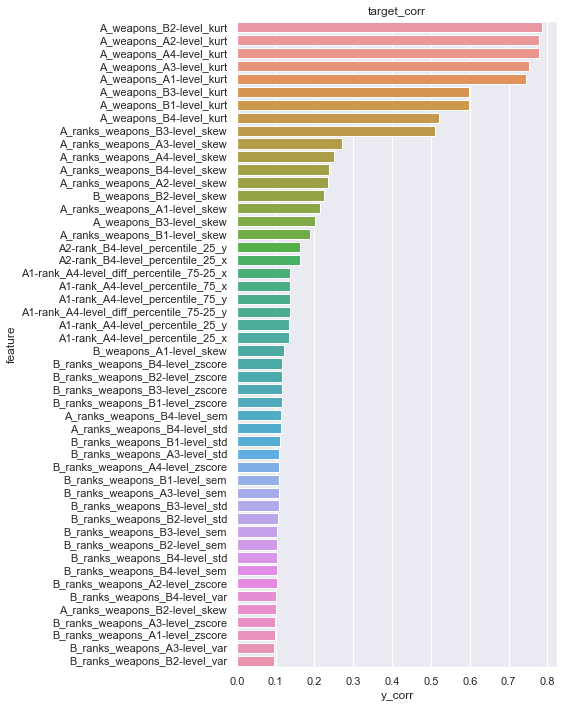

In [14]:
# ファイル出力
df_all.to_csv(f"{OUT_DATA}/feature_add.csv", index=False)
# display(df_all)

# 目的変数と数値列について相関係数確認
target_corr(df_all, target_col="y")

# 特徴量選択

In [15]:
df_all = pd.read_csv(f"{OUT_DATA}/feature_add.csv")

# label_encoding
cate_cols = df_all.select_dtypes(
    include=["object", "category", "bool"]
).columns.to_list()
for col in cate_cols:
    df_all[col], uni = pd.factorize(df_all[col])

# ファイル出力
# df_all.to_csv(f"{OUT_DATA}/label_encoding.csv", index=False)
# display(df_all)
print(df_all.shape)

,A1-level,A1-rank,A1-weapon,A2-level,A2-rank,A2-weapon,A3-level,A3-rank,A3-weapon,A4-level,A4-rank,A4-weapon,B1-level,B1-rank,B1-weapon,B2-level,B2-rank,B2-weapon,B3-level,B3-rank,B3-weapon,B4-level,B4-rank,B4-weapon,lobby-mode,mode,stage,y,dayofweek,weekend,hour,A2-level_log1p,A3-level_log1p,A4-level_log1p,B1-level_log1p,B2-level_log1p,B3-level_log1p,B4-level_log1p,A1-rank_A1-weapon,B1-rank_B1-weapon,A2-rank_A2-weapon,B2-rank_B2-weapon,A3-rank_A3-weapon,B3-rank_B3-weapon,A4-rank_A4-weapon,B4-rank_B4-weapon,A_ranks,A_weapons,A_ranks_weapons,B_ranks,B_weapons,B_ranks_weapons,A1-rank_A1-level_max_x,A1-rank_A1-level_min_x,A1-rank_A1-level_sum_x,A1-rank_A1-level_mean_x,A1-rank_A1-level_median_x,A1-rank_A1-level_prod_x,A1-rank_A1-level_var_x,A1-rank_A1-level_std_x,A1-rank_A1-level_sem_x,A1-rank_A1-level_mad_x,A1-rank_A1-level_skew_x,A1-rank_A1-level_kurt_x,A1-rank_A1-level_ptp_x,A1-rank_A1-level_percentile_25_x,A1-rank_A1-level_percentile_75_x,A1-rank_A1-level_diff_percentile_75-25_x,A1-rank_A1-level_mean_var_x,A1-rank_A1-level_diff_mean_x,A1-rank_A1-level_ratio_mean_x,A1-rank_A1-level_ratio_range_x,A1-rank_A1-level_hl_ratio_x,A1-rank_A1-level_beyond1std_x,A1-rank_A1-level_zscore_x,A1-rank_A2-level_max_x,A1-rank_A2-level_min_x,A1-rank_A2-level_sum_x,A1-rank_A2-level_mean_x,A1-rank_A2-level_median_x,A1-rank_A2-level_prod_x,A1-rank_A2-level_var_x,A1-rank_A2-level_std_x,A1-rank_A2-level_sem_x,A1-rank_A2-level_mad_x,A1-rank_A2-level_skew_x,A1-rank_A2-level_kurt_x,A1-rank_A2-level_ptp_x,A1-rank_A2-level_percentile_25_x,A1-rank_A2-level_percentile_75_x,A1-rank_A2-level_diff_percentile_75-25_x,A1-rank_A2-level_mean_var_x,A1-rank_A2-level_diff_mean_x,A1-rank_A2-level_ratio_mean_x,A1-rank_A2-level_ratio_range_x,A1-rank_A2-level_hl_ratio_x,A1-rank_A2-level_beyond1std_x,A1-rank_A2-level_zscore_x,A1-rank_A3-level_max_x,A1-rank_A3-level_min_x,A1-rank_A3-level_sum_x,A1-rank_A3-level_mean_x,A1-rank_A3-level_median_x,A1-rank_A3-level_prod_x,A1-rank_A3-level_var_x,A1-rank_A3-level_std_x,A1-rank_A3-level_sem_x,A1-rank_A3-level_mad_x,A1-rank_A3-level_skew_x,A1-rank_A3-level_kurt_x,A1-rank_A3-level_ptp_x,A1-rank_A3-level_percentile_25_x,A1-rank_A3-level_percentile_75_x,A1-rank_A3-level_diff_percentile_75-25_x,A1-rank_A3-level_mean_var_x,A1-rank_A3-level_diff_mean_x,A1-rank_A3-level_ratio_mean_x,A1-rank_A3-level_ratio_range_x,A1-rank_A3-level_hl_ratio_x,A1-rank_A3-level_beyond1std_x,A1-rank_A3-level_zscore_x,A1-rank_A4-level_max_x,A1-rank_A4-level_min_x,A1-rank_A4-level_sum_x,A1-rank_A4-level_mean_x,A1-rank_A4-level_median_x,A1-rank_A4-level_prod_x,A1-rank_A4-level_var_x,A1-rank_A4-level_std_x,A1-rank_A4-level_sem_x,A1-rank_A4-level_mad_x,A1-rank_A4-level_skew_x,A1-rank_A4-level_kurt_x,A1-rank_A4-level_ptp_x,A1-rank_A4-level_percentile_25_x,A1-rank_A4-level_percentile_75_x,A1-rank_A4-level_diff_percentile_75-25_x,A1-rank_A4-level_mean_var_x,A1-rank_A4-level_diff_mean_x,A1-rank_A4-level_ratio_mean_x,A1-rank_A4-level_ratio_range_x,A1-rank_A4-level_hl_ratio_x,A1-rank_A4-level_beyond1std_x,A1-rank_A4-level_zscore_x,A1-rank_B1-level_max_x,A1-rank_B1-level_min_x,A1-rank_B1-level_sum_x,A1-rank_B1-level_mean_x,A1-rank_B1-level_median_x,A1-rank_B1-level_prod_x,A1-rank_B1-level_var_x,A1-rank_B1-level_std_x,A1-rank_B1-level_sem_x,A1-rank_B1-level_mad_x,A1-rank_B1-level_skew_x,A1-rank_B1-level_kurt_x,A1-rank_B1-level_ptp_x,A1-rank_B1-level_percentile_25_x,A1-rank_B1-level_percentile_75_x,A1-rank_B1-level_diff_percentile_75-25_x,A1-rank_B1-level_mean_var_x,A1-rank_B1-level_diff_mean_x,A1-rank_B1-level_ratio_mean_x,A1-rank_B1-level_ratio_range_x,A1-rank_B1-level_hl_ratio_x,A1-rank_B1-level_beyond1std_x,A1-rank_B1-level_zscore_x,A1-rank_B2-level_max_x,A1-rank_B2-level_min_x,A1-rank_B2-level_sum_x,A1-rank_B2-level_mean_x,A1-rank_B2-level_median_x,A1-rank_B2-level_prod_x,A1-rank_B2-level_var_x,A1-rank_B2-level_std_x,A1-rank_B2-level_sem_x,A1-rank_B2-level_mad_x,A1-rank_B2-level_skew_x,A1-rank_B2-level_kurt_x,A1-rank_B2-level_ptp_x,A1-rank_B2-level_percentile_25_x,A1-ra

In [16]:
def remove_useless_features(df, cols=None, threshold=0.8):
    """
    xfeatで不要な特徴量削除
    - 列の内容が重複している列削除
    - すべて同じ値の列削除
    - スピマンの相関係数が高い列（多重共変性ある列）削除.相関係数がthresholdより高い列が消される
    https://github.com/pfnet-research/xfeat/blob/master/examples/remove_useless_features.py
    """
    # データ型を変換してメモリ使用量を削減
    cols = df.columns.tolist() if cols is None else cols
    df = compress_df(pd.DataFrame(data=df, columns=cols))

    encoder = Pipeline(
        [
            DuplicatedFeatureEliminator(),
            ConstantFeatureEliminator(),
            # SpearmanCorrelationEliminator(threshold=threshold),  # 相関係数>thresholdの特長削除
        ]
    )
    df_reduced = encoder.fit_transform(df)
    # print("Selected columns: {}".format(df_reduced.columns.tolist()))
    return df_reduced


y_seri = df_all["y"]
df_all = df_all.drop("y", axis=1)
df_all = remove_useless_features(df_all)
df_all = pd.concat([df_all, y_seri], axis=1)
# display(df_all)
df_all.to_csv(f"{OUT_DATA}/remove_useless_features.csv")

C:\Users\81908\Git\xfeat\xfeat\utils.py:91: RuntimeWarning: invalid value encountered in less_equal
  min_val >= np.finfo(np.float32).min


,A1-level,A1-rank,A1-weapon,A2-level,A2-rank,A2-weapon,A3-level,A3-rank,A3-weapon,A4-level,A4-rank,A4-weapon,B1-level,B1-rank,B1-weapon,B2-level,B2-rank,B2-weapon,B3-level,B3-rank,B3-weapon,B4-level,B4-rank,B4-weapon,lobby-mode,mode,stage,dayofweek,weekend,hour,A2-level_log1p,A3-level_log1p,A4-level_log1p,B1-level_log1p,B2-level_log1p,B3-level_log1p,B4-level_log1p,A1-rank_A1-weapon,B1-rank_B1-weapon,A2-rank_A2-weapon,B2-rank_B2-weapon,A3-rank_A3-weapon,B3-rank_B3-weapon,A4-rank_A4-weapon,B4-rank_B4-weapon,A_ranks,A_weapons,A_ranks_weapons,B_ranks,B_weapons,B_ranks_weapons,A1-rank_A1-level_max_x,A1-rank_A1-level_min_x,A1-rank_A1-level_sum_x,A1-rank_A1-level_mean_x,A1-rank_A1-level_median_x,A1-rank_A1-level_prod_x,A1-rank_A1-level_var_x,A1-rank_A1-level_std_x,A1-rank_A1-level_sem_x,A1-rank_A1-level_mad_x,A1-rank_A1-level_skew_x,A1-rank_A1-level_kurt_x,A1-rank_A1-level_ptp_x,A1-rank_A1-level_percentile_25_x,A1-rank_A1-level_percentile_75_x,A1-rank_A1-level_diff_percentile_75-25_x,A1-rank_A1-level_mean_var_x,A1-rank_A1-level_diff_mean_x,A1-rank_A1-level_ratio_mean_x,A1-rank_A1-level_ratio_range_x,A1-rank_A1-level_hl_ratio_x,A1-rank_A1-level_beyond1std_x,A1-rank_A1-level_zscore_x,A1-rank_A2-level_max_x,A1-rank_A2-level_min_x,A1-rank_A2-level_sum_x,A1-rank_A2-level_mean_x,A1-rank_A2-level_median_x,A1-rank_A2-level_prod_x,A1-rank_A2-level_var_x,A1-rank_A2-level_std_x,A1-rank_A2-level_sem_x,A1-rank_A2-level_mad_x,A1-rank_A2-level_skew_x,A1-rank_A2-level_kurt_x,A1-rank_A2-level_ptp_x,A1-rank_A2-level_percentile_25_x,A1-rank_A2-level_percentile_75_x,A1-rank_A2-level_diff_percentile_75-25_x,A1-rank_A2-level_mean_var_x,A1-rank_A2-level_diff_mean_x,A1-rank_A2-level_ratio_mean_x,A1-rank_A2-level_ratio_range_x,A1-rank_A2-level_hl_ratio_x,A1-rank_A2-level_beyond1std_x,A1-rank_A2-level_zscore_x,A1-rank_A3-level_max_x,A1-rank_A3-level_min_x,A1-rank_A3-level_sum_x,A1-rank_A3-level_mean_x,A1-rank_A3-level_median_x,A1-rank_A3-level_prod_x,A1-rank_A3-level_var_x,A1-rank_A3-level_std_x,A1-rank_A3-level_sem_x,A1-rank_A3-level_mad_x,A1-rank_A3-level_skew_x,A1-rank_A3-level_kurt_x,A1-rank_A3-level_ptp_x,A1-rank_A3-level_percentile_25_x,A1-rank_A3-level_percentile_75_x,A1-rank_A3-level_diff_percentile_75-25_x,A1-rank_A3-level_mean_var_x,A1-rank_A3-level_diff_mean_x,A1-rank_A3-level_ratio_mean_x,A1-rank_A3-level_ratio_range_x,A1-rank_A3-level_hl_ratio_x,A1-rank_A3-level_beyond1std_x,A1-rank_A3-level_zscore_x,A1-rank_A4-level_max_x,A1-rank_A4-level_min_x,A1-rank_A4-level_sum_x,A1-rank_A4-level_mean_x,A1-rank_A4-level_median_x,A1-rank_A4-level_prod_x,A1-rank_A4-level_var_x,A1-rank_A4-level_std_x,A1-rank_A4-level_sem_x,A1-rank_A4-level_mad_x,A1-rank_A4-level_skew_x,A1-rank_A4-level_kurt_x,A1-rank_A4-level_ptp_x,A1-rank_A4-level_percentile_25_x,A1-rank_A4-level_percentile_75_x,A1-rank_A4-level_diff_percentile_75-25_x,A1-rank_A4-level_mean_var_x,A1-rank_A4-level_diff_mean_x,A1-rank_A4-level_ratio_mean_x,A1-rank_A4-level_ratio_range_x,A1-rank_A4-level_hl_ratio_x,A1-rank_A4-level_beyond1std_x,A1-rank_A4-level_zscore_x,A1-rank_B1-level_max_x,A1-rank_B1-level_min_x,A1-rank_B1-level_sum_x,A1-rank_B1-level_mean_x,A1-rank_B1-level_median_x,A1-rank_B1-level_prod_x,A1-rank_B1-level_var_x,A1-rank_B1-level_std_x,A1-rank_B1-level_sem_x,A1-rank_B1-level_mad_x,A1-rank_B1-level_skew_x,A1-rank_B1-level_kurt_x,A1-rank_B1-level_ptp_x,A1-rank_B1-level_percentile_25_x,A1-rank_B1-level_percentile_75_x,A1-rank_B1-level_diff_percentile_75-25_x,A1-rank_B1-level_mean_var_x,A1-rank_B1-level_diff_mean_x,A1-rank_B1-level_ratio_mean_x,A1-rank_B1-level_ratio_range_x,A1-rank_B1-level_hl_ratio_x,A1-rank_B1-level_beyond1std_x,A1-rank_B1-level_zscore_x,A1-rank_B2-level_max_x,A1-rank_B2-level_min_x,A1-rank_B2-level_sum_x,A1-rank_B2-level_mean_x,A1-rank_B2-level_median_x,A1-rank_B2-level_prod_x,A1-rank_B2-level_var_x,A1-rank_B2-level_std_x,A1-rank_B2-level_sem_x,A1-rank_B2-level_mad_x,A1-rank_B2-level_skew_x,A1-rank_B2-level_kurt_x,A1-rank_B2-level_ptp_x,A1-rank_B2-level_percentile_25_x,A1-rank

In [17]:
def run_feature_selection(
    df, target_col, params,
):
    """feature_importanceの閾値固定して特徴量選択"""
    # 特徴量の列名（取捨選択前）
    input_cols = df.columns.tolist()
    n_before_selection = len(input_cols)
    input_cols.remove(target_col)

    # 特徴量選択用モデル取得
    lgbm_params = {
        "objective": params["objective"],
        "metric": params["metric"],
        "verbosity": -1,
    }
    selector = GBDTFeatureSelector(
        input_cols=input_cols,
        target_col=target_col,
        threshold=params["threshold"],
        lgbm_params=lgbm_params,
    )
    selector.fit(df)

    # 選択をした特徴量を返す
    selected_cols = selector.get_selected_cols()
    print(f" - {n_before_selection - len(selected_cols)} features are removed.")
    return df[selected_cols]


target_col = "y"
# metric=roc_aucでも可能
# feature_importance高い順に列数を 列数*threshold にする
n_cols = 600
threshold = n_cols / df_all.shape[1]
params = {"metric": "binary_logloss", "objective": "binary", "threshold": threshold}
df_all = run_feature_selection(df_all, target_col, params)
print(df_all.shape)
print(df_all.columns)

# 列名保持
feature_selections = sorted(df_all.columns.to_list())
pd.DataFrame({"feature_selections": feature_selections}).to_csv(
    f"{OUT_DATA}/feature_selections.csv", index=False
)

# ファイル出力
df_all.to_csv(f"{OUT_DATA}/run_feature_selection.csv", index=False)

 - 5451 features are removed.
(94465, 599)
Index(['B_weapons', 'A_weapons', 'B1-levelB2-levelB3-levelB4-level_plus',
       'B1-levelB2-levelB3-levelB4-level_mul',
       'A1-levelA2-levelA3-levelA4-level_plus', 'A_ranks_weapons',
       'A1-levelA2-levelA3-levelA4-level_mul', 'A4-weapon_B2-level_min_x',
       'A1-rank_A1-weapon_A4-level_hl_ratio_x', 'A_weapons_A1-level_prod',
       ...
       'B1-rank_B1-weapon_B4-level_kurt_x', 'A4-weapon_B2-level_kurt_x',
       'B3-rank_B3-weapon_B4-level_mean', 'B3-rank_B3-weapon_B4-level_median',
       'B3-weapon_B1-level_max_x', 'B3-weapon_A4-level_zscore_x',
       'B3-weapon_A4-level_beyond1std_x', 'A1-rank_A1-weapon_A3-level_mean_x',
       'B3-rank_B3-weapon_B4-level_hl_ratio', 'A3-weapon_A4-level_hl_ratio_x'],
      dtype='object', length=599)


(94465, 600)


C:\Users\81908\Anaconda3\envs\tfgpu\lib\site-packages\ipykernel_launcher.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



select_cols:
 ['A1-levelA2-levelA3-levelA4-level_mul', 'A1-rank_A1-weapon_A1-level_diff_mean_x', 'A1-rank_A1-weapon_A1-level_mean_var_x', 'A1-rank_A1-weapon_A1-level_ratio_range_x', 'A1-rank_A1-weapon_A2-level_beyond1std_x', 'A1-rank_A1-weapon_A2-level_kurt_x', 'A1-rank_A1-weapon_A2-level_sem_x', 'A1-rank_A1-weapon_A2-level_skew_x', 'A1-rank_A1-weapon_A2-level_var_x', 'A1-rank_A1-weapon_A3-level_sem_x', 'A1-rank_A1-weapon_A4-level_hl_ratio_x', 'A1-rank_A1-weapon_A4-level_percentile_75_x', 'A1-rank_A1-weapon_B1-level_hl_ratio_x', 'A1-rank_A1-weapon_B1-level_var_x', 'A1-rank_A1-weapon_B3-level_kurt_x', 'A1-rank_A1-weapon_B3-level_var_x', 'A1-rank_A1-weapon_B4-level_kurt_x', 'A1-rank_A1-weapon_B4-level_zscore_x', 'A1-weapon_A2-level_zscore_x', 'A1-weapon_B1-level_beyond1std_x', 'A1-weapon_B4-level_max_x', 'A2-rank_A2-weapon_A1-level_mad', 'A2-rank_A2-weapon_A2-level_mean', 'A2-rank_A2-weapon_A4-level_kurt', 'A2-rank_A2-weapon_A4-level_skew', 'A2-rank_A2-weapon_B2-level_max', 'A2-rank_A2-

 ['A1-levelA2-levelA3-levelA4-level_minus', 'A1-levelA2-levelA3-levelA4-level_plus', 'A1-rank_A1-weapon_A1-level_diff_percentile_75-25_x', 'A1-rank_A1-weapon_A1-level_hl_ratio_x', 'A1-rank_A1-weapon_A1-level_kurt_x', 'A1-rank_A1-weapon_A1-level_percentile_25_x', 'A1-rank_A1-weapon_A1-level_sem_x', 'A1-rank_A1-weapon_A1-level_skew_x', 'A1-rank_A1-weapon_A1-level_sum_x', 'A1-rank_A1-weapon_A2-level_ptp_x', 'A1-rank_A1-weapon_A2-level_zscore_x', 'A1-rank_A1-weapon_A3-level_beyond1std_x', 'A1-rank_A1-weapon_A3-level_diff_mean_x', 'A1-rank_A1-weapon_A3-level_mean_var_x', 'A1-rank_A1-weapon_A3-level_mean_x', 'A1-rank_A1-weapon_A4-level_beyond1std_x', 'A1-rank_A1-weapon_A4-level_diff_percentile_75-25_x', 'A1-rank_A1-weapon_B1-level_mad_x', 'A1-rank_A1-weapon_B1-level_mean_var_x', 'A1-rank_A1-weapon_B1-level_ratio_range_x', 'A1-rank_A1-weapon_B1-level_sem_x', 'A1-rank_A1-weapon_B2-level_diff_mean_x', 'A1-rank_A1-weapon_B2-level_kurt_x', 'A1-rank_A1-weapon_B2-level_mad_x', 'A1-rank_A1-weapon_B2

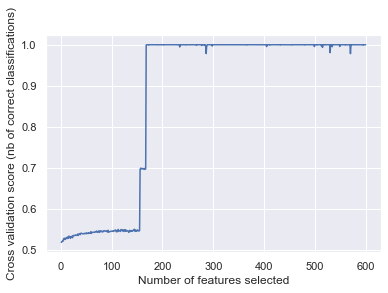

In [19]:
def plot_rfecv(selector):
    import seaborn as sns
    import matplotlib.pyplot as plt

    sns.set()

    plt.xlabel("Number of features selected")
    plt.ylabel("Cross validation score (nb of correct classifications)")
    plt.plot(range(1, len(selector.grid_scores_) + 1), selector.grid_scores_)
    plt.show()
    plt.clf()
    plt.close()


df_all = pd.read_csv(f"{OUT_DATA}/feature_add.csv")
cols = pd.read_csv(f"{OUT_DATA}/feature_selections.csv")["feature_selections"].values.tolist()
target_col = "y"
cols.append(target_col)
df_all = df_all[cols]   
print(df_all.shape)
    
X_train = df_all.loc[df_all["y"].notnull()]
cate_cols = X_train.select_dtypes(
    include=["object", "category", "bool"]
).columns.to_list()
for col in cate_cols:
    X_train[col], uni = pd.factorize(X_train[col])
y_train = X_train["y"]

best_params = {'bagging_fraction': 0.9, 'bagging_freq': 6, 'feature_fraction': 0.1, 'max_depth': 7, 'min_child_samples': 343, 'min_child_weight': 0.04084861948055769, 'num_leaves': 95, 'reg_alpha': 0.5612212694825488, 'reg_lambda': 0.0001757886119766502}
clf = lgb.LGBMClassifier(n_jobs=-1, seed=71, **best_params)  # 欠損ある場合はGBM使う（リッジより遅い）

# RFECVは交差検証+再帰的特徴除去。データでかいとメモリ死ぬので注意
# RFE（再帰的特徴除去=recursive feature elimination: すべての特徴量を使う状態から、1つずつ特徴量を取り除いていく）で特徴量選択
selector = RFECV(clf, cv=KFold(3, shuffle=True), scoring="accuracy", n_jobs=-1)
selector.fit(X_train, y_train)

# 選択した特徴量
select_cols = X_train.columns[selector.get_support()].to_list()
print("\nselect_cols:\n", select_cols)
# 捨てた特徴量
print("not select_cols:\n", X_train.columns[~selector.get_support()].to_list())
plot_rfecv(selector)
df_all.to_csv(f"{OUT_DATA}/rfecv.csv")

# モデル作成

In [14]:
def count_encoder(train_df, valid_df, cat_features=None):
    """
    Count_Encoding: カテゴリ列をカウント値に変換する特徴量エンジニアリング（要はgroupby().size()の集計列追加のこと）
    ※カウント数が同じカテゴリは同じようなデータ傾向になる可能性がある
    https://www.kaggle.com/matleonard/categorical-encodings
    """
    # conda install -c conda-forge category_encoders
    import category_encoders as ce

    if cat_features is None:
        cat_features = train_df.select_dtypes(
            include=["object", "category", "bool"]
        ).columns.to_list()

    count_enc = ce.CountEncoder(cols=cat_features)

    # trainだけでfitすること(validationやtest含めるとリークする)
    count_enc.fit(train_df[cat_features])
    train_encoded = train_df.join(
        count_enc.transform(train_df[cat_features]).add_suffix("_count")
    )
    valid_encoded = valid_df.join(
        count_enc.transform(valid_df[cat_features]).add_suffix("_count")
    )

    return train_encoded, valid_encoded


def target_encoder(train_df, valid_df, target_col: str, cat_features=None):
    """
    Target_Encoding: カテゴリ列を目的変数の平均値に変換する特徴量エンジニアリング
    https://www.kaggle.com/matleonard/categorical-encodings
    """
    # conda install -c conda-forge category_encoders
    import category_encoders as ce

    if cat_features is None:
        cat_features = train_df.select_dtypes(
            include=["object", "category", "bool"]
        ).columns.to_list()

    target_enc = ce.TargetEncoder(cols=cat_features)

    # trainだけでfitすること(validationやtest含めるとリークする)
    target_enc.fit(train_df[cat_features], train_df[target_col])

    train_encoded = train_df.join(
        target_enc.transform(train_df[cat_features]).add_suffix("_target")
    )
    valid_encoded = valid_df.join(
        target_enc.transform(valid_df[cat_features]).add_suffix("_target")
    )
    return train_encoded, valid_encoded


def catboost_encoder(train_df, valid_df, target_col: str, cat_features=None):
    """
    CatBoost_Encoding: カテゴリ列を目的変数の1行前の行からのみに変換する特徴量エンジニアリング
    CatBoost使ったターゲットエンコーディング
    https://www.kaggle.com/matleonard/categorical-encodings
    """
    # conda install -c conda-forge category_encoders
    import category_encoders as ce

    if cat_features is None:
        cat_features = train_df.select_dtypes(
            include=["object", "category", "bool"]
        ).columns.to_list()

    cb_enc = ce.CatBoostEncoder(cols=cat_features, random_state=7)

    # trainだけでfitすること(validationやtest含めるとリークする)
    cb_enc.fit(train_df[cat_features], train_df[target_col])

    train_encoded = train_df.join(
        cb_enc.transform(train_df[cat_features]).add_suffix("_cb")
    )
    valid_encoded = valid_df.join(
        cb_enc.transform(valid_df[cat_features]).add_suffix("_cb")
    )
    return train_encoded, valid_encoded

Starting LightGBM. Train shape: (66125, 169), test shape: (28340, 169)


0it [00:00, ?it/s]

run encoding Train shape: (49593, 178), valid shape: (16532, 178)
Training until validation scores don't improve for 200 rounds
[200]	training's binary_error: 0.376969	training's binary_logloss: 0.667178	valid_1's binary_error: 0.464009	valid_1's binary_logloss: 0.688012
[400]	training's binary_error: 0.349807	training's binary_logloss: 0.652284	valid_1's binary_error: 0.460077	valid_1's binary_logloss: 0.688016
Early stopping, best iteration is:
[284]	training's binary_error: 0.362329	training's binary_logloss: 0.660432	valid_1's binary_error: 0.46286	valid_1's binary_logloss: 0.687725
Fold  1 error : 0.462860


1it [00:06,  6.62s/it]

run encoding Train shape: (49594, 178), valid shape: (16531, 178)
Training until validation scores don't improve for 200 rounds
[200]	training's binary_error: 0.381054	training's binary_logloss: 0.667304	valid_1's binary_error: 0.46555	valid_1's binary_logloss: 0.687753
[400]	training's binary_error: 0.35218	training's binary_logloss: 0.652353	valid_1's binary_error: 0.457686	valid_1's binary_logloss: 0.687447
Early stopping, best iteration is:
[284]	training's binary_error: 0.366919	training's binary_logloss: 0.660678	valid_1's binary_error: 0.46071	valid_1's binary_logloss: 0.687336
Fold  2 error : 0.460710


2it [00:13,  6.55s/it]

run encoding Train shape: (49594, 178), valid shape: (16531, 178)
Training until validation scores don't improve for 200 rounds
[200]	training's binary_error: 0.37811	training's binary_logloss: 0.667728	valid_1's binary_error: 0.456536	valid_1's binary_logloss: 0.687347
[400]	training's binary_error: 0.349901	training's binary_logloss: 0.653488	valid_1's binary_error: 0.453633	valid_1's binary_logloss: 0.686631
[600]	training's binary_error: 0.336654	training's binary_logloss: 0.642749	valid_1's binary_error: 0.452181	valid_1's binary_logloss: 0.686979
Early stopping, best iteration is:
[427]	training's binary_error: 0.348409	training's binary_logloss: 0.651866	valid_1's binary_error: 0.453996	valid_1's binary_logloss: 0.686573
Fold  3 error : 0.453996


3it [00:20,  6.70s/it]

run encoding Train shape: (49594, 178), valid shape: (16531, 178)
Training until validation scores don't improve for 200 rounds
[200]	training's binary_error: 0.382244	training's binary_logloss: 0.667896	valid_1's binary_error: 0.464642	valid_1's binary_logloss: 0.688025
[400]	training's binary_error: 0.355547	training's binary_logloss: 0.653384	valid_1's binary_error: 0.458956	valid_1's binary_logloss: 0.687814
Early stopping, best iteration is:
[284]	training's binary_error: 0.369077	training's binary_logloss: 0.661312	valid_1's binary_error: 0.459984	valid_1's binary_logloss: 0.687681
Fold  4 error : 0.459984


4it [00:26,  6.60s/it]


Full error score 0.459388


C:\Users\81908\Anaconda3\envs\tfgpu\lib\site-packages\ipykernel_launcher.py:224: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


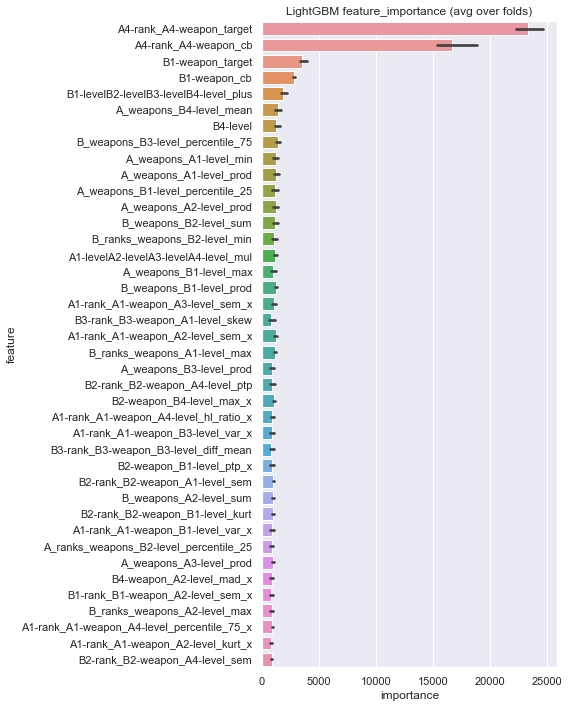

In [21]:
class Model:
    def __init__(self, OUTPUT_DIR):
        self.OUTPUT_DIR = OUTPUT_DIR

    # LightGBM GBDT with KFold or Stratified KFold
    # Parameters from Tilii kernel: https://www.kaggle.com/tilii7/olivier-lightgbm-parameters-by-bayesian-opt/code
    def kfold_cv_LGBMClassifier(
        self,
        lgb_params: dict,
        df: pd.DataFrame,
        num_folds: int,
        target_col: str,
        del_cols=None,
        eval_metric="error",
        stratified=True,  # StratifiedKFoldにするか
        is_submission=False,  # Home_Credit_Default_Risk の submission.csv作成するか
        is_plot_perm_importance=False,  # permutation importanceも出すか. feature_importance はデフォルトでだす
    ):
        """
        LGBMClassifierでcross validation + feature_importance/permutation importance plot
        """
        # Divide in training/validation and test data
        train_df = df[df[target_col].notnull()].reset_index(drop=True)
        test_df = df[df[target_col].isnull()].reset_index(drop=True)
        print(
            "Starting LightGBM. Train shape: {}, test shape: {}".format(
                train_df.shape, test_df.shape
            )
        )
        del df
        gc.collect()

        # Cross validation model
        if stratified:
            folds = StratifiedKFold(n_splits=num_folds, shuffle=True, random_state=1001)
        else:
            folds = KFold(n_splits=num_folds, shuffle=True, random_state=1001)

        # Create arrays and dataframes to store results
        oof_preds = np.zeros(train_df.shape[0])
        sub_preds = np.zeros(test_df.shape[0])
        feature_importance_df = pd.DataFrame()
        permutation_importance_df = pd.DataFrame()
        result_scores = {}
        train_probas = {}
        test_probas = {}

        # 目的変数とID列など削除
        del_cols = del_cols.append(target_col) if del_cols is not None else [target_col]
        feats = [f for f in train_df.columns if f not in del_cols]

        for n_fold, (train_idx, valid_idx) in tqdm(
            enumerate(folds.split(train_df[feats], train_df[target_col]))
        ):
            t_fold_df = train_df.iloc[train_idx]
            v_fold_df = train_df.iloc[valid_idx]

            # カウントエンコディング
            t_fold_df, v_fold_df = count_encoder(
                t_fold_df, v_fold_df, cat_features=None
            )
            # ターゲットエンコディング
            t_fold_df, v_fold_df = target_encoder(
                t_fold_df, v_fold_df, target_col=target_col, cat_features=None
            )
            # CatBoostエンコディング
            t_fold_df, v_fold_df = catboost_encoder(
                t_fold_df, v_fold_df, target_col=target_col, cat_features=None
            )
            # ラベルエンコディング
            cate_cols = t_fold_df.select_dtypes(
                include=["object", "category", "bool"]
            ).columns.to_list()
            for col in cate_cols:
                t_fold_df[col], uni = pd.factorize(t_fold_df[col])
                v_fold_df[col], uni = pd.factorize(v_fold_df[col])
            print(
                "run encoding Train shape: {}, valid shape: {}".format(
                    t_fold_df.shape, v_fold_df.shape
                )
            )

            feats = t_fold_df.columns.to_list()
            feats.remove(target_col)

            train_x, train_y = (
                t_fold_df[feats],
                t_fold_df[target_col],
            )
            valid_x, valid_y = (
                v_fold_df[feats],
                v_fold_df[target_col],
            )

            ############################ train fit ############################
            # LightGBM parameters found by Bayesian optimization
            clf = LGBMClassifier(**lgb_params)
            clf.fit(
                train_x,
                train_y,
                eval_set=[(train_x, train_y), (valid_x, valid_y)],
                eval_metric=eval_metric,
                verbose=200,
                early_stopping_rounds=200,
            )

            # モデル保存
            joblib.dump(clf, f"{self.OUTPUT_DIR}/lgb-{n_fold + 1}.model", compress=True)

            # valid pred
            oof_preds[valid_idx] = clf.predict_proba(
                valid_x, num_iteration=clf.best_iteration_
            )[:, 1]

            ############################ test pred ############################
            # カウントエンコディング
            tr_df, te_df = count_encoder(train_df, test_df, cat_features=None)
            # ターゲットエンコディング
            tr_df, te_df = target_encoder(
                tr_df, te_df, target_col=target_col, cat_features=None
            )
            # CatBoostエンコディング
            tr_df, te_df = catboost_encoder(
                tr_df, te_df, target_col=target_col, cat_features=None
            )
            # ラベルエンコディング
            cate_cols = tr_df.select_dtypes(
                include=["object", "category", "bool"]
            ).columns.to_list()
            for col in cate_cols:
                tr_df[col], uni = pd.factorize(tr_df[col])
                te_df[col], uni = pd.factorize(te_df[col])
                
            # testの確信度
            test_probas[f"fold_{str(n_fold + 1)}"] = clf.predict_proba(
                te_df[feats], num_iteration=clf.best_iteration_
            )[:, 1]
            sub_preds += test_probas[f"fold_{str(n_fold + 1)}"] / folds.n_splits

            # 一応trainの確信度も出しておく
            train_probas[f"fold_{str(n_fold + 1)}"] = clf.predict_proba(
                tr_df[feats], num_iteration=clf.best_iteration_
            )[:, 1]

            if eval_metric == "auc":
                fold_auc = roc_auc_score(valid_y, oof_preds[valid_idx])
                print("Fold %2d AUC : %.6f" % (n_fold + 1, fold_auc))
                result_scores[f"fold_auc_{str(n_fold + 1)}"] = fold_auc
            elif eval_metric == "error":
                # intにしないとaccuracy_score()エラーになる
                _pred = oof_preds[valid_idx]
                _pred[_pred >= 0.5] = 1
                _pred[_pred < 0.5] = 0
                fold_err = 1.0 - accuracy_score(valid_y, _pred)
                print("Fold %2d error : %.6f" % (n_fold + 1, fold_err))
                result_scores[f"fold_err_{str(n_fold + 1)}"] = fold_err

            # feature_importance
            fold_importance_df = pd.DataFrame()
            fold_importance_df["feature"] = feats
            fold_importance_df["importance"] = clf.feature_importances_
            fold_importance_df["fold"] = n_fold + 1
            feature_importance_df = pd.concat(
                [feature_importance_df, fold_importance_df], axis=0
            )

            if is_plot_perm_importance:
                # permutation_importance
                # 時間かかるからifで制御する
                # scoringはsklearnのスコアリングパラメータ
                # accuracy や neg_mean_squared_log_error とか
                # https://scikit-learn.org/stable/modules/model_evaluation.html#scoring-parameter
                fold_importance_df = pd.DataFrame()
                fold_permutation = permutation_importance(
                    clf, valid_x, valid_y, scoring="roc_auc"
                )
                fold_permutation_df = pd.DataFrame(
                    {
                        "feature": valid_x.columns,
                        "importance": np.abs(
                            fold_permutation["importances_mean"]
                        ),  # マイナスとるのもあるので絶対値にする
                        "fold": n_fold + 1,
                    },
                )
                permutation_importance_df = pd.concat(
                    [permutation_importance_df, fold_permutation_df], axis=0
                )

            del clf, train_x, train_y, valid_x, valid_y
            gc.collect()

        if eval_metric == "auc":
            mean_fold_auc = roc_auc_score(train_df[target_col], oof_preds)
            print("Full AUC score %.6f" % mean_fold_auc)
            result_scores["mean_fold_auc"] = mean_fold_auc
        elif eval_metric == "error":
            # intにしないとaccuracy_score()エラーになる
            _pred = oof_preds
            _pred[_pred >= 0.5] = 1
            _pred[_pred < 0.5] = 0
            mean_fold_err = 1.0 - accuracy_score(train_df[target_col], _pred)
            print("Full error score %.6f" % mean_fold_err)
            result_scores["mean_fold_err"] = mean_fold_err

        # モデルのスコア出力
        result_scores_df = pd.DataFrame(
            result_scores.values(), index=result_scores.keys()
        )
        result_scores_df.to_csv(f"{self.OUTPUT_DIR}/result_scores.tsv", sep="\t")

        test_probas_df = pd.DataFrame(test_probas)
        test_probas_df.to_csv(f"{self.OUTPUT_DIR}/test_probas.tsv", index=False)
        train_probas_df = pd.DataFrame(train_probas)
        train_probas_df.to_csv(f"{self.OUTPUT_DIR}/train_probas.tsv", index=False)

        # Write submission file (Home_Credit_Default_Risk)
        if is_submission:
            sub_preds[sub_preds >= 0.5] = 1
            sub_preds[sub_preds < 0.5] = 0
            test_df[target_col] = sub_preds
            submission_file_name = f"{self.OUTPUT_DIR}/submission_kernel.csv"
            sub_df = test_df[[target_col]]
            sub_df["id"] = test_df.index
            sub_df.astype(int)
            sub_df = sub_df[["id", "y"]]
            sub_df.to_csv(submission_file_name, index=False)

        # Plot feature importance
        Model("").display_importances(
            feature_importance_df,
            png_path=f"{self.OUTPUT_DIR}/lgbm_feature_importances.png",
            title="feature_importance",
        )
        if is_plot_perm_importance:
            Model("").display_importances(
                permutation_importance_df,
                png_path=f"{self.OUTPUT_DIR}/lgbm_permutation_importances.png",
                title="permutation_importance",
            )

        return feature_importance_df, permutation_importance_df

    # Display/plot feature/permutation importance
    @staticmethod
    def display_importances(
        importance_df_, png_path, title,
    ):
        cols = (
            importance_df_[["feature", "importance"]]
            .groupby("feature")
            .mean()
            .sort_values(by="importance", ascending=False)[:40]
            .index
        )
        best_features = importance_df_.loc[importance_df_.feature.isin(cols)]
        plt.figure(figsize=(8, 10))
        sns.barplot(
            x="importance",
            y="feature",
            data=best_features.sort_values(by="importance", ascending=False),
        )
        plt.title(f"LightGBM {title} (avg over folds)")
        plt.tight_layout()
        plt.savefig(png_path)


if __name__ == "__main__":
    df_all = pd.read_csv(f"{OUT_DATA}/feature_add.csv")
    #cols = pd.read_csv(f"{OUT_DATA}/feature_selections.csv")["feature_selections"].values.tolist()
    #cols.append("y")
    cols = ['A1-levelA2-levelA3-levelA4-level_mul', 'A1-rank_A1-weapon_A1-level_diff_mean_x', 'A1-rank_A1-weapon_A1-level_mean_var_x', 'A1-rank_A1-weapon_A1-level_ratio_range_x', 'A1-rank_A1-weapon_A2-level_beyond1std_x', 'A1-rank_A1-weapon_A2-level_kurt_x', 'A1-rank_A1-weapon_A2-level_sem_x', 'A1-rank_A1-weapon_A2-level_skew_x', 'A1-rank_A1-weapon_A2-level_var_x', 'A1-rank_A1-weapon_A3-level_sem_x', 'A1-rank_A1-weapon_A4-level_hl_ratio_x', 'A1-rank_A1-weapon_A4-level_percentile_75_x', 'A1-rank_A1-weapon_B1-level_hl_ratio_x', 'A1-rank_A1-weapon_B1-level_var_x', 'A1-rank_A1-weapon_B3-level_kurt_x', 'A1-rank_A1-weapon_B3-level_var_x', 'A1-rank_A1-weapon_B4-level_kurt_x', 'A1-rank_A1-weapon_B4-level_zscore_x', 'A1-weapon_A2-level_zscore_x', 'A1-weapon_B1-level_beyond1std_x', 'A1-weapon_B4-level_max_x', 'A2-rank_A2-weapon_A1-level_mad', 'A2-rank_A2-weapon_A2-level_mean', 'A2-rank_A2-weapon_A4-level_kurt', 'A2-rank_A2-weapon_A4-level_skew', 'A2-rank_A2-weapon_B2-level_max', 'A2-rank_A2-weapon_B2-level_skew', 'A2-rank_A2-weapon_B2-level_zscore', 'A2-rank_A2-weapon_B3-level_kurt', 'A2-rank_A2-weapon_B4-level_diff_mean', 'A2-rank_A2-weapon_B4-level_diff_percentile_75-25', 'A2-rank_A2-weapon_B4-level_percentile_25', 'A2-weapon_A3-level_ptp_x', 'A2-weapon_A4-level_diff_percentile_75-25_x', 'A2-weapon_B3-level_percentile_75_x', 'A3-rank_A3-weapon_A1-level_sem', 'A3-rank_A3-weapon_A2-level_hl_ratio', 'A3-rank_A3-weapon_A2-level_kurt', 'A3-rank_A3-weapon_A2-level_ratio_range', 'A3-rank_A3-weapon_A3-level_kurt', 'A3-rank_A3-weapon_A4-level_ratio_range', 'A3-rank_A3-weapon_B1-level_diff_mean', 'A3-rank_A3-weapon_B1-level_zscore', 'A3-rank_A3-weapon_B2-level_hl_ratio', 'A3-rank_A3-weapon_B2-level_mean', 'A3-rank_A3-weapon_B2-level_var', 'A3-rank_A3-weapon_B3-level_ratio_mean', 'A3-rank_A3-weapon_B4-level_kurt', 'A3-rank_A3-weapon_B4-level_percentile_25', 'A3-weapon_A1-level_kurt_x', 'A3-weapon_A2-level_skew_x', 'A3-weapon_A3-level_hl_ratio_x', 'A3-weapon_A3-level_max_x', 'A3-weapon_A4-level_percentile_75_x', 'A3-weapon_B3-level_max_x', 'A4-rank_A4-weapon', 'A4-rank_A4-weapon_A1-level_kurt', 'A4-rank_A4-weapon_A3-level_ratio_range', 'A4-rank_A4-weapon_A4-level_diff_mean', 'A4-rank_A4-weapon_A4-level_diff_percentile_75-25', 'A4-rank_A4-weapon_A4-level_ratio_range', 'A4-rank_A4-weapon_B2-level_ratio_range', 'A4-weapon_A1-level_diff_percentile_75-25_x', 'A4-weapon_A1-level_hl_ratio_x', 'A4-weapon_A4-level_mad_x', 'A4-weapon_A4-level_median_x', 'A4-weapon_A4-level_percentile_75_x', 'A4-weapon_A4-level_var_x', 'A4-weapon_B4-level_mad_x', 'A4-weapon_B4-level_mean_var_x', 'A_ranks_A2-level_kurt', 'A_ranks_weapons_B2-level_percentile_25', 'A_weapons_A1-level_min', 'A_weapons_A1-level_prod', 'A_weapons_A2-level_prod', 'A_weapons_A3-level_prod', 'A_weapons_A3-level_sum', 'A_weapons_B1-level_max', 'A_weapons_B1-level_percentile_25', 'A_weapons_B3-level_min', 'A_weapons_B3-level_percentile_75', 'A_weapons_B3-level_prod', 'A_weapons_B4-level_mean', 'B1-levelB2-levelB3-levelB4-level_plus', 'B1-rank_B1-weapon_A1-level_kurt_x', 'B1-rank_B1-weapon_A1-level_var_x', 'B1-rank_B1-weapon_A2-level_kurt_x', 'B1-rank_B1-weapon_A2-level_ptp_x', 'B1-rank_B1-weapon_A2-level_sem_x', 'B1-rank_B1-weapon_A2-level_var_x', 'B1-rank_B1-weapon_A3-level_skew_x', 'B1-rank_B1-weapon_A4-level_skew_x', 'B1-rank_B1-weapon_B1-level_sem_x', 'B1-rank_B1-weapon_B4-level_kurt_x', 'B1-rank_B1-weapon_B4-level_ptp_x', 'B1-weapon', 'B1-weapon_A2-level_percentile_25_x', 'B1-weapon_A2-level_skew_x', 'B2-rank_B2-weapon_A1-level_diff_percentile_75-25', 'B2-rank_B2-weapon_A1-level_ratio_range', 'B2-rank_B2-weapon_A1-level_sem', 'B2-rank_B2-weapon_A4-level_diff_percentile_75-25', 'B2-rank_B2-weapon_A4-level_ptp', 'B2-rank_B2-weapon_A4-level_sem', 'B2-rank_B2-weapon_B1-level_kurt', 'B2-rank_B2-weapon_B2-level_max', 'B2-rank_B2-weapon_B2-level_sem', 'B2-rank_B2-weapon_B3-level_diff_percentile_75-25', 'B2-rank_B2-weapon_B3-level_max', 'B2-rank_B2-weapon_B3-level_mean', 'B2-weapon_A2-level_diff_mean_x', 'B2-weapon_A3-level_percentile_25_x', 'B2-weapon_B1-level_ptp_x', 'B2-weapon_B2-level_hl_ratio_x', 'B2-weapon_B2-level_mean_x', 'B2-weapon_B3-level_var_x', 'B2-weapon_B4-level_max_x', 'B3-rank_B3-weapon_A1-level_ratio_mean', 'B3-rank_B3-weapon_A1-level_sem', 'B3-rank_B3-weapon_A1-level_skew', 'B3-rank_B3-weapon_A2-level_skew', 'B3-rank_B3-weapon_A2-level_sum', 'B3-rank_B3-weapon_A2-level_var', 'B3-rank_B3-weapon_A2-level_zscore', 'B3-rank_B3-weapon_A3-level_hl_ratio', 'B3-rank_B3-weapon_A3-level_ratio_mean', 'B3-rank_B3-weapon_A4-level_max', 'B3-rank_B3-weapon_A4-level_zscore', 'B3-rank_B3-weapon_B1-level_skew', 'B3-rank_B3-weapon_B1-level_zscore', 'B3-rank_B3-weapon_B2-level_kurt', 'B3-rank_B3-weapon_B3-level_diff_mean', 'B3-rank_B3-weapon_B3-level_skew', 'B3-rank_B3-weapon_B3-level_var', 'B3-rank_B3-weapon_B4-level_diff_percentile_75-25', 'B3-rank_B3-weapon_B4-level_hl_ratio', 'B3-rank_B3-weapon_B4-level_kurt', 'B3-weapon_A4-level_beyond1std_x', 'B3-weapon_B3-level_mad_x', 'B3-weapon_B4-level_beyond1std_x', 'B4-level', 'B4-rank_B4-weapon_A1-level_beyond1std', 'B4-rank_B4-weapon_A2-level_diff_mean', 'B4-rank_B4-weapon_A2-level_hl_ratio', 'B4-rank_B4-weapon_A2-level_mean', 'B4-rank_B4-weapon_A3-level_diff_mean', 'B4-rank_B4-weapon_A3-level_max', 'B4-rank_B4-weapon_A3-level_skew', 'B4-rank_B4-weapon_A3-level_zscore', 'B4-rank_B4-weapon_B1-level_sem', 'B4-rank_B4-weapon_B4-level_mad', 'B4-weapon_A1-level_ratio_range_x', 'B4-weapon_A1-level_sum_x', 'B4-weapon_A2-level_mad_x', 'B4-weapon_A3-level_kurt_x', 'B4-weapon_A3-level_ptp_x', 'B4-weapon_B4-level_max_x', 'B_ranks_A1-level_diff_mean', 'B_ranks_A2-level_mad', 'B_ranks_weapons_A1-level_max', 'B_ranks_weapons_A2-level_max', 'B_ranks_weapons_B2-level_min', 'B_weapons', 'B_weapons_A2-level_sum', 'B_weapons_B1-level_prod', 'B_weapons_B2-level_sum', 'B_weapons_B3-level_percentile_75', 'stage_B3-weapon_freq_entropy', 'y']
    df = df_all[cols]

    is_debug = False
    # is_debug = True
    if is_debug:
        _df = df.head(1000)
        _df = _df.append(df.tail(100))
        df = _df

    best_params = {'bagging_fraction': 0.9, 'bagging_freq': 6, 'feature_fraction': 0.1, 'max_depth': 7, 'min_child_samples': 343, 'min_child_weight': 0.04084861948055769, 'num_leaves': 95, 'reg_alpha': 0.5612212694825488, 'reg_lambda': 0.0001757886119766502}
        
    model = Model(OUT_MODEL)
    lgb_params = dict(
        n_estimators=10000,
        learning_rate=0.01,
        silent=-1,
        verbose=-1,
        # verbose=1,
        importance_type="gain",
        **best_params,
    )
    params = dict(
        lgb_params=lgb_params,
        df=df,
        #num_folds=10,
        num_folds=4,
        target_col="y",
        del_cols=None,
        eval_metric="error",
        #stratified=True,
        stratified=False,
        is_submission=True,
        is_plot_perm_importance=False,
    )
    feat_importance, perm_importance = model.kfold_cv_LGBMClassifier(**params)

# パラメータチューニングしてモデル作成

In [18]:
import os
import numpy as np
import pandas as pd
import gc
from joblib import Parallel, delayed
import lightgbm as lgb
import optuna
from sklearn.feature_selection import RFECV
from sklearn.model_selection import *
from sklearn.metrics import *
import seaborn as sns

def exec_study(X, y, cv_index_kv, n_trials, output_dir, t_args):
    def objective(trial):
        gc.collect()
        # ハイパーパラメータ
        max_depth = trial.suggest_int("max_depth", 1, 8)
        num_leaves = trial.suggest_int("num_leaves", 2, 2**max_depth)
        min_child_samples = trial.suggest_int(
            "min_child_samples", 1, max(1, int(len(cv_index_kv[1][0]) / num_leaves)))
        tuning_params = dict(
            max_depth=max_depth,
            num_leaves=num_leaves,
            min_child_samples=min_child_samples,
            min_child_weight=trial.suggest_loguniform('min_child_weight', 0.001, 1000),
            feature_fraction=trial.suggest_discrete_uniform('feature_fraction', 0.1, 0.95, 0.05),
            bagging_fraction=trial.suggest_discrete_uniform('bagging_fraction', 0.4, 0.95, 0.05),
            bagging_freq=trial.suggest_int('bagging_freq', 1, 10),
            reg_alpha=trial.suggest_loguniform('reg_alpha', 1e-09, 10.0),
            reg_lambda=trial.suggest_loguniform('reg_lambda', 1e-09, 10.0),
        )
        if t_args['objective'] == "regression":
            tuning_params["reg_sqrt"] = trial.suggest_categorical("reg_sqrt", [True, False])
        print(tuning_params)

        # クロスバリデーション
        def calc_score(train_index, val_index):
            train_df = pd.concat([X, y], axis=1)
            t_fold_df = train_df.iloc[train_index]
            v_fold_df = train_df.iloc[val_index]
            # カウントエンコディング
            t_fold_df, v_fold_df = count_encoder(
                t_fold_df, v_fold_df, cat_features=None
            )
            # ターゲットエンコディング
            t_fold_df, v_fold_df = target_encoder(
                t_fold_df, v_fold_df, target_col=target_col, cat_features=None
            )
            # CatBoostエンコディング
            t_fold_df, v_fold_df = catboost_encoder(
                t_fold_df, v_fold_df, target_col=target_col, cat_features=None
            )
            # ラベルエンコディング
            cate_cols = t_fold_df.select_dtypes(
                include=["object", "category", "bool"]
            ).columns.to_list()
            for col in cate_cols:
                t_fold_df[col], uni = pd.factorize(t_fold_df[col])
                v_fold_df[col], uni = pd.factorize(v_fold_df[col])
            print(
                "run encoding Train shape: {}, valid shape: {}".format(
                    t_fold_df.shape, v_fold_df.shape
                )
            )
            feats = t_fold_df.columns.to_list()
            feats.remove(target_col)
            X_train, y_train = (
                t_fold_df[feats],
                t_fold_df[target_col],
            )
            X_val, y_val = (
                v_fold_df[feats],
                v_fold_df[target_col],
            )
            
            #X_train = X.iloc[train_index]  # TODO df,using_cols,gkfはグローバル変数にしないといけない？
            #y_train = y.iloc[train_index]
            #X_val   = X.iloc[val_index]
            #y_val   = y.iloc[val_index]
            if t_args['objective'] == "regression":
                #model = lgb.LGBMRegressor(n_jobs=1, seed=71, n_estimators=10000, learning_rate=0.1, verbose=-1, **tuning_params)
                model = lgb.LGBMRegressor(n_jobs=-1, seed=71, n_estimators=10000, learning_rate=0.1, verbose=-1, **tuning_params)
            else:
                #model = lgb.LGBMClassifier(n_jobs=1, seed=71, n_estimators=10000, learning_rate=0.1, verbose=-1, **tuning_params)
                model = lgb.LGBMClassifier(n_jobs=-1, seed=71, n_estimators=10000, learning_rate=0.1, verbose=-1, **tuning_params)
            model.fit(X_train, y_train, eval_set=[(X_val, y_val)], early_stopping_rounds=100, eval_metric=t_args['eval_metric'], verbose=False)
            
            if t_args["objective"] == "regression":
                score = mean_squared_error(y_val, model.predict(X_val))
            else:
                #score = 1.0 - roc_auc_score(y_val, model.predict(X_val))
                score = 1.0 - accuracy_score(y_val, model.predict(X_val))
            return score
        
        #scores = Parallel(n_jobs=-1)([delayed(calc_score)(train_index, valid_index) for train_index, valid_index in cv_index_kv])
        scores = []
        for train_index, valid_index in cv_index_kv:
            scores = calc_score(train_index, valid_index)
        return np.mean(scores)

    # 学習実行
    study = optuna.create_study(study_name="study",
                                storage=f"sqlite:///{output_dir}/study.db",
                                load_if_exists=True,
                                direction="minimize", 
                                sampler=optuna.samplers.TPESampler(seed=1))
    study.optimize(objective, n_trials=n_trials, n_jobs=1, gc_after_trial=True)
    
    # 学習履歴保存
    study.trials_dataframe().to_csv(f"{output_dir}/study_history.csv", index=False)
    
    # 最適化されたハイパーパラメータ
    return study.best_params.copy()

if __name__ == '__main__':  
    df_all = pd.read_csv(f"{OUT_DATA}/feature_add.csv")
    cols = pd.read_csv(f"{OUT_DATA}/feature_selections.csv")["feature_selections"].values.tolist()
    target_col = "y"
    cols.append(target_col)
    df = df_all[cols]
    #df = df_all   
    print(df.shape)
    
    train = df[df[target_col].notnull()].reset_index(drop=True)
    test = df[df[target_col].isnull()].reset_index(drop=True)
    y_col = "y"
    using_cols = df.columns.to_list()
    using_cols = list(set(using_cols) - set([y_col]))
    
    n_trials = 300
    
    output_dir = OUT_MODEL
    os.makedirs(output_dir, exist_ok=True)
    
    t_args = dict(objective="binary",
                  eval_metric="binary_logloss",
                  #objective="regression",
                  #eval_metric="rmse",
                 )
    
    X_train = df.loc[train.index][using_cols]
    y_train = df.loc[train.index][y_col]
    n_fold = 4
    cv_index_kv = list(KFold(n_fold).split(X_train, y_train))
    #cv_index_kv = list(StratifiedKFold(n_fold).split(X_train, y_train))
    
    # 学習実行
    best_params = exec_study(X_train, y_train, cv_index_kv, n_trials, output_dir, t_args)
    print("best_params:\n", best_params)
    best_params_df = pd.DataFrame(best_params.values(), index=best_params.keys()) 
    best_params_df.to_csv(f"{output_dir}/best_params.tsv", sep="\t")

(94465, 600)


[I 2020-08-26 09:47:06,382] A new study created with name: study


{'max_depth': 6, 'num_leaves': 45, 'min_child_samples': 1097, 'min_child_weight': 0.0010015813955858968, 'feature_fraction': 0.35, 'bagging_fraction': 0.45, 'bagging_freq': 1, 'reg_alpha': 9.242879112895777e-06, 'reg_lambda': 7.5702010140839965e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 09:47:43,457] Finished trial#0 with value: 0.4725062004718408 with parameters: {'max_depth': 6, 'num_leaves': 45, 'min_child_samples': 1097, 'min_child_weight': 0.0010015813955858968, 'feature_fraction': 0.35, 'bagging_fraction': 0.45, 'bagging_freq': 1, 'reg_alpha': 9.242879112895777e-06, 'reg_lambda': 7.5702010140839965e-06}. Best is trial#0 with value: 0.4725062004718408.


{'max_depth': 5, 'num_leaves': 8, 'min_child_samples': 1203, 'min_child_weight': 119.6369961228368, 'feature_fraction': 0.35, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 3, 'reg_alpha': 1.3791777615644423, 'reg_lambda': 3.732914818584889e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 09:48:20,855] Finished trial#1 with value: 0.4728691549210574 with parameters: {'max_depth': 5, 'num_leaves': 8, 'min_child_samples': 1203, 'min_child_weight': 119.6369961228368, 'feature_fraction': 0.35, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 3, 'reg_alpha': 1.3791777615644423, 'reg_lambda': 3.732914818584889e-05}. Best is trial#0 with value: 0.4725062004718408.


{'max_depth': 2, 'num_leaves': 4, 'min_child_samples': 1889, 'min_child_weight': 46.80965260176399, 'feature_fraction': 0.7000000000000001, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 7, 'reg_alpha': 0.00015188870852621798, 'reg_lambda': 0.4468919377929017}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 09:48:57,653] Finished trial#2 with value: 0.4712963523077853 with parameters: {'max_depth': 2, 'num_leaves': 4, 'min_child_samples': 1889, 'min_child_weight': 46.80965260176399, 'feature_fraction': 0.7000000000000001, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 7, 'reg_alpha': 0.00015188870852621798, 'reg_lambda': 0.4468919377929017}. Best is trial#2 with value: 0.4712963523077853.


{'max_depth': 2, 'num_leaves': 2, 'min_child_samples': 6772, 'min_child_weight': 0.01044678164642627, 'feature_fraction': 0.85, 'bagging_fraction': 0.45, 'bagging_freq': 4, 'reg_alpha': 0.005206441275039367, 'reg_lambda': 1.3118337189984026e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 09:49:33,195] Finished trial#3 with value: 0.4757727905147904 with parameters: {'max_depth': 2, 'num_leaves': 2, 'min_child_samples': 6772, 'min_child_weight': 0.01044678164642627, 'feature_fraction': 0.85, 'bagging_fraction': 0.45, 'bagging_freq': 4, 'reg_alpha': 0.005206441275039367, 'reg_lambda': 1.3118337189984026e-05}. Best is trial#2 with value: 0.4712963523077853.


{'max_depth': 4, 'num_leaves': 6, 'min_child_samples': 1613, 'min_child_weight': 50.105665660870336, 'feature_fraction': 0.45000000000000007, 'bagging_fraction': 0.4, 'bagging_freq': 3, 'reg_alpha': 7.737682209611363, 'reg_lambda': 0.030314928188808602}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 09:50:08,893] Finished trial#4 with value: 0.47571229810658766 with parameters: {'max_depth': 4, 'num_leaves': 6, 'min_child_samples': 1613, 'min_child_weight': 50.105665660870336, 'feature_fraction': 0.45000000000000007, 'bagging_fraction': 0.4, 'bagging_freq': 3, 'reg_alpha': 7.737682209611363, 'reg_lambda': 0.030314928188808602}. Best is trial#2 with value: 0.4712963523077853.


{'max_depth': 8, 'num_leaves': 228, 'min_child_samples': 216, 'min_child_weight': 0.021515294012389465, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.65, 'bagging_freq': 4, 'reg_alpha': 8.632597332881084e-07, 'reg_lambda': 7.546635702360251e-07}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 09:50:46,344] Finished trial#5 with value: 0.46349283164962796 with parameters: {'max_depth': 8, 'num_leaves': 228, 'min_child_samples': 216, 'min_child_weight': 0.021515294012389465, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.65, 'bagging_freq': 4, 'reg_alpha': 8.632597332881084e-07, 'reg_lambda': 7.546635702360251e-07}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 5, 'num_leaves': 29, 'min_child_samples': 934, 'min_child_weight': 0.0031749583120902346, 'feature_fraction': 0.9, 'bagging_fraction': 0.9, 'bagging_freq': 8, 'reg_alpha': 0.0006980575157868691, 'reg_lambda': 0.00045616322948938327}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 09:51:27,023] Finished trial#6 with value: 0.47407900308511286 with parameters: {'max_depth': 5, 'num_leaves': 29, 'min_child_samples': 934, 'min_child_weight': 0.0031749583120902346, 'feature_fraction': 0.9, 'bagging_fraction': 0.9, 'bagging_freq': 8, 'reg_alpha': 0.0006980575157868691, 'reg_lambda': 0.00045616322948938327}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 8, 'num_leaves': 245, 'min_child_samples': 93, 'min_child_weight': 3.434260394627843, 'feature_fraction': 0.7000000000000001, 'bagging_fraction': 0.45, 'bagging_freq': 8, 'reg_alpha': 3.1577764775268666, 'reg_lambda': 8.523067647507051e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 09:52:11,266] Finished trial#7 with value: 0.4717197991652048 with parameters: {'max_depth': 8, 'num_leaves': 245, 'min_child_samples': 93, 'min_child_weight': 3.434260394627843, 'feature_fraction': 0.7000000000000001, 'bagging_fraction': 0.45, 'bagging_freq': 8, 'reg_alpha': 3.1577764775268666, 'reg_lambda': 8.523067647507051e-05}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 1, 'num_leaves': 2, 'min_child_samples': 16377, 'min_child_weight': 39.166126893755134, 'feature_fraction': 0.1, 'bagging_fraction': 0.45, 'bagging_freq': 3, 'reg_alpha': 2.792206668142112, 'reg_lambda': 0.0007337538703063883}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 09:52:46,486] Finished trial#8 with value: 0.4791603653741455 with parameters: {'max_depth': 1, 'num_leaves': 2, 'min_child_samples': 16377, 'min_child_weight': 39.166126893755134, 'feature_fraction': 0.1, 'bagging_fraction': 0.45, 'bagging_freq': 3, 'reg_alpha': 2.792206668142112, 'reg_lambda': 0.0007337538703063883}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 8, 'num_leaves': 79, 'min_child_samples': 76, 'min_child_weight': 0.006849487595623217, 'feature_fraction': 0.8, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 8, 'reg_alpha': 0.003334178299982946, 'reg_lambda': 4.098360924261973e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 09:53:32,288] Finished trial#9 with value: 0.4780715020264956 with parameters: {'max_depth': 8, 'num_leaves': 79, 'min_child_samples': 76, 'min_child_weight': 0.006849487595623217, 'feature_fraction': 0.8, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 8, 'reg_alpha': 0.003334178299982946, 'reg_lambda': 4.098360924261973e-06}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 7, 'num_leaves': 126, 'min_child_samples': 315, 'min_child_weight': 0.18591674279789672, 'feature_fraction': 0.1, 'bagging_fraction': 0.65, 'bagging_freq': 5, 'reg_alpha': 1.7710004789012767e-09, 'reg_lambda': 1.9951294204826994e-09}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 09:54:08,509] Finished trial#10 with value: 0.46645695965156375 with parameters: {'max_depth': 7, 'num_leaves': 126, 'min_child_samples': 315, 'min_child_weight': 0.18591674279789672, 'feature_fraction': 0.1, 'bagging_fraction': 0.65, 'bagging_freq': 5, 'reg_alpha': 1.7710004789012767e-09, 'reg_lambda': 1.9951294204826994e-09}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 7, 'num_leaves': 126, 'min_child_samples': 330, 'min_child_weight': 0.11361448380436273, 'feature_fraction': 0.1, 'bagging_fraction': 0.65, 'bagging_freq': 5, 'reg_alpha': 1.5170367296993565e-09, 'reg_lambda': 1.3844012704619621e-09}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 09:54:45,004] Finished trial#11 with value: 0.4682112394894441 with parameters: {'max_depth': 7, 'num_leaves': 126, 'min_child_samples': 330, 'min_child_weight': 0.11361448380436273, 'feature_fraction': 0.1, 'bagging_fraction': 0.65, 'bagging_freq': 5, 'reg_alpha': 1.5170367296993565e-09, 'reg_lambda': 1.3844012704619621e-09}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 7, 'num_leaves': 125, 'min_child_samples': 307, 'min_child_weight': 0.1389653620512151, 'feature_fraction': 0.2, 'bagging_fraction': 0.75, 'bagging_freq': 6, 'reg_alpha': 3.181653401070426e-09, 'reg_lambda': 5.6026463843723955e-09}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 09:55:22,141] Finished trial#12 with value: 0.4720222612062186 with parameters: {'max_depth': 7, 'num_leaves': 125, 'min_child_samples': 307, 'min_child_weight': 0.1389653620512151, 'feature_fraction': 0.2, 'bagging_fraction': 0.75, 'bagging_freq': 6, 'reg_alpha': 3.181653401070426e-09, 'reg_lambda': 5.6026463843723955e-09}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 8, 'num_leaves': 228, 'min_child_samples': 210, 'min_child_weight': 0.12212298756537941, 'feature_fraction': 0.2, 'bagging_fraction': 0.55, 'bagging_freq': 10, 'reg_alpha': 2.427328111248064e-07, 'reg_lambda': 1.0579966779904394e-07}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 09:55:59,561] Finished trial#13 with value: 0.46730385336640257 with parameters: {'max_depth': 8, 'num_leaves': 228, 'min_child_samples': 210, 'min_child_weight': 0.12212298756537941, 'feature_fraction': 0.2, 'bagging_fraction': 0.55, 'bagging_freq': 10, 'reg_alpha': 2.427328111248064e-07, 'reg_lambda': 1.0579966779904394e-07}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 7, 'num_leaves': 122, 'min_child_samples': 340, 'min_child_weight': 0.496290334673055, 'feature_fraction': 0.25, 'bagging_fraction': 0.8, 'bagging_freq': 5, 'reg_alpha': 7.661693447754603e-08, 'reg_lambda': 8.439854613357893e-08}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 09:56:38,086] Finished trial#14 with value: 0.4736555562276934 with parameters: {'max_depth': 7, 'num_leaves': 122, 'min_child_samples': 340, 'min_child_weight': 0.496290334673055, 'feature_fraction': 0.25, 'bagging_fraction': 0.8, 'bagging_freq': 5, 'reg_alpha': 7.661693447754603e-08, 'reg_lambda': 8.439854613357893e-08}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 6, 'num_leaves': 64, 'min_child_samples': 544, 'min_child_weight': 0.021504260836010786, 'feature_fraction': 0.1, 'bagging_fraction': 0.55, 'bagging_freq': 1, 'reg_alpha': 3.4757423965845693e-06, 'reg_lambda': 9.735290191847906e-08}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 09:57:14,553] Finished trial#15 with value: 0.47353457141128785 with parameters: {'max_depth': 6, 'num_leaves': 64, 'min_child_samples': 544, 'min_child_weight': 0.021504260836010786, 'feature_fraction': 0.1, 'bagging_fraction': 0.55, 'bagging_freq': 1, 'reg_alpha': 3.4757423965845693e-06, 'reg_lambda': 9.735290191847906e-08}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 4, 'num_leaves': 14, 'min_child_samples': 2540, 'min_child_weight': 2.878128832895981, 'feature_fraction': 0.55, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 2, 'reg_alpha': 3.548573741317584e-08, 'reg_lambda': 4.783597545140903e-09}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 09:57:51,726] Finished trial#16 with value: 0.4725062004718408 with parameters: {'max_depth': 4, 'num_leaves': 14, 'min_child_samples': 2540, 'min_child_weight': 2.878128832895981, 'feature_fraction': 0.55, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 2, 'reg_alpha': 3.548573741317584e-08, 'reg_lambda': 4.783597545140903e-09}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 6, 'num_leaves': 62, 'min_child_samples': 537, 'min_child_weight': 0.03137613282385785, 'feature_fraction': 0.30000000000000004, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 6, 'reg_alpha': 2.138020941051107e-06, 'reg_lambda': 7.212880413185266e-07}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 09:58:29,102] Finished trial#17 with value: 0.4722642308390297 with parameters: {'max_depth': 6, 'num_leaves': 62, 'min_child_samples': 537, 'min_child_weight': 0.03137613282385785, 'feature_fraction': 0.30000000000000004, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 6, 'reg_alpha': 2.138020941051107e-06, 'reg_lambda': 7.212880413185266e-07}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 8, 'num_leaves': 200, 'min_child_samples': 207, 'min_child_weight': 0.6571106412687013, 'feature_fraction': 0.5, 'bagging_fraction': 0.75, 'bagging_freq': 4, 'reg_alpha': 6.670592123089874e-09, 'reg_lambda': 1.3535027619678613e-09}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 09:59:11,046] Finished trial#18 with value: 0.4715383219405964 with parameters: {'max_depth': 8, 'num_leaves': 200, 'min_child_samples': 207, 'min_child_weight': 0.6571106412687013, 'feature_fraction': 0.5, 'bagging_fraction': 0.75, 'bagging_freq': 4, 'reg_alpha': 6.670592123089874e-09, 'reg_lambda': 1.3535027619678613e-09}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 7, 'num_leaves': 103, 'min_child_samples': 428, 'min_child_weight': 5.379419503269001, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.55, 'bagging_freq': 4, 'reg_alpha': 1.1361736984152652e-06, 'reg_lambda': 3.664969958110066e-08}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 09:59:47,404] Finished trial#19 with value: 0.4709938902667715 with parameters: {'max_depth': 7, 'num_leaves': 103, 'min_child_samples': 428, 'min_child_weight': 5.379419503269001, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.55, 'bagging_freq': 4, 'reg_alpha': 1.1361736984152652e-06, 'reg_lambda': 3.664969958110066e-08}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 3, 'num_leaves': 8, 'min_child_samples': 4307, 'min_child_weight': 0.0015735466634513719, 'feature_fraction': 0.4, 'bagging_fraction': 0.95, 'bagging_freq': 10, 'reg_alpha': 4.207603107881077e-05, 'reg_lambda': 9.606640020277484e-07}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:00:24,128] Finished trial#20 with value: 0.4752283588409655 with parameters: {'max_depth': 3, 'num_leaves': 8, 'min_child_samples': 4307, 'min_child_weight': 0.0015735466634513719, 'feature_fraction': 0.4, 'bagging_fraction': 0.95, 'bagging_freq': 10, 'reg_alpha': 4.207603107881077e-05, 'reg_lambda': 9.606640020277484e-07}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 8, 'num_leaves': 179, 'min_child_samples': 200, 'min_child_weight': 0.07838195309214346, 'feature_fraction': 0.2, 'bagging_fraction': 0.55, 'bagging_freq': 10, 'reg_alpha': 2.568706189318527e-07, 'reg_lambda': 2.0429450358172426e-08}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:01:01,846] Finished trial#21 with value: 0.4676668078156191 with parameters: {'max_depth': 8, 'num_leaves': 179, 'min_child_samples': 200, 'min_child_weight': 0.07838195309214346, 'feature_fraction': 0.2, 'bagging_fraction': 0.55, 'bagging_freq': 10, 'reg_alpha': 2.568706189318527e-07, 'reg_lambda': 2.0429450358172426e-08}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 8, 'num_leaves': 256, 'min_child_samples': 11, 'min_child_weight': 0.1981018424820794, 'feature_fraction': 0.2, 'bagging_fraction': 0.65, 'bagging_freq': 7, 'reg_alpha': 1.8312374057171434e-08, 'reg_lambda': 4.944523711113507e-07}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:01:42,674] Finished trial#22 with value: 0.474804911983546 with parameters: {'max_depth': 8, 'num_leaves': 256, 'min_child_samples': 11, 'min_child_weight': 0.1981018424820794, 'feature_fraction': 0.2, 'bagging_fraction': 0.65, 'bagging_freq': 7, 'reg_alpha': 1.8312374057171434e-08, 'reg_lambda': 4.944523711113507e-07}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 7, 'num_leaves': 98, 'min_child_samples': 235, 'min_child_weight': 0.042387479778509575, 'feature_fraction': 0.1, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 5, 'reg_alpha': 2.606244175684713e-07, 'reg_lambda': 1.249875692137378e-07}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:02:19,399] Finished trial#23 with value: 0.4698445345109189 with parameters: {'max_depth': 7, 'num_leaves': 98, 'min_child_samples': 235, 'min_child_weight': 0.042387479778509575, 'feature_fraction': 0.1, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 5, 'reg_alpha': 2.606244175684713e-07, 'reg_lambda': 1.249875692137378e-07}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 6, 'num_leaves': 28, 'min_child_samples': 631, 'min_child_weight': 0.2781791010396979, 'feature_fraction': 0.25, 'bagging_fraction': 0.5, 'bagging_freq': 6, 'reg_alpha': 1.5359056758154583e-07, 'reg_lambda': 1.2349674162015354e-09}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:02:55,512] Finished trial#24 with value: 0.4738975258605045 with parameters: {'max_depth': 6, 'num_leaves': 28, 'min_child_samples': 631, 'min_child_weight': 0.2781791010396979, 'feature_fraction': 0.25, 'bagging_fraction': 0.5, 'bagging_freq': 6, 'reg_alpha': 1.5359056758154583e-07, 'reg_lambda': 1.2349674162015354e-09}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 8, 'num_leaves': 159, 'min_child_samples': 270, 'min_child_weight': 1.9067899447961287, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.65, 'bagging_freq': 9, 'reg_alpha': 2.1610293380406484e-05, 'reg_lambda': 1.3259882917280395e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:03:32,411] Finished trial#25 with value: 0.47002601173552716 with parameters: {'max_depth': 8, 'num_leaves': 159, 'min_child_samples': 270, 'min_child_weight': 1.9067899447961287, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.65, 'bagging_freq': 9, 'reg_alpha': 2.1610293380406484e-05, 'reg_lambda': 1.3259882917280395e-06}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 7, 'num_leaves': 80, 'min_child_samples': 147, 'min_child_weight': 0.009949429589373091, 'feature_fraction': 0.30000000000000004, 'bagging_fraction': 0.75, 'bagging_freq': 2, 'reg_alpha': 1.132805168690236e-09, 'reg_lambda': 8.278939934150674e-09}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:04:12,053] Finished trial#26 with value: 0.4703284737765411 with parameters: {'max_depth': 7, 'num_leaves': 80, 'min_child_samples': 147, 'min_child_weight': 0.009949429589373091, 'feature_fraction': 0.30000000000000004, 'bagging_fraction': 0.75, 'bagging_freq': 2, 'reg_alpha': 1.132805168690236e-09, 'reg_lambda': 8.278939934150674e-09}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 8, 'num_leaves': 227, 'min_child_samples': 146, 'min_child_weight': 8.771800948779493, 'feature_fraction': 0.6, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 4, 'reg_alpha': 5.728623756580395e-07, 'reg_lambda': 2.9164878846332913e-07}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:04:55,169] Finished trial#27 with value: 0.47438146512612667 with parameters: {'max_depth': 8, 'num_leaves': 227, 'min_child_samples': 146, 'min_child_weight': 8.771800948779493, 'feature_fraction': 0.6, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 4, 'reg_alpha': 5.728623756580395e-07, 'reg_lambda': 2.9164878846332913e-07}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 5, 'num_leaves': 26, 'min_child_samples': 714, 'min_child_weight': 1.280841817668359, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 7, 'reg_alpha': 1.3644929295796685e-08, 'reg_lambda': 2.963412004105337e-08}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:05:31,138] Finished trial#28 with value: 0.4738975258605045 with parameters: {'max_depth': 5, 'num_leaves': 26, 'min_child_samples': 714, 'min_child_weight': 1.280841817668359, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 7, 'reg_alpha': 1.3644929295796685e-08, 'reg_lambda': 2.963412004105337e-08}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 6, 'num_leaves': 46, 'min_child_samples': 399, 'min_child_weight': 875.4621795453328, 'feature_fraction': 0.4, 'bagging_fraction': 0.5, 'bagging_freq': 2, 'reg_alpha': 7.39738787078882e-06, 'reg_lambda': 5.119240150175273e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:06:07,492] Finished trial#29 with value: 0.47516786643276265 with parameters: {'max_depth': 6, 'num_leaves': 46, 'min_child_samples': 399, 'min_child_weight': 875.4621795453328, 'feature_fraction': 0.4, 'bagging_fraction': 0.5, 'bagging_freq': 2, 'reg_alpha': 7.39738787078882e-06, 'reg_lambda': 5.119240150175273e-06}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 6, 'num_leaves': 43, 'min_child_samples': 427, 'min_child_weight': 0.0029045693764813574, 'feature_fraction': 0.30000000000000004, 'bagging_fraction': 0.5, 'bagging_freq': 5, 'reg_alpha': 0.00018111013856535787, 'reg_lambda': 0.0004436721771766904}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:06:44,714] Finished trial#30 with value: 0.47268767769644915 with parameters: {'max_depth': 6, 'num_leaves': 43, 'min_child_samples': 427, 'min_child_weight': 0.0029045693764813574, 'feature_fraction': 0.30000000000000004, 'bagging_fraction': 0.5, 'bagging_freq': 5, 'reg_alpha': 0.00018111013856535787, 'reg_lambda': 0.0004436721771766904}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 8, 'num_leaves': 176, 'min_child_samples': 190, 'min_child_weight': 0.08637145747194651, 'feature_fraction': 0.2, 'bagging_fraction': 0.55, 'bagging_freq': 10, 'reg_alpha': 2.721866102297022e-07, 'reg_lambda': 1.290952998661074e-08}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:07:22,186] Finished trial#31 with value: 0.46669892928437484 with parameters: {'max_depth': 8, 'num_leaves': 176, 'min_child_samples': 190, 'min_child_weight': 0.08637145747194651, 'feature_fraction': 0.2, 'bagging_fraction': 0.55, 'bagging_freq': 10, 'reg_alpha': 2.721866102297022e-07, 'reg_lambda': 1.290952998661074e-08}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 8, 'num_leaves': 214, 'min_child_samples': 199, 'min_child_weight': 0.06602465843354931, 'feature_fraction': 0.25, 'bagging_fraction': 0.55, 'bagging_freq': 9, 'reg_alpha': 8.105401004923072e-08, 'reg_lambda': 8.175297916734144e-09}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:07:59,983] Finished trial#32 with value: 0.46948158006170226 with parameters: {'max_depth': 8, 'num_leaves': 214, 'min_child_samples': 199, 'min_child_weight': 0.06602465843354931, 'feature_fraction': 0.25, 'bagging_fraction': 0.55, 'bagging_freq': 9, 'reg_alpha': 8.105401004923072e-08, 'reg_lambda': 8.175297916734144e-09}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 7, 'num_leaves': 114, 'min_child_samples': 163, 'min_child_weight': 0.02838623027547456, 'feature_fraction': 0.35, 'bagging_fraction': 0.65, 'bagging_freq': 9, 'reg_alpha': 8.957517874752912e-07, 'reg_lambda': 1.176687924433591e-09}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:08:39,071] Finished trial#33 with value: 0.47081241304216326 with parameters: {'max_depth': 7, 'num_leaves': 114, 'min_child_samples': 163, 'min_child_weight': 0.02838623027547456, 'feature_fraction': 0.35, 'bagging_fraction': 0.65, 'bagging_freq': 9, 'reg_alpha': 8.957517874752912e-07, 'reg_lambda': 1.176687924433591e-09}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 8, 'num_leaves': 149, 'min_child_samples': 246, 'min_child_weight': 0.3946769603049226, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 10, 'reg_alpha': 0.0756592323233138, 'reg_lambda': 1.732537772135364e-07}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:09:16,376] Finished trial#34 with value: 0.4652471114875083 with parameters: {'max_depth': 8, 'num_leaves': 149, 'min_child_samples': 246, 'min_child_weight': 0.3946769603049226, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 10, 'reg_alpha': 0.0756592323233138, 'reg_lambda': 1.732537772135364e-07}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 7, 'num_leaves': 128, 'min_child_samples': 255, 'min_child_weight': 0.4298689287532266, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 3, 'reg_alpha': 0.15626284291958994, 'reg_lambda': 1.310592675904044e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:09:53,471] Finished trial#35 with value: 0.46458169499727786 with parameters: {'max_depth': 7, 'num_leaves': 128, 'min_child_samples': 255, 'min_child_weight': 0.4298689287532266, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 3, 'reg_alpha': 0.15626284291958994, 'reg_lambda': 1.310592675904044e-05}. Best is trial#5 with value: 0.46349283164962796.


{'max_depth': 7, 'num_leaves': 113, 'min_child_samples': 253, 'min_child_weight': 0.3210504509042821, 'feature_fraction': 0.1, 'bagging_fraction': 0.8, 'bagging_freq': 3, 'reg_alpha': 0.1903954617724259, 'reg_lambda': 2.1480973651884823e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:10:31,470] Finished trial#36 with value: 0.4628274151593975 with parameters: {'max_depth': 7, 'num_leaves': 113, 'min_child_samples': 253, 'min_child_weight': 0.3210504509042821, 'feature_fraction': 0.1, 'bagging_fraction': 0.8, 'bagging_freq': 3, 'reg_alpha': 0.1903954617724259, 'reg_lambda': 2.1480973651884823e-05}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 5, 'num_leaves': 22, 'min_child_samples': 910, 'min_child_weight': 0.4537353913609464, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.18159020017172353, 'reg_lambda': 2.6814418327488526e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:11:07,995] Finished trial#37 with value: 0.4677273002238219 with parameters: {'max_depth': 5, 'num_leaves': 22, 'min_child_samples': 910, 'min_child_weight': 0.4537353913609464, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.18159020017172353, 'reg_lambda': 2.6814418327488526e-05}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 6, 'num_leaves': 39, 'min_child_samples': 29, 'min_child_weight': 10.826034705972662, 'feature_fraction': 0.35, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'reg_alpha': 0.13720664599895904, 'reg_lambda': 0.0026872815907263026}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:11:50,502] Finished trial#38 with value: 0.4725062004718408 with parameters: {'max_depth': 6, 'num_leaves': 39, 'min_child_samples': 29, 'min_child_weight': 10.826034705972662, 'feature_fraction': 0.35, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'reg_alpha': 0.13720664599895904, 'reg_lambda': 0.0026872815907263026}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 114, 'min_child_samples': 247, 'min_child_weight': 1.2775366495460623, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.1566948471981849, 'reg_lambda': 7.883207870241975e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:12:28,231] Finished trial#39 with value: 0.4652471114875083 with parameters: {'max_depth': 7, 'num_leaves': 114, 'min_child_samples': 247, 'min_child_weight': 1.2775366495460623, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.1566948471981849, 'reg_lambda': 7.883207870241975e-05}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 5, 'num_leaves': 12, 'min_child_samples': 1361, 'min_child_weight': 20.027589708542816, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.022196549678063743, 'reg_lambda': 0.00012854668098877272}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:13:05,149] Finished trial#40 with value: 0.47329260177847676 with parameters: {'max_depth': 5, 'num_leaves': 12, 'min_child_samples': 1361, 'min_child_weight': 20.027589708542816, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.022196549678063743, 'reg_lambda': 0.00012854668098877272}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 114, 'min_child_samples': 246, 'min_child_weight': 1.0775152511318953, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8, 'bagging_freq': 3, 'reg_alpha': 0.4279612424036117, 'reg_lambda': 1.3224594106864837e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:13:42,987] Finished trial#41 with value: 0.4692396104288912 with parameters: {'max_depth': 7, 'num_leaves': 114, 'min_child_samples': 246, 'min_child_weight': 1.0775152511318953, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8, 'bagging_freq': 3, 'reg_alpha': 0.4279612424036117, 'reg_lambda': 1.3224594106864837e-05}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 101, 'min_child_samples': 279, 'min_child_weight': 0.3500188348532754, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 2, 'reg_alpha': 0.045559975211302645, 'reg_lambda': 3.102735886714356e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:14:21,577] Finished trial#42 with value: 0.46651745205976647 with parameters: {'max_depth': 7, 'num_leaves': 101, 'min_child_samples': 279, 'min_child_weight': 0.3500188348532754, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 2, 'reg_alpha': 0.045559975211302645, 'reg_lambda': 3.102735886714356e-06}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 116, 'min_child_samples': 239, 'min_child_weight': 0.8176647203224221, 'feature_fraction': 0.25, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 4, 'reg_alpha': 1.0801305629053581, 'reg_lambda': 0.00010323786298590688}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:15:00,229] Finished trial#43 with value: 0.47347407900308514 with parameters: {'max_depth': 7, 'num_leaves': 116, 'min_child_samples': 239, 'min_child_weight': 0.8176647203224221, 'feature_fraction': 0.25, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 4, 'reg_alpha': 1.0801305629053581, 'reg_lambda': 0.00010323786298590688}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 6, 'num_leaves': 58, 'min_child_samples': 373, 'min_child_weight': 2.8899920162156474, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.75, 'bagging_freq': 2, 'reg_alpha': 0.0031063072962739095, 'reg_lambda': 0.00826408480998393}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:15:36,462] Finished trial#44 with value: 0.4668199141007804 with parameters: {'max_depth': 6, 'num_leaves': 58, 'min_child_samples': 373, 'min_child_weight': 2.8899920162156474, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.75, 'bagging_freq': 2, 'reg_alpha': 0.0031063072962739095, 'reg_lambda': 0.00826408480998393}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 8, 'num_leaves': 149, 'min_child_samples': 261, 'min_child_weight': 1.4023912175124802, 'feature_fraction': 0.95, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.021503224586641934, 'reg_lambda': 2.1763091722322193e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:16:27,165] Finished trial#45 with value: 0.4717197991652048 with parameters: {'max_depth': 8, 'num_leaves': 149, 'min_child_samples': 261, 'min_child_weight': 1.4023912175124802, 'feature_fraction': 0.95, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.021503224586641934, 'reg_lambda': 2.1763091722322193e-05}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 94, 'min_child_samples': 288, 'min_child_weight': 0.016321522421507105, 'feature_fraction': 0.1, 'bagging_fraction': 0.8, 'bagging_freq': 3, 'reg_alpha': 6.367274801090967, 'reg_lambda': 7.029521492511097}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:17:04,516] Finished trial#46 with value: 0.4638557860988446 with parameters: {'max_depth': 7, 'num_leaves': 94, 'min_child_samples': 288, 'min_child_weight': 0.016321522421507105, 'feature_fraction': 0.1, 'bagging_fraction': 0.8, 'bagging_freq': 3, 'reg_alpha': 6.367274801090967, 'reg_lambda': 7.029521492511097}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 94, 'min_child_samples': 291, 'min_child_weight': 0.017197739731866557, 'feature_fraction': 0.1, 'bagging_fraction': 0.8, 'bagging_freq': 4, 'reg_alpha': 5.4265227614656375, 'reg_lambda': 5.448986948850441}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:17:40,885] Finished trial#47 with value: 0.4665779444679693 with parameters: {'max_depth': 7, 'num_leaves': 94, 'min_child_samples': 291, 'min_child_weight': 0.017197739731866557, 'feature_fraction': 0.1, 'bagging_fraction': 0.8, 'bagging_freq': 4, 'reg_alpha': 5.4265227614656375, 'reg_lambda': 5.448986948850441}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 1, 'num_leaves': 2, 'min_child_samples': 9331, 'min_child_weight': 0.004585944832754942, 'feature_fraction': 0.75, 'bagging_fraction': 0.75, 'bagging_freq': 1, 'reg_alpha': 9.676457407697777, 'reg_lambda': 0.1321718999748027}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:18:17,450] Finished trial#48 with value: 0.47510737402455994 with parameters: {'max_depth': 1, 'num_leaves': 2, 'min_child_samples': 9331, 'min_child_weight': 0.004585944832754942, 'feature_fraction': 0.75, 'bagging_fraction': 0.75, 'bagging_freq': 1, 'reg_alpha': 9.676457407697777, 'reg_lambda': 0.1321718999748027}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 8, 'num_leaves': 141, 'min_child_samples': 227, 'min_child_weight': 0.0012040984076506294, 'feature_fraction': 0.2, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 4, 'reg_alpha': 1.289476601788935, 'reg_lambda': 2.0448506782576044e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:18:55,623] Finished trial#49 with value: 0.4636138164660335 with parameters: {'max_depth': 8, 'num_leaves': 141, 'min_child_samples': 227, 'min_child_weight': 0.0012040984076506294, 'feature_fraction': 0.2, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 4, 'reg_alpha': 1.289476601788935, 'reg_lambda': 2.0448506782576044e-06}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 4, 'num_leaves': 5, 'min_child_samples': 2183, 'min_child_weight': 0.001108814381888168, 'feature_fraction': 0.2, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 4, 'reg_alpha': 1.0595293683673448, 'reg_lambda': 2.2209995146311985e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:19:32,015] Finished trial#50 with value: 0.47401851067691003 with parameters: {'max_depth': 4, 'num_leaves': 5, 'min_child_samples': 2183, 'min_child_weight': 0.001108814381888168, 'feature_fraction': 0.2, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 4, 'reg_alpha': 1.0595293683673448, 'reg_lambda': 2.2209995146311985e-06}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 108, 'min_child_samples': 221, 'min_child_weight': 0.0021595867592408705, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.48286784384092657, 'reg_lambda': 6.021085857783423e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:20:08,619] Finished trial#51 with value: 0.46319036960861415 with parameters: {'max_depth': 7, 'num_leaves': 108, 'min_child_samples': 221, 'min_child_weight': 0.0021595867592408705, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.48286784384092657, 'reg_lambda': 6.021085857783423e-05}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 108, 'min_child_samples': 220, 'min_child_weight': 0.0018986129654503488, 'feature_fraction': 0.25, 'bagging_fraction': 0.8, 'bagging_freq': 3, 'reg_alpha': 2.871488199439039, 'reg_lambda': 8.398110916051358e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:20:46,575] Finished trial#52 with value: 0.4662754824269554 with parameters: {'max_depth': 7, 'num_leaves': 108, 'min_child_samples': 220, 'min_child_weight': 0.0018986129654503488, 'feature_fraction': 0.25, 'bagging_fraction': 0.8, 'bagging_freq': 3, 'reg_alpha': 2.871488199439039, 'reg_lambda': 8.398110916051358e-06}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 8, 'num_leaves': 139, 'min_child_samples': 221, 'min_child_weight': 0.01191603846488898, 'feature_fraction': 0.2, 'bagging_fraction': 0.95, 'bagging_freq': 2, 'reg_alpha': 0.5732207704877941, 'reg_lambda': 0.00026581083513930906}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:21:25,585] Finished trial#53 with value: 0.46730385336640257 with parameters: {'max_depth': 8, 'num_leaves': 139, 'min_child_samples': 221, 'min_child_weight': 0.01191603846488898, 'feature_fraction': 0.2, 'bagging_fraction': 0.95, 'bagging_freq': 2, 'reg_alpha': 0.5732207704877941, 'reg_lambda': 0.00026581083513930906}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 6, 'num_leaves': 55, 'min_child_samples': 74, 'min_child_weight': 0.005544768829252622, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 4, 'reg_alpha': 0.010151868926315899, 'reg_lambda': 0.0016236860179247715}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:22:01,783] Finished trial#54 with value: 0.47244570806363806 with parameters: {'max_depth': 6, 'num_leaves': 55, 'min_child_samples': 74, 'min_child_weight': 0.005544768829252622, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 4, 'reg_alpha': 0.010151868926315899, 'reg_lambda': 0.0016236860179247715}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 93, 'min_child_samples': 177, 'min_child_weight': 0.0030557845804984186, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.36733660660772416, 'reg_lambda': 5.456510573666476e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:22:38,199] Finished trial#55 with value: 0.46482366463008895 with parameters: {'max_depth': 7, 'num_leaves': 93, 'min_child_samples': 177, 'min_child_weight': 0.0030557845804984186, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.36733660660772416, 'reg_lambda': 5.456510573666476e-05}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 8, 'num_leaves': 77, 'min_child_samples': 351, 'min_child_weight': 0.0010399622626507735, 'feature_fraction': 0.30000000000000004, 'bagging_fraction': 0.75, 'bagging_freq': 4, 'reg_alpha': 2.112245168276601, 'reg_lambda': 1.1630996861668242e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:23:17,391] Finished trial#56 with value: 0.4731111245538685 with parameters: {'max_depth': 8, 'num_leaves': 77, 'min_child_samples': 351, 'min_child_weight': 0.0010399622626507735, 'feature_fraction': 0.30000000000000004, 'bagging_fraction': 0.75, 'bagging_freq': 4, 'reg_alpha': 2.112245168276601, 'reg_lambda': 1.1630996861668242e-05}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 6, 'num_leaves': 51, 'min_child_samples': 114, 'min_child_weight': 0.05189323058924383, 'feature_fraction': 0.2, 'bagging_fraction': 0.8, 'bagging_freq': 5, 'reg_alpha': 0.0006299913819878228, 'reg_lambda': 1.6507199002281868e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:23:53,958] Finished trial#57 with value: 0.466638436876172 with parameters: {'max_depth': 6, 'num_leaves': 51, 'min_child_samples': 114, 'min_child_weight': 0.05189323058924383, 'feature_fraction': 0.2, 'bagging_fraction': 0.8, 'bagging_freq': 5, 'reg_alpha': 0.0006299913819878228, 'reg_lambda': 1.6507199002281868e-06}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 119, 'min_child_samples': 303, 'min_child_weight': 0.00813073928255015, 'feature_fraction': 0.1, 'bagging_fraction': 0.65, 'bagging_freq': 2, 'reg_alpha': 9.186907989382044, 'reg_lambda': 3.270826809938354e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:24:30,396] Finished trial#58 with value: 0.46833222430584964 with parameters: {'max_depth': 7, 'num_leaves': 119, 'min_child_samples': 303, 'min_child_weight': 0.00813073928255015, 'feature_fraction': 0.1, 'bagging_fraction': 0.65, 'bagging_freq': 2, 'reg_alpha': 9.186907989382044, 'reg_lambda': 3.270826809938354e-05}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 8, 'num_leaves': 85, 'min_child_samples': 315, 'min_child_weight': 0.01572332138490039, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.75, 'bagging_freq': 3, 'reg_alpha': 4.6077230502563715, 'reg_lambda': 3.6487812206243627e-07}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:25:07,721] Finished trial#59 with value: 0.46694089891718593 with parameters: {'max_depth': 8, 'num_leaves': 85, 'min_child_samples': 315, 'min_child_weight': 0.01572332138490039, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.75, 'bagging_freq': 3, 'reg_alpha': 4.6077230502563715, 'reg_lambda': 3.6487812206243627e-07}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 109, 'min_child_samples': 268, 'min_child_weight': 0.200434961612082, 'feature_fraction': 0.25, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 5, 'reg_alpha': 0.8438572042891594, 'reg_lambda': 5.4864110604188735e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:25:45,357] Finished trial#60 with value: 0.4720222612062186 with parameters: {'max_depth': 7, 'num_leaves': 109, 'min_child_samples': 268, 'min_child_weight': 0.200434961612082, 'feature_fraction': 0.25, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 5, 'reg_alpha': 0.8438572042891594, 'reg_lambda': 5.4864110604188735e-06}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 92, 'min_child_samples': 160, 'min_child_weight': 0.003440602047700736, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.33058696194158327, 'reg_lambda': 6.280701815694616e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:26:21,906] Finished trial#61 with value: 0.46833222430584964 with parameters: {'max_depth': 7, 'num_leaves': 92, 'min_child_samples': 160, 'min_child_weight': 0.003440602047700736, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.33058696194158327, 'reg_lambda': 6.280701815694616e-05}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 127, 'min_child_samples': 178, 'min_child_weight': 0.0024022557928323122, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 4, 'reg_alpha': 0.2800913204727691, 'reg_lambda': 4.78028602270648e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:26:58,248] Finished trial#62 with value: 0.4731716169620712 with parameters: {'max_depth': 7, 'num_leaves': 127, 'min_child_samples': 178, 'min_child_weight': 0.0024022557928323122, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 4, 'reg_alpha': 0.2800913204727691, 'reg_lambda': 4.78028602270648e-05}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 8, 'num_leaves': 69, 'min_child_samples': 114, 'min_child_weight': 0.0013670521011707626, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.06394088185470041, 'reg_lambda': 0.00019186354097932169}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:27:35,991] Finished trial#63 with value: 0.46561006593672494 with parameters: {'max_depth': 8, 'num_leaves': 69, 'min_child_samples': 114, 'min_child_weight': 0.0013670521011707626, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.06394088185470041, 'reg_lambda': 0.00019186354097932169}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 3, 'num_leaves': 8, 'min_child_samples': 1034, 'min_child_weight': 0.003993761612855053, 'feature_fraction': 0.2, 'bagging_fraction': 0.8, 'bagging_freq': 2, 'reg_alpha': 2.0937365027760033, 'reg_lambda': 0.0007073735646048635}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:28:11,413] Finished trial#64 with value: 0.4725062004718408 with parameters: {'max_depth': 3, 'num_leaves': 8, 'min_child_samples': 1034, 'min_child_weight': 0.003993761612855053, 'feature_fraction': 0.2, 'bagging_fraction': 0.8, 'bagging_freq': 2, 'reg_alpha': 2.0937365027760033, 'reg_lambda': 0.0007073735646048635}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 6, 'num_leaves': 64, 'min_child_samples': 125, 'min_child_weight': 0.025432765265839142, 'feature_fraction': 0.65, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.6803653352573285, 'reg_lambda': 1.5399398692840985e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:28:53,013] Finished trial#65 with value: 0.47244570806363806 with parameters: {'max_depth': 6, 'num_leaves': 64, 'min_child_samples': 125, 'min_child_weight': 0.025432765265839142, 'feature_fraction': 0.65, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.6803653352573285, 'reg_lambda': 1.5399398692840985e-05}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 107, 'min_child_samples': 217, 'min_child_weight': 0.0076223742971524375, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 4, 'reg_alpha': 0.023898456925559603, 'reg_lambda': 7.697576554596323e-07}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:29:29,715] Finished trial#66 with value: 0.47105438267497424 with parameters: {'max_depth': 7, 'num_leaves': 107, 'min_child_samples': 217, 'min_child_weight': 0.0076223742971524375, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 4, 'reg_alpha': 0.023898456925559603, 'reg_lambda': 7.697576554596323e-07}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 8, 'num_leaves': 131, 'min_child_samples': 226, 'min_child_weight': 0.11656389584437554, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.008258857886874804, 'reg_lambda': 3.5444617614126437e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:30:06,810] Finished trial#67 with value: 0.467182868549997 with parameters: {'max_depth': 8, 'num_leaves': 131, 'min_child_samples': 226, 'min_child_weight': 0.11656389584437554, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.008258857886874804, 'reg_lambda': 3.5444617614126437e-06}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 88, 'min_child_samples': 175, 'min_child_weight': 0.0019210862966640917, 'feature_fraction': 0.2, 'bagging_fraction': 0.75, 'bagging_freq': 4, 'reg_alpha': 0.12046056455718869, 'reg_lambda': 5.250732704582898}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:30:43,323] Finished trial#68 with value: 0.46482366463008895 with parameters: {'max_depth': 7, 'num_leaves': 88, 'min_child_samples': 175, 'min_child_weight': 0.0019210862966640917, 'feature_fraction': 0.2, 'bagging_fraction': 0.75, 'bagging_freq': 4, 'reg_alpha': 0.12046056455718869, 'reg_lambda': 5.250732704582898}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 6, 'num_leaves': 20, 'min_child_samples': 510, 'min_child_weight': 0.04560776239409815, 'feature_fraction': 0.2, 'bagging_fraction': 0.75, 'bagging_freq': 5, 'reg_alpha': 0.001050529647487733, 'reg_lambda': 7.611814051215251}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:31:19,323] Finished trial#69 with value: 0.47008650414373 with parameters: {'max_depth': 6, 'num_leaves': 20, 'min_child_samples': 510, 'min_child_weight': 0.04560776239409815, 'feature_fraction': 0.2, 'bagging_fraction': 0.75, 'bagging_freq': 5, 'reg_alpha': 0.001050529647487733, 'reg_lambda': 7.611814051215251}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 8, 'num_leaves': 140, 'min_child_samples': 262, 'min_child_weight': 0.0015715871232159868, 'feature_fraction': 0.30000000000000004, 'bagging_fraction': 0.65, 'bagging_freq': 4, 'reg_alpha': 0.12508808585221737, 'reg_lambda': 1.96633007940201}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:31:58,500] Finished trial#70 with value: 0.475349343657371 with parameters: {'max_depth': 8, 'num_leaves': 140, 'min_child_samples': 262, 'min_child_weight': 0.0015715871232159868, 'feature_fraction': 0.30000000000000004, 'bagging_fraction': 0.65, 'bagging_freq': 4, 'reg_alpha': 0.12508808585221737, 'reg_lambda': 1.96633007940201}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 88, 'min_child_samples': 182, 'min_child_weight': 0.002509305374771106, 'feature_fraction': 0.25, 'bagging_fraction': 0.8, 'bagging_freq': 4, 'reg_alpha': 1.7925586160027058, 'reg_lambda': 1.8127186350486246}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:32:37,479] Finished trial#71 with value: 0.46754582299921355 with parameters: {'max_depth': 7, 'num_leaves': 88, 'min_child_samples': 182, 'min_child_weight': 0.002509305374771106, 'feature_fraction': 0.25, 'bagging_fraction': 0.8, 'bagging_freq': 4, 'reg_alpha': 1.7925586160027058, 'reg_lambda': 1.8127186350486246}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 97, 'min_child_samples': 287, 'min_child_weight': 0.005716350805350735, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.75, 'bagging_freq': 2, 'reg_alpha': 0.27665177411746344, 'reg_lambda': 0.42873355731634116}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:33:17,744] Finished trial#72 with value: 0.4660940052023471 with parameters: {'max_depth': 7, 'num_leaves': 97, 'min_child_samples': 287, 'min_child_weight': 0.005716350805350735, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.75, 'bagging_freq': 2, 'reg_alpha': 0.27665177411746344, 'reg_lambda': 0.42873355731634116}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 104, 'min_child_samples': 193, 'min_child_weight': 0.012588093629634386, 'feature_fraction': 0.2, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 3, 'reg_alpha': 0.05036215025357617, 'reg_lambda': 8.42671486529623e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:33:57,427] Finished trial#73 with value: 0.4685137015304579 with parameters: {'max_depth': 7, 'num_leaves': 104, 'min_child_samples': 193, 'min_child_weight': 0.012588093629634386, 'feature_fraction': 0.2, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 3, 'reg_alpha': 0.05036215025357617, 'reg_lambda': 8.42671486529623e-06}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 6, 'num_leaves': 39, 'min_child_samples': 63, 'min_child_weight': 0.0020014202949929023, 'feature_fraction': 0.1, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 4, 'reg_alpha': 5.224169988527199, 'reg_lambda': 4.046645732955712e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:34:36,900] Finished trial#74 with value: 0.46669892928437484 with parameters: {'max_depth': 6, 'num_leaves': 39, 'min_child_samples': 63, 'min_child_weight': 0.0020014202949929023, 'feature_fraction': 0.1, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 4, 'reg_alpha': 5.224169988527199, 'reg_lambda': 4.046645732955712e-05}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 74, 'min_child_samples': 331, 'min_child_weight': 0.0033451372437919686, 'feature_fraction': 0.2, 'bagging_fraction': 0.8, 'bagging_freq': 3, 'reg_alpha': 0.10342217856823016, 'reg_lambda': 0.00032592304964664063}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:35:18,096] Finished trial#75 with value: 0.4684532091222552 with parameters: {'max_depth': 7, 'num_leaves': 74, 'min_child_samples': 331, 'min_child_weight': 0.0033451372437919686, 'feature_fraction': 0.2, 'bagging_fraction': 0.8, 'bagging_freq': 3, 'reg_alpha': 0.10342217856823016, 'reg_lambda': 0.00032592304964664063}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 8, 'num_leaves': 172, 'min_child_samples': 237, 'min_child_weight': 0.0010061903299034092, 'feature_fraction': 0.5, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 2, 'reg_alpha': 1.4357288248846782, 'reg_lambda': 0.00015166168535373458}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:36:06,401] Finished trial#76 with value: 0.4746839271671405 with parameters: {'max_depth': 8, 'num_leaves': 172, 'min_child_samples': 237, 'min_child_weight': 0.0010061903299034092, 'feature_fraction': 0.5, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 2, 'reg_alpha': 1.4357288248846782, 'reg_lambda': 0.00015166168535373458}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 84, 'min_child_samples': 175, 'min_child_weight': 0.21520239924177956, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.75, 'bagging_freq': 3, 'reg_alpha': 0.4392114479636966, 'reg_lambda': 2.0438670991862962e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:36:50,161] Finished trial#77 with value: 0.46863468634686345 with parameters: {'max_depth': 7, 'num_leaves': 84, 'min_child_samples': 175, 'min_child_weight': 0.21520239924177956, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.75, 'bagging_freq': 3, 'reg_alpha': 0.4392114479636966, 'reg_lambda': 2.0438670991862962e-06}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 6, 'num_leaves': 35, 'min_child_samples': 432, 'min_child_weight': 0.008042731866799668, 'feature_fraction': 0.1, 'bagging_fraction': 0.65, 'bagging_freq': 6, 'reg_alpha': 0.18786585297503017, 'reg_lambda': 2.266805141157541e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:37:27,915] Finished trial#78 with value: 0.46839271671405236 with parameters: {'max_depth': 6, 'num_leaves': 35, 'min_child_samples': 432, 'min_child_weight': 0.008042731866799668, 'feature_fraction': 0.1, 'bagging_fraction': 0.65, 'bagging_freq': 6, 'reg_alpha': 0.18786585297503017, 'reg_lambda': 2.266805141157541e-05}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 8, 'num_leaves': 135, 'min_child_samples': 253, 'min_child_weight': 263.68420631967155, 'feature_fraction': 0.25, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 4, 'reg_alpha': 8.101192088010397e-05, 'reg_lambda': 1.049982229040261e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:38:07,057] Finished trial#79 with value: 0.4725666928800436 with parameters: {'max_depth': 8, 'num_leaves': 135, 'min_child_samples': 253, 'min_child_weight': 263.68420631967155, 'feature_fraction': 0.25, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 4, 'reg_alpha': 8.101192088010397e-05, 'reg_lambda': 1.049982229040261e-06}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 123, 'min_child_samples': 210, 'min_child_weight': 0.017018195699921645, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8, 'bagging_freq': 5, 'reg_alpha': 0.026094033277115763, 'reg_lambda': 5.6954079579956594e-08}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:38:45,368] Finished trial#80 with value: 0.4685137015304579 with parameters: {'max_depth': 7, 'num_leaves': 123, 'min_child_samples': 210, 'min_child_weight': 0.017018195699921645, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8, 'bagging_freq': 5, 'reg_alpha': 0.026094033277115763, 'reg_lambda': 5.6954079579956594e-08}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 8, 'num_leaves': 154, 'min_child_samples': 231, 'min_child_weight': 0.3836237148516319, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 4, 'reg_alpha': 0.06346400779920863, 'reg_lambda': 1.7735690506210916e-07}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:39:24,065] Finished trial#81 with value: 0.46911862561248563 with parameters: {'max_depth': 8, 'num_leaves': 154, 'min_child_samples': 231, 'min_child_weight': 0.3836237148516319, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.7000000000000001, 'bagging_freq': 4, 'reg_alpha': 0.06346400779920863, 'reg_lambda': 1.7735690506210916e-07}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 110, 'min_child_samples': 252, 'min_child_weight': 4.469485590971141, 'feature_fraction': 0.1, 'bagging_fraction': 0.8, 'bagging_freq': 3, 'reg_alpha': 0.2145091899767604, 'reg_lambda': 8.125670447794227e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:40:01,251] Finished trial#82 with value: 0.4641582481398584 with parameters: {'max_depth': 7, 'num_leaves': 110, 'min_child_samples': 252, 'min_child_weight': 4.469485590971141, 'feature_fraction': 0.1, 'bagging_fraction': 0.8, 'bagging_freq': 3, 'reg_alpha': 0.2145091899767604, 'reg_lambda': 8.125670447794227e-05}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 100, 'min_child_samples': 281, 'min_child_weight': 4.500709907835537, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.6905222587245451, 'reg_lambda': 7.528751841334766e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:40:39,691] Finished trial#83 with value: 0.4631298772004113 with parameters: {'max_depth': 7, 'num_leaves': 100, 'min_child_samples': 281, 'min_child_weight': 4.500709907835537, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.6905222587245451, 'reg_lambda': 7.528751841334766e-05}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 100, 'min_child_samples': 276, 'min_child_weight': 5.156649362379798, 'feature_fraction': 0.1, 'bagging_fraction': 0.75, 'bagging_freq': 2, 'reg_alpha': 0.9638437806653828, 'reg_lambda': 0.0014621384934904707}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:41:16,880] Finished trial#84 with value: 0.46948158006170226 with parameters: {'max_depth': 7, 'num_leaves': 100, 'min_child_samples': 276, 'min_child_weight': 5.156649362379798, 'feature_fraction': 0.1, 'bagging_fraction': 0.75, 'bagging_freq': 2, 'reg_alpha': 0.9638437806653828, 'reg_lambda': 0.0014621384934904707}. Best is trial#36 with value: 0.4628274151593975.


{'max_depth': 7, 'num_leaves': 110, 'min_child_samples': 292, 'min_child_weight': 2.019034714832149, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.5365920478377707, 'reg_lambda': 6.903454199613766e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:41:54,449] Finished trial#85 with value: 0.46107313532151717 with parameters: {'max_depth': 7, 'num_leaves': 110, 'min_child_samples': 292, 'min_child_weight': 2.019034714832149, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.5365920478377707, 'reg_lambda': 6.903454199613766e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 6, 'num_leaves': 48, 'min_child_samples': 371, 'min_child_weight': 11.875296502249894, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 3.660109833148146, 'reg_lambda': 0.00010242145792283221}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:42:34,263] Finished trial#86 with value: 0.46427923295626394 with parameters: {'max_depth': 6, 'num_leaves': 48, 'min_child_samples': 371, 'min_child_weight': 11.875296502249894, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 3.660109833148146, 'reg_lambda': 0.00010242145792283221}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 5, 'num_leaves': 32, 'min_child_samples': 400, 'min_child_weight': 11.100327331840493, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 3.911897600111909, 'reg_lambda': 0.012050580634328952}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:43:10,239] Finished trial#87 with value: 0.46669892928437484 with parameters: {'max_depth': 5, 'num_leaves': 32, 'min_child_samples': 400, 'min_child_weight': 11.100327331840493, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 3.911897600111909, 'reg_lambda': 0.012050580634328952}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 6, 'num_leaves': 49, 'min_child_samples': 378, 'min_child_weight': 4.8653200085195225, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 2.844650959178042, 'reg_lambda': 0.00010113877206495273}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:43:46,602] Finished trial#88 with value: 0.4650051418546972 with parameters: {'max_depth': 6, 'num_leaves': 49, 'min_child_samples': 378, 'min_child_weight': 4.8653200085195225, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 2.844650959178042, 'reg_lambda': 0.00010113877206495273}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 8, 'num_leaves': 194, 'min_child_samples': 255, 'min_child_weight': 24.193932115301216, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 9.92709331355452, 'reg_lambda': 0.000688313993782487}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:44:23,760] Finished trial#89 with value: 0.4637952936906419 with parameters: {'max_depth': 8, 'num_leaves': 194, 'min_child_samples': 255, 'min_child_weight': 24.193932115301216, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 9.92709331355452, 'reg_lambda': 0.000688313993782487}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 8, 'num_leaves': 199, 'min_child_samples': 243, 'min_child_weight': 69.41180501622357, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 2, 'reg_alpha': 9.426051654599325, 'reg_lambda': 0.0007751608279479977}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:45:02,113] Finished trial#90 with value: 0.4684532091222552 with parameters: {'max_depth': 8, 'num_leaves': 199, 'min_child_samples': 243, 'min_child_weight': 69.41180501622357, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 2, 'reg_alpha': 9.426051654599325, 'reg_lambda': 0.0007751608279479977}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 8, 'num_leaves': 255, 'min_child_samples': 194, 'min_child_weight': 28.445777881546203, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 6.601353475181701, 'reg_lambda': 0.00020042157011881874}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:45:39,476] Finished trial#91 with value: 0.46482366463008895 with parameters: {'max_depth': 8, 'num_leaves': 255, 'min_child_samples': 194, 'min_child_weight': 28.445777881546203, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 6.601353475181701, 'reg_lambda': 0.00020042157011881874}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 8, 'num_leaves': 229, 'min_child_samples': 212, 'min_child_weight': 16.358020437589744, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 1.4614143620684485, 'reg_lambda': 0.0004978841337168307}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:46:17,261] Finished trial#92 with value: 0.46458169499727786 with parameters: {'max_depth': 8, 'num_leaves': 229, 'min_child_samples': 212, 'min_child_weight': 16.358020437589744, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 1.4614143620684485, 'reg_lambda': 0.0004978841337168307}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 111, 'min_child_samples': 303, 'min_child_weight': 2.4288912730884746, 'feature_fraction': 0.1, 'bagging_fraction': 0.8, 'bagging_freq': 3, 'reg_alpha': 0.6250659105924499, 'reg_lambda': 7.571656985495406e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:46:54,256] Finished trial#93 with value: 0.47081241304216326 with parameters: {'max_depth': 7, 'num_leaves': 111, 'min_child_samples': 303, 'min_child_weight': 2.4288912730884746, 'feature_fraction': 0.1, 'bagging_fraction': 0.8, 'bagging_freq': 3, 'reg_alpha': 0.6250659105924499, 'reg_lambda': 7.571656985495406e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 8, 'num_leaves': 240, 'min_child_samples': 203, 'min_child_weight': 8.485896395049876, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 4.622171419891454e-06, 'reg_lambda': 2.0943197154736736e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:47:31,804] Finished trial#94 with value: 0.46839271671405236 with parameters: {'max_depth': 8, 'num_leaves': 240, 'min_child_samples': 203, 'min_child_weight': 8.485896395049876, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 4.622171419891454e-06, 'reg_lambda': 2.0943197154736736e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 120, 'min_child_samples': 282, 'min_child_weight': 3.769611755783014, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 3.797276552009026, 'reg_lambda': 5.226301574145141e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:48:08,437] Finished trial#95 with value: 0.46433972536446677 with parameters: {'max_depth': 7, 'num_leaves': 120, 'min_child_samples': 282, 'min_child_weight': 3.769611755783014, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 3.797276552009026, 'reg_lambda': 5.226301574145141e-06}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 104, 'min_child_samples': 298, 'min_child_weight': 2.1657525691160955, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 2, 'reg_alpha': 2.3061946089458134, 'reg_lambda': 3.334124718200743e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:48:45,825] Finished trial#96 with value: 0.46893714838787737 with parameters: {'max_depth': 7, 'num_leaves': 104, 'min_child_samples': 298, 'min_child_weight': 2.1657525691160955, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 2, 'reg_alpha': 2.3061946089458134, 'reg_lambda': 3.334124718200743e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 6, 'num_leaves': 60, 'min_child_samples': 365, 'min_child_weight': 6.803791383140827, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 9.745971787249673, 'reg_lambda': 0.00012526173306762588}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:49:22,300] Finished trial#97 with value: 0.46506563426290004 with parameters: {'max_depth': 6, 'num_leaves': 60, 'min_child_samples': 365, 'min_child_weight': 6.803791383140827, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 9.745971787249673, 'reg_lambda': 0.00012526173306762588}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 8, 'num_leaves': 192, 'min_child_samples': 254, 'min_child_weight': 20.830722907605583, 'feature_fraction': 0.85, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'reg_alpha': 0.2396804029735463, 'reg_lambda': 5.551813279849719e-07}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:50:09,623] Finished trial#98 with value: 0.4752283588409655 with parameters: {'max_depth': 8, 'num_leaves': 192, 'min_child_samples': 254, 'min_child_weight': 20.830722907605583, 'feature_fraction': 0.85, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'reg_alpha': 0.2396804029735463, 'reg_lambda': 5.551813279849719e-07}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 111, 'min_child_samples': 314, 'min_child_weight': 44.408995415292615, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 4, 'reg_alpha': 0.6589862919534915, 'reg_lambda': 0.0038554756831393495}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:50:46,697] Finished trial#99 with value: 0.46893714838787737 with parameters: {'max_depth': 7, 'num_leaves': 111, 'min_child_samples': 314, 'min_child_weight': 44.408995415292615, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 4, 'reg_alpha': 0.6589862919534915, 'reg_lambda': 0.0038554756831393495}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 6, 'num_leaves': 15, 'min_child_samples': 670, 'min_child_weight': 3.9128370920790303, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 1.7568886577273373e-05, 'reg_lambda': 0.000340609798419828}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:51:22,956] Finished trial#100 with value: 0.470872905450366 with parameters: {'max_depth': 6, 'num_leaves': 15, 'min_child_samples': 670, 'min_child_weight': 3.9128370920790303, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 1.7568886577273373e-05, 'reg_lambda': 0.000340609798419828}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 117, 'min_child_samples': 286, 'min_child_weight': 1.5379602013534908, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 3.0137228790146535, 'reg_lambda': 4.916113309015594e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:51:59,673] Finished trial#101 with value: 0.4628274151593975 with parameters: {'max_depth': 7, 'num_leaves': 117, 'min_child_samples': 286, 'min_child_weight': 1.5379602013534908, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 3.0137228790146535, 'reg_lambda': 4.916113309015594e-06}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 117, 'min_child_samples': 266, 'min_child_weight': 1.664701707131092, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.2064982976505312, 'reg_lambda': 8.19996191594697e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:52:36,409] Finished trial#102 with value: 0.4660940052023471 with parameters: {'max_depth': 7, 'num_leaves': 117, 'min_child_samples': 266, 'min_child_weight': 1.664701707131092, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.2064982976505312, 'reg_lambda': 8.19996191594697e-06}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 105, 'min_child_samples': 330, 'min_child_weight': 0.7456299320169807, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 0.4780837422654438, 'reg_lambda': 3.97651323989849e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:53:14,261] Finished trial#103 with value: 0.467969269856633 with parameters: {'max_depth': 7, 'num_leaves': 105, 'min_child_samples': 330, 'min_child_weight': 0.7456299320169807, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 0.4780837422654438, 'reg_lambda': 3.97651323989849e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 100, 'min_child_samples': 275, 'min_child_weight': 0.9561091164558208, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 2.976800209630455, 'reg_lambda': 1.3908868176194e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:53:51,385] Finished trial#104 with value: 0.46319036960861415 with parameters: {'max_depth': 7, 'num_leaves': 100, 'min_child_samples': 275, 'min_child_weight': 0.9561091164558208, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 2.976800209630455, 'reg_lambda': 1.3908868176194e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 97, 'min_child_samples': 273, 'min_child_weight': 1.0250483464837734, 'feature_fraction': 0.2, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 4, 'reg_alpha': 0.8734225487421663, 'reg_lambda': 1.7098331483478366e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:54:28,589] Finished trial#105 with value: 0.4728086625128546 with parameters: {'max_depth': 7, 'num_leaves': 97, 'min_child_samples': 273, 'min_child_weight': 1.0250483464837734, 'feature_fraction': 0.2, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 4, 'reg_alpha': 0.8734225487421663, 'reg_lambda': 1.7098331483478366e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 111, 'min_child_samples': 291, 'min_child_weight': 0.5105952420399601, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8, 'bagging_freq': 2, 'reg_alpha': 7.166653778132009, 'reg_lambda': 2.9983952034334628e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:55:05,535] Finished trial#106 with value: 0.470872905450366 with parameters: {'max_depth': 7, 'num_leaves': 111, 'min_child_samples': 291, 'min_child_weight': 0.5105952420399601, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8, 'bagging_freq': 2, 'reg_alpha': 7.166653778132009, 'reg_lambda': 2.9983952034334628e-06}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 8, 'num_leaves': 144, 'min_child_samples': 258, 'min_child_weight': 1.5047314543844048, 'feature_fraction': 0.2, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 3.537941044632872e-09, 'reg_lambda': 5.39475073215652e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:55:44,094] Finished trial#107 with value: 0.4726271852882463 with parameters: {'max_depth': 8, 'num_leaves': 144, 'min_child_samples': 258, 'min_child_weight': 1.5047314543844048, 'feature_fraction': 0.2, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 3.537941044632872e-09, 'reg_lambda': 5.39475073215652e-06}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 106, 'min_child_samples': 231, 'min_child_weight': 2.0180934458466897, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8, 'bagging_freq': 3, 'reg_alpha': 1.7986842934838578, 'reg_lambda': 1.29581380741772e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:56:21,147] Finished trial#108 with value: 0.4686951787550663 with parameters: {'max_depth': 7, 'num_leaves': 106, 'min_child_samples': 231, 'min_child_weight': 2.0180934458466897, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8, 'bagging_freq': 3, 'reg_alpha': 1.7986842934838578, 'reg_lambda': 1.29581380741772e-06}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 8, 'num_leaves': 131, 'min_child_samples': 284, 'min_child_weight': 2.9641519222135067, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 4, 'reg_alpha': 0.3305434712019279, 'reg_lambda': 1.0464773204315754e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:56:58,524] Finished trial#109 with value: 0.4674248381828081 with parameters: {'max_depth': 8, 'num_leaves': 131, 'min_child_samples': 284, 'min_child_weight': 2.9641519222135067, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 4, 'reg_alpha': 0.3305434712019279, 'reg_lambda': 1.0464773204315754e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 116, 'min_child_samples': 271, 'min_child_weight': 0.6672127851880232, 'feature_fraction': 0.1, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 3, 'reg_alpha': 2.4668418388949482, 'reg_lambda': 0.07375827535674193}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:57:35,249] Finished trial#110 with value: 0.4662754824269554 with parameters: {'max_depth': 7, 'num_leaves': 116, 'min_child_samples': 271, 'min_child_weight': 0.6672127851880232, 'feature_fraction': 0.1, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 3, 'reg_alpha': 2.4668418388949482, 'reg_lambda': 0.07375827535674193}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 102, 'min_child_samples': 295, 'min_child_weight': 10.214347794053458, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 3.8123755866353615, 'reg_lambda': 5.747924647981603e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:58:12,038] Finished trial#111 with value: 0.4630088923840058 with parameters: {'max_depth': 7, 'num_leaves': 102, 'min_child_samples': 295, 'min_child_weight': 10.214347794053458, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 3.8123755866353615, 'reg_lambda': 5.747924647981603e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 99, 'min_child_samples': 312, 'min_child_weight': 7.750062668059322, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 5.991015994012643, 'reg_lambda': 6.0319901793199105e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:58:48,620] Finished trial#112 with value: 0.4622829834855725 with parameters: {'max_depth': 7, 'num_leaves': 99, 'min_child_samples': 312, 'min_child_weight': 7.750062668059322, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 5.991015994012643, 'reg_lambda': 6.0319901793199105e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 101, 'min_child_samples': 314, 'min_child_weight': 14.1916881158029, 'feature_fraction': 0.2, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 5.890487981790343, 'reg_lambda': 4.912475379028035e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 10:59:25,933] Finished trial#113 with value: 0.47462343475893776 with parameters: {'max_depth': 7, 'num_leaves': 101, 'min_child_samples': 314, 'min_child_weight': 14.1916881158029, 'feature_fraction': 0.2, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 5.890487981790343, 'reg_lambda': 4.912475379028035e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 99, 'min_child_samples': 324, 'min_child_weight': 6.787446357917211, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 2, 'reg_alpha': 1.3585234780716025, 'reg_lambda': 2.8595394648477084e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:00:03,820] Finished trial#114 with value: 0.468755671163269 with parameters: {'max_depth': 7, 'num_leaves': 99, 'min_child_samples': 324, 'min_child_weight': 6.787446357917211, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 2, 'reg_alpha': 1.3585234780716025, 'reg_lambda': 2.8595394648477084e-06}. Best is trial#85 with value: 0.46107313532151717.
C:\Users\81908\Anaconda3\envs\tfgpu\lib\site-packages\scipy\stats\_continuous_distns.py:6348: RuntimeWarning: divide by zero encountered in log
  self._logdelta = np.log(self._delta)
C:\Users\81908\Anaconda3\envs\tfgpu\lib\site-packages\optuna\samplers\tpe\sampler.py:467: RuntimeWarning: invalid value encountered in log
  return np.log(probabilities + EPS) - np.log(p_accept + EPS)


{'max_depth': 2, 'num_leaves': 2, 'min_child_samples': 3712, 'min_child_weight': 32.42595140590675, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 4, 'reg_alpha': 4.253396585022435, 'reg_lambda': 2.211375921462119e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:00:38,984] Finished trial#115 with value: 0.47323210937027405 with parameters: {'max_depth': 2, 'num_leaves': 2, 'min_child_samples': 3712, 'min_child_weight': 32.42595140590675, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 4, 'reg_alpha': 4.253396585022435, 'reg_lambda': 2.211375921462119e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 8, 'num_leaves': 79, 'min_child_samples': 349, 'min_child_weight': 6.833109550558684, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 2.8130610312212614, 'reg_lambda': 0.00020929453489598322}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:01:15,660] Finished trial#116 with value: 0.4673643457746053 with parameters: {'max_depth': 8, 'num_leaves': 79, 'min_child_samples': 349, 'min_child_weight': 6.833109550558684, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 2.8130610312212614, 'reg_lambda': 0.00020929453489598322}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 95, 'min_child_samples': 294, 'min_child_weight': 62.708176723516985, 'feature_fraction': 0.4, 'bagging_fraction': 0.4, 'bagging_freq': 3, 'reg_alpha': 7.3254674929503985, 'reg_lambda': 1.2742568354063045e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:01:53,769] Finished trial#117 with value: 0.47353457141128785 with parameters: {'max_depth': 7, 'num_leaves': 95, 'min_child_samples': 294, 'min_child_weight': 62.708176723516985, 'feature_fraction': 0.4, 'bagging_fraction': 0.4, 'bagging_freq': 3, 'reg_alpha': 7.3254674929503985, 'reg_lambda': 1.2742568354063045e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 92, 'min_child_samples': 306, 'min_child_weight': 21.45185723902998, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 4, 'reg_alpha': 9.608681727123383, 'reg_lambda': 2.622706528207768e-07}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:02:30,814] Finished trial#118 with value: 0.46778779263202463 with parameters: {'max_depth': 7, 'num_leaves': 92, 'min_child_samples': 306, 'min_child_weight': 21.45185723902998, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 4, 'reg_alpha': 9.608681727123383, 'reg_lambda': 2.622706528207768e-07}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 102, 'min_child_samples': 278, 'min_child_weight': 0.08797652273999859, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.7132491572039517, 'reg_lambda': 6.238079145575117e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:03:07,480] Finished trial#119 with value: 0.4622224910773698 with parameters: {'max_depth': 7, 'num_leaves': 102, 'min_child_samples': 278, 'min_child_weight': 0.08797652273999859, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.7132491572039517, 'reg_lambda': 6.238079145575117e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 8, 'num_leaves': 210, 'min_child_samples': 226, 'min_child_weight': 0.13320634997375516, 'feature_fraction': 0.2, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 2, 'reg_alpha': 0.955964075415845, 'reg_lambda': 6.211618032133021e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:03:45,990] Finished trial#120 with value: 0.4704494585929466 with parameters: {'max_depth': 8, 'num_leaves': 210, 'min_child_samples': 226, 'min_child_weight': 0.13320634997375516, 'feature_fraction': 0.2, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 2, 'reg_alpha': 0.955964075415845, 'reg_lambda': 6.211618032133021e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 102, 'min_child_samples': 296, 'min_child_weight': 0.08121426443694656, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.5123455877201634, 'reg_lambda': 3.1418488387589095e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:04:23,095] Finished trial#121 with value: 0.46288790756760023 with parameters: {'max_depth': 7, 'num_leaves': 102, 'min_child_samples': 296, 'min_child_weight': 0.08121426443694656, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.5123455877201634, 'reg_lambda': 3.1418488387589095e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 103, 'min_child_samples': 279, 'min_child_weight': 0.08758837187354207, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.5997100674732345, 'reg_lambda': 3.074568289852564e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:04:59,785] Finished trial#122 with value: 0.4621619986691671 with parameters: {'max_depth': 7, 'num_leaves': 103, 'min_child_samples': 279, 'min_child_weight': 0.08758837187354207, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.5997100674732345, 'reg_lambda': 3.074568289852564e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 101, 'min_child_samples': 323, 'min_child_weight': 0.08358426301697965, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.6196590963084647, 'reg_lambda': 2.7096065289880723e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:05:36,780] Finished trial#123 with value: 0.4663964672433609 with parameters: {'max_depth': 7, 'num_leaves': 101, 'min_child_samples': 323, 'min_child_weight': 0.08358426301697965, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.6196590963084647, 'reg_lambda': 2.7096065289880723e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 103, 'min_child_samples': 279, 'min_child_weight': 0.20421587290040877, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.4884991432260577, 'reg_lambda': 3.629576115095219e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:06:14,204] Finished trial#124 with value: 0.4625854455265864 with parameters: {'max_depth': 7, 'num_leaves': 103, 'min_child_samples': 279, 'min_child_weight': 0.20421587290040877, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.4884991432260577, 'reg_lambda': 3.629576115095219e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 108, 'min_child_samples': 278, 'min_child_weight': 0.16680251397499535, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.4123796437779113, 'reg_lambda': 3.595038111061096e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:06:51,003] Finished trial#125 with value: 0.46373480128243905 with parameters: {'max_depth': 7, 'num_leaves': 108, 'min_child_samples': 278, 'min_child_weight': 0.16680251397499535, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.4123796437779113, 'reg_lambda': 3.595038111061096e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 102, 'min_child_samples': 299, 'min_child_weight': 0.05758883656372865, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.1698987793722945, 'reg_lambda': 0.0001441952721896467}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:07:27,579] Finished trial#126 with value: 0.46288790756760023 with parameters: {'max_depth': 7, 'num_leaves': 102, 'min_child_samples': 299, 'min_child_weight': 0.05758883656372865, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.1698987793722945, 'reg_lambda': 0.0001441952721896467}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 103, 'min_child_samples': 303, 'min_child_weight': 0.03618432954197793, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.08884859814368411, 'reg_lambda': 4.979639332820226e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:08:04,443] Finished trial#127 with value: 0.46373480128243905 with parameters: {'max_depth': 7, 'num_leaves': 103, 'min_child_samples': 303, 'min_child_weight': 0.03618432954197793, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.08884859814368411, 'reg_lambda': 4.979639332820226e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 114, 'min_child_samples': 291, 'min_child_weight': 0.06572746465144279, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 0.1932792112431275, 'reg_lambda': 0.00013029054280480878}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:08:41,994] Finished trial#128 with value: 0.4650051418546972 with parameters: {'max_depth': 7, 'num_leaves': 114, 'min_child_samples': 291, 'min_child_weight': 0.06572746465144279, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 0.1932792112431275, 'reg_lambda': 0.00013029054280480878}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 102, 'min_child_samples': 337, 'min_child_weight': 0.2436972413191427, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.03480571652782457, 'reg_lambda': 1.5964153242123264e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:09:18,661] Finished trial#129 with value: 0.46815074708124127 with parameters: {'max_depth': 7, 'num_leaves': 102, 'min_child_samples': 337, 'min_child_weight': 0.2436972413191427, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.03480571652782457, 'reg_lambda': 1.5964153242123264e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 96, 'min_child_samples': 317, 'min_child_weight': 0.06172924566453649, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.45821338546258583, 'reg_lambda': 7.56217158063202e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:09:55,318] Finished trial#130 with value: 0.46204101385276153 with parameters: {'max_depth': 7, 'num_leaves': 96, 'min_child_samples': 317, 'min_child_weight': 0.06172924566453649, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.45821338546258583, 'reg_lambda': 7.56217158063202e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 97, 'min_child_samples': 315, 'min_child_weight': 0.1020898865673937, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.38076155048251764, 'reg_lambda': 8.207421263975518e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:10:32,625] Finished trial#131 with value: 0.4625249531183836 with parameters: {'max_depth': 7, 'num_leaves': 97, 'min_child_samples': 315, 'min_child_weight': 0.1020898865673937, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.38076155048251764, 'reg_lambda': 8.207421263975518e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 96, 'min_child_samples': 318, 'min_child_weight': 0.09766798069270832, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.29863908951225815, 'reg_lambda': 0.00025268538121872553}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:11:09,452] Finished trial#132 with value: 0.461920029036356 with parameters: {'max_depth': 7, 'num_leaves': 96, 'min_child_samples': 318, 'min_child_weight': 0.09766798069270832, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.29863908951225815, 'reg_lambda': 0.00025268538121872553}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 90, 'min_child_samples': 347, 'min_child_weight': 0.06458469942076839, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.34059120000066984, 'reg_lambda': 0.0002452174973130749}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:11:46,119] Finished trial#133 with value: 0.46349283164962796 with parameters: {'max_depth': 7, 'num_leaves': 90, 'min_child_samples': 347, 'min_child_weight': 0.06458469942076839, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.34059120000066984, 'reg_lambda': 0.0002452174973130749}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 98, 'min_child_samples': 317, 'min_child_weight': 0.10357595726706124, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.11487092023371338, 'reg_lambda': 7.763807984144516e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:12:22,800] Finished trial#134 with value: 0.4617385518117476 with parameters: {'max_depth': 7, 'num_leaves': 98, 'min_child_samples': 317, 'min_child_weight': 0.10357595726706124, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.11487092023371338, 'reg_lambda': 7.763807984144516e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 97, 'min_child_samples': 311, 'min_child_weight': 0.1000709371837481, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.11460546582057694, 'reg_lambda': 0.0001485151177260913}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:13:00,133] Finished trial#135 with value: 0.4686951787550663 with parameters: {'max_depth': 7, 'num_leaves': 97, 'min_child_samples': 311, 'min_child_weight': 0.1000709371837481, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.11460546582057694, 'reg_lambda': 0.0001485151177260913}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 95, 'min_child_samples': 321, 'min_child_weight': 0.1674011295448927, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.24963762216512275, 'reg_lambda': 7.400748389146413e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:13:36,802] Finished trial#136 with value: 0.46179904421995044 with parameters: {'max_depth': 7, 'num_leaves': 95, 'min_child_samples': 321, 'min_child_weight': 0.1674011295448927, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.24963762216512275, 'reg_lambda': 7.400748389146413e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 95, 'min_child_samples': 323, 'min_child_weight': 0.30200636961113336, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 2, 'reg_alpha': 0.18608840893019993, 'reg_lambda': 0.000381802660630435}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:14:13,965] Finished trial#137 with value: 0.46857419393866073 with parameters: {'max_depth': 7, 'num_leaves': 95, 'min_child_samples': 323, 'min_child_weight': 0.30200636961113336, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 2, 'reg_alpha': 0.18608840893019993, 'reg_lambda': 0.000381802660630435}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 6, 'num_leaves': 54, 'min_child_samples': 407, 'min_child_weight': 0.10954606530392695, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.06629479569077511, 'reg_lambda': 0.00010491590884091062}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:14:50,099] Finished trial#138 with value: 0.46669892928437484 with parameters: {'max_depth': 6, 'num_leaves': 54, 'min_child_samples': 407, 'min_child_weight': 0.10954606530392695, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.06629479569077511, 'reg_lambda': 0.00010491590884091062}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 89, 'min_child_samples': 341, 'min_child_weight': 0.15356094372566223, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.2587599993785707, 'reg_lambda': 2.97462086696211e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:15:27,330] Finished trial#139 with value: 0.46482366463008895 with parameters: {'max_depth': 7, 'num_leaves': 89, 'min_child_samples': 341, 'min_child_weight': 0.15356094372566223, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.2587599993785707, 'reg_lambda': 2.97462086696211e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 85, 'min_child_samples': 320, 'min_child_weight': 0.05641423396531707, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.015071961106942379, 'reg_lambda': 0.0002164907384444273}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:16:04,643] Finished trial#140 with value: 0.46651745205976647 with parameters: {'max_depth': 7, 'num_leaves': 85, 'min_child_samples': 320, 'min_child_weight': 0.05641423396531707, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.015071961106942379, 'reg_lambda': 0.0002164907384444273}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 104, 'min_child_samples': 299, 'min_child_weight': 0.0832495603587015, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.1459386409798458, 'reg_lambda': 6.827872270918476e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:16:41,427] Finished trial#141 with value: 0.46433972536446677 with parameters: {'max_depth': 7, 'num_leaves': 104, 'min_child_samples': 299, 'min_child_weight': 0.0832495603587015, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.1459386409798458, 'reg_lambda': 6.827872270918476e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 98, 'min_child_samples': 334, 'min_child_weight': 0.038121421516415795, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.535038378909553, 'reg_lambda': 4.105944468432232e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:17:18,417] Finished trial#142 with value: 0.4647026798136834 with parameters: {'max_depth': 7, 'num_leaves': 98, 'min_child_samples': 334, 'min_child_weight': 0.038121421516415795, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.535038378909553, 'reg_lambda': 4.105944468432232e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 106, 'min_child_samples': 307, 'min_child_weight': 0.1905477027621142, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.0869151978732287, 'reg_lambda': 0.00015711288644124904}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:17:55,073] Finished trial#143 with value: 0.46343233924142524 with parameters: {'max_depth': 7, 'num_leaves': 106, 'min_child_samples': 307, 'min_child_weight': 0.1905477027621142, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.0869151978732287, 'reg_lambda': 0.00015711288644124904}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 95, 'min_child_samples': 298, 'min_child_weight': 0.027037630544058007, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.316601681441656, 'reg_lambda': 7.228543567866829e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:18:31,680] Finished trial#144 with value: 0.4696630572863105 with parameters: {'max_depth': 7, 'num_leaves': 95, 'min_child_samples': 298, 'min_child_weight': 0.027037630544058007, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.316601681441656, 'reg_lambda': 7.228543567866829e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 113, 'min_child_samples': 318, 'min_child_weight': 0.11451151252595508, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.9099464865490562, 'reg_lambda': 0.0011668093696288154}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:19:08,928] Finished trial#145 with value: 0.46857419393866073 with parameters: {'max_depth': 7, 'num_leaves': 113, 'min_child_samples': 318, 'min_child_weight': 0.11451151252595508, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.9099464865490562, 'reg_lambda': 0.0011668093696288154}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 92, 'min_child_samples': 356, 'min_child_weight': 0.047345484751233465, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.4434694440636753, 'reg_lambda': 0.0005612962510195395}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:19:45,845] Finished trial#146 with value: 0.4654285887121167 with parameters: {'max_depth': 7, 'num_leaves': 92, 'min_child_samples': 356, 'min_child_weight': 0.047345484751233465, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.4434694440636753, 'reg_lambda': 0.0005612962510195395}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 108, 'min_child_samples': 292, 'min_child_weight': 0.25579829676199556, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 4, 'reg_alpha': 1.5518644612375012, 'reg_lambda': 2.4448002790590554e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:20:22,363] Finished trial#147 with value: 0.4638557860988446 with parameters: {'max_depth': 7, 'num_leaves': 108, 'min_child_samples': 292, 'min_child_weight': 0.25579829676199556, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 4, 'reg_alpha': 1.5518644612375012, 'reg_lambda': 2.4448002790590554e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 97, 'min_child_samples': 285, 'min_child_weight': 0.14917440157204703, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 0.04903120450959834, 'reg_lambda': 9.981849395738408e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:20:59,494] Finished trial#148 with value: 0.4671223761417942 with parameters: {'max_depth': 7, 'num_leaves': 97, 'min_child_samples': 285, 'min_child_weight': 0.14917440157204703, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 0.04903120450959834, 'reg_lambda': 9.981849395738408e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 6, 'num_leaves': 64, 'min_child_samples': 378, 'min_child_weight': 0.07491099636077414, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.21809107987513957, 'reg_lambda': 0.0002926269826412626}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:21:35,866] Finished trial#149 with value: 0.46591252797773874 with parameters: {'max_depth': 6, 'num_leaves': 64, 'min_child_samples': 378, 'min_child_weight': 0.07491099636077414, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.21809107987513957, 'reg_lambda': 0.0002926269826412626}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 104, 'min_child_samples': 308, 'min_child_weight': 0.5242241940900275, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 4, 'reg_alpha': 0.7302892062147999, 'reg_lambda': 6.878953280392933e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:22:12,519] Finished trial#150 with value: 0.468755671163269 with parameters: {'max_depth': 7, 'num_leaves': 104, 'min_child_samples': 308, 'min_child_weight': 0.5242241940900275, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 4, 'reg_alpha': 0.7302892062147999, 'reg_lambda': 6.878953280392933e-06}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 99, 'min_child_samples': 264, 'min_child_weight': 0.09551249861621959, 'feature_fraction': 0.45000000000000007, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.5647340698805999, 'reg_lambda': 7.260375027432536e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:22:53,089] Finished trial#151 with value: 0.4737160486358962 with parameters: {'max_depth': 7, 'num_leaves': 99, 'min_child_samples': 264, 'min_child_weight': 0.09551249861621959, 'feature_fraction': 0.45000000000000007, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.5647340698805999, 'reg_lambda': 7.260375027432536e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 102, 'min_child_samples': 281, 'min_child_weight': 0.05504594552170086, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.12727895713862772, 'reg_lambda': 4.238401033022007e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:23:29,792] Finished trial#152 with value: 0.46427923295626394 with parameters: {'max_depth': 7, 'num_leaves': 102, 'min_child_samples': 281, 'min_child_weight': 0.05504594552170086, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.12727895713862772, 'reg_lambda': 4.238401033022007e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 106, 'min_child_samples': 326, 'min_child_weight': 0.15213550303206913, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.0029707460655741, 'reg_lambda': 0.0001240962967705074}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:24:06,813] Finished trial#153 with value: 0.4639162785070474 with parameters: {'max_depth': 7, 'num_leaves': 106, 'min_child_samples': 326, 'min_child_weight': 0.15213550303206913, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.0029707460655741, 'reg_lambda': 0.0001240962967705074}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 99, 'min_child_samples': 269, 'min_child_weight': 0.09324950395541111, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.2940936465515967, 'reg_lambda': 5.5900118951871204e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:24:43,728] Finished trial#154 with value: 0.4685137015304579 with parameters: {'max_depth': 7, 'num_leaves': 99, 'min_child_samples': 269, 'min_child_weight': 0.09324950395541111, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.2940936465515967, 'reg_lambda': 5.5900118951871204e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 96, 'min_child_samples': 295, 'min_child_weight': 0.32967203177719845, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.8390070701214547, 'reg_lambda': 2.1222066362444776e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:25:20,458] Finished trial#155 with value: 0.46107313532151717 with parameters: {'max_depth': 7, 'num_leaves': 96, 'min_child_samples': 295, 'min_child_weight': 0.32967203177719845, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.8390070701214547, 'reg_lambda': 2.1222066362444776e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 91, 'min_child_samples': 337, 'min_child_weight': 0.32245901847282776, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.6491243133265612, 'reg_lambda': 2.208865819741113e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:25:57,788] Finished trial#156 with value: 0.46452120258907503 with parameters: {'max_depth': 7, 'num_leaves': 91, 'min_child_samples': 337, 'min_child_weight': 0.32245901847282776, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.6491243133265612, 'reg_lambda': 2.208865819741113e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 118, 'min_child_samples': 300, 'min_child_weight': 0.20514428671215762, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.4514646673953502, 'reg_lambda': 1.0036881251437732e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:26:34,661] Finished trial#157 with value: 0.4640977557316557 with parameters: {'max_depth': 7, 'num_leaves': 118, 'min_child_samples': 300, 'min_child_weight': 0.20514428671215762, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.4514646673953502, 'reg_lambda': 1.0036881251437732e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 94, 'min_child_samples': 310, 'min_child_weight': 0.033950700028561286, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 2, 'reg_alpha': 1.93801953683657, 'reg_lambda': 3.2950347119383104e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:27:12,197] Finished trial#158 with value: 0.4663964672433609 with parameters: {'max_depth': 7, 'num_leaves': 94, 'min_child_samples': 310, 'min_child_weight': 0.033950700028561286, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 2, 'reg_alpha': 1.93801953683657, 'reg_lambda': 3.2950347119383104e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 6, 'num_leaves': 24, 'min_child_samples': 501, 'min_child_weight': 0.12494762443090683, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.17566458273159968, 'reg_lambda': 0.00018263605572523215}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:27:48,181] Finished trial#159 with value: 0.469542072469905 with parameters: {'max_depth': 6, 'num_leaves': 24, 'min_child_samples': 501, 'min_child_weight': 0.12494762443090683, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.17566458273159968, 'reg_lambda': 0.00018263605572523215}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 112, 'min_child_samples': 288, 'min_child_weight': 0.07225191387290189, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 4, 'reg_alpha': 1.083938776882427, 'reg_lambda': 1.9015118792939403e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:28:25,061] Finished trial#160 with value: 0.4625854455265864 with parameters: {'max_depth': 7, 'num_leaves': 112, 'min_child_samples': 288, 'min_child_weight': 0.07225191387290189, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 4, 'reg_alpha': 1.083938776882427, 'reg_lambda': 1.9015118792939403e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 109, 'min_child_samples': 294, 'min_child_weight': 0.07505504660915319, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.9824288619262832, 'reg_lambda': 1.851664122940045e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:29:01,744] Finished trial#161 with value: 0.46240396830197805 with parameters: {'max_depth': 7, 'num_leaves': 109, 'min_child_samples': 294, 'min_child_weight': 0.07505504660915319, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.9824288619262832, 'reg_lambda': 1.851664122940045e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 123, 'min_child_samples': 288, 'min_child_weight': 0.0681438996989986, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 1.0907403264584494, 'reg_lambda': 1.697323415130727e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:29:38,331] Finished trial#162 with value: 0.4636138164660335 with parameters: {'max_depth': 7, 'num_leaves': 123, 'min_child_samples': 288, 'min_child_weight': 0.0681438996989986, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 1.0907403264584494, 'reg_lambda': 1.697323415130727e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 112, 'min_child_samples': 317, 'min_child_weight': 0.0457806893890853, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 4, 'reg_alpha': 0.7161211265961147, 'reg_lambda': 8.693165819433826e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:30:15,099] Finished trial#163 with value: 0.46294839997580306 with parameters: {'max_depth': 7, 'num_leaves': 112, 'min_child_samples': 317, 'min_child_weight': 0.0457806893890853, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 4, 'reg_alpha': 0.7161211265961147, 'reg_lambda': 8.693165819433826e-06}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 109, 'min_child_samples': 305, 'min_child_weight': 0.08133181523638253, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.2885575801479544, 'reg_lambda': 2.9202968264376178e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:30:52,239] Finished trial#164 with value: 0.46857419393866073 with parameters: {'max_depth': 7, 'num_leaves': 109, 'min_child_samples': 305, 'min_child_weight': 0.08133181523638253, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.2885575801479544, 'reg_lambda': 2.9202968264376178e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 116, 'min_child_samples': 285, 'min_child_weight': 0.14032277632726178, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.231299210393285, 'reg_lambda': 1.6769454337194204e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:31:29,093] Finished trial#165 with value: 0.46730385336640257 with parameters: {'max_depth': 7, 'num_leaves': 116, 'min_child_samples': 285, 'min_child_weight': 0.14032277632726178, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.231299210393285, 'reg_lambda': 1.6769454337194204e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 106, 'min_child_samples': 273, 'min_child_weight': 0.22973556731228514, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 0.3965882920444779, 'reg_lambda': 8.61192108445789e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:32:06,046] Finished trial#166 with value: 0.46530760389571113 with parameters: {'max_depth': 7, 'num_leaves': 106, 'min_child_samples': 273, 'min_child_weight': 0.22973556731228514, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 0.3965882920444779, 'reg_lambda': 8.61192108445789e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 96, 'min_child_samples': 315, 'min_child_weight': 0.02330683606742107, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 4, 'reg_alpha': 0.6453159781267631, 'reg_lambda': 4.5391406485294005e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:32:43,504] Finished trial#167 with value: 0.46893714838787737 with parameters: {'max_depth': 7, 'num_leaves': 96, 'min_child_samples': 315, 'min_child_weight': 0.02330683606742107, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 4, 'reg_alpha': 0.6453159781267631, 'reg_lambda': 4.5391406485294005e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 110, 'min_child_samples': 299, 'min_child_weight': 0.05391138230663779, 'feature_fraction': 0.6, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.09650631893570907, 'reg_lambda': 5.5495576056195805e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:33:25,700] Finished trial#168 with value: 0.47353457141128785 with parameters: {'max_depth': 7, 'num_leaves': 110, 'min_child_samples': 299, 'min_child_weight': 0.05391138230663779, 'feature_fraction': 0.6, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.09650631893570907, 'reg_lambda': 5.5495576056195805e-06}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 114, 'min_child_samples': 327, 'min_child_weight': 0.11046755775198477, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 1.9846354247131117, 'reg_lambda': 1.2093016418330351e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:34:02,779] Finished trial#169 with value: 0.46815074708124127 with parameters: {'max_depth': 7, 'num_leaves': 114, 'min_child_samples': 327, 'min_child_weight': 0.11046755775198477, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 1.9846354247131117, 'reg_lambda': 1.2093016418330351e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 103, 'min_child_samples': 264, 'min_child_weight': 0.175058773313991, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 0.20850644731554718, 'reg_lambda': 2.8614864349219488e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:34:40,027] Finished trial#170 with value: 0.4637952936906419 with parameters: {'max_depth': 7, 'num_leaves': 103, 'min_child_samples': 264, 'min_child_weight': 0.175058773313991, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 0.20850644731554718, 'reg_lambda': 2.8614864349219488e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 112, 'min_child_samples': 317, 'min_child_weight': 0.04419062252957088, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 4, 'reg_alpha': 0.7254994708638988, 'reg_lambda': 7.42948225019642e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:35:16,721] Finished trial#171 with value: 0.46294839997580306 with parameters: {'max_depth': 7, 'num_leaves': 112, 'min_child_samples': 317, 'min_child_weight': 0.04419062252957088, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 4, 'reg_alpha': 0.7254994708638988, 'reg_lambda': 7.42948225019642e-06}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 99, 'min_child_samples': 291, 'min_child_weight': 0.06385426965693583, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.8379656029679997, 'reg_lambda': 1.0005651382530373e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:35:53,398] Finished trial#172 with value: 0.4663359748351582 with parameters: {'max_depth': 7, 'num_leaves': 99, 'min_child_samples': 291, 'min_child_weight': 0.06385426965693583, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.8379656029679997, 'reg_lambda': 1.0005651382530373e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 121, 'min_child_samples': 308, 'min_child_weight': 0.035636122273194015, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.3960282479128858, 'reg_lambda': 4.343683490787166e-06}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:36:30,206] Finished trial#173 with value: 0.4647631722218861 with parameters: {'max_depth': 7, 'num_leaves': 121, 'min_child_samples': 308, 'min_child_weight': 0.035636122273194015, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.3960282479128858, 'reg_lambda': 4.343683490787166e-06}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 107, 'min_child_samples': 278, 'min_child_weight': 0.08816608210144221, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 4, 'reg_alpha': 1.1484171415520321, 'reg_lambda': 1.881277916148872e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:37:07,163] Finished trial#174 with value: 0.46694089891718593 with parameters: {'max_depth': 7, 'num_leaves': 107, 'min_child_samples': 278, 'min_child_weight': 0.08816608210144221, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 4, 'reg_alpha': 1.1484171415520321, 'reg_lambda': 1.881277916148872e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 111, 'min_child_samples': 319, 'min_child_weight': 0.04269108137763815, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.5265917838850495, 'reg_lambda': 0.00010398631801462084}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:37:44,255] Finished trial#175 with value: 0.46669892928437484 with parameters: {'max_depth': 7, 'num_leaves': 111, 'min_child_samples': 319, 'min_child_weight': 0.04269108137763815, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.5265917838850495, 'reg_lambda': 0.00010398631801462084}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 101, 'min_child_samples': 340, 'min_child_weight': 0.2813990814844105, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 0.16648361830828154, 'reg_lambda': 4.389531652515953e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:38:20,489] Finished trial#176 with value: 0.4663359748351582 with parameters: {'max_depth': 7, 'num_leaves': 101, 'min_child_samples': 340, 'min_child_weight': 0.2813990814844105, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 0.16648361830828154, 'reg_lambda': 4.389531652515953e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 115, 'min_child_samples': 297, 'min_child_weight': 0.11317535811195856, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 5, 'reg_alpha': 2.5514044952689177, 'reg_lambda': 0.00016060452554331005}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:38:57,176] Finished trial#177 with value: 0.46204101385276153 with parameters: {'max_depth': 7, 'num_leaves': 115, 'min_child_samples': 297, 'min_child_weight': 0.11317535811195856, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 5, 'reg_alpha': 2.5514044952689177, 'reg_lambda': 0.00016060452554331005}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 115, 'min_child_samples': 293, 'min_child_weight': 0.11877707125009461, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 7, 'reg_alpha': 1.9397560338138695, 'reg_lambda': 0.00016092000225677284}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:39:33,609] Finished trial#178 with value: 0.4636138164660335 with parameters: {'max_depth': 7, 'num_leaves': 115, 'min_child_samples': 293, 'min_child_weight': 0.11877707125009461, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 7, 'reg_alpha': 1.9397560338138695, 'reg_lambda': 0.00016092000225677284}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 104, 'min_child_samples': 298, 'min_child_weight': 0.36030161838580876, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 5, 'reg_alpha': 2.6598863814200984, 'reg_lambda': 0.0003177579585225899}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:40:10,475] Finished trial#179 with value: 0.4676063154074164 with parameters: {'max_depth': 7, 'num_leaves': 104, 'min_child_samples': 298, 'min_child_weight': 0.36030161838580876, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 5, 'reg_alpha': 2.6598863814200984, 'reg_lambda': 0.0003177579585225899}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 118, 'min_child_samples': 284, 'min_child_weight': 0.07374715511763473, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.2912592672573271, 'reg_lambda': 5.9571380730942524e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:40:47,221] Finished trial#180 with value: 0.46270643034299197 with parameters: {'max_depth': 7, 'num_leaves': 118, 'min_child_samples': 284, 'min_child_weight': 0.07374715511763473, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.2912592672573271, 'reg_lambda': 5.9571380730942524e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 118, 'min_child_samples': 286, 'min_child_weight': 0.06861299969394202, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.281290836792698, 'reg_lambda': 7.528934346979754e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:41:23,931] Finished trial#181 with value: 0.4679087774484302 with parameters: {'max_depth': 7, 'num_leaves': 118, 'min_child_samples': 286, 'min_child_weight': 0.06861299969394202, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.281290836792698, 'reg_lambda': 7.528934346979754e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 120, 'min_child_samples': 304, 'min_child_weight': 0.09553539199649722, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.44316175665111857, 'reg_lambda': 0.00011350422364281719}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:42:00,599] Finished trial#182 with value: 0.4668804065089831 with parameters: {'max_depth': 7, 'num_leaves': 120, 'min_child_samples': 304, 'min_child_weight': 0.09553539199649722, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.44316175665111857, 'reg_lambda': 0.00011350422364281719}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 93, 'min_child_samples': 243, 'min_child_weight': 0.17047224310115783, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 1.4196780732848093, 'reg_lambda': 3.517691359990725e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:42:37,256] Finished trial#183 with value: 0.46591252797773874 with parameters: {'max_depth': 7, 'num_leaves': 93, 'min_child_samples': 243, 'min_child_weight': 0.17047224310115783, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 1.4196780732848093, 'reg_lambda': 3.517691359990725e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 109, 'min_child_samples': 274, 'min_child_weight': 0.1293212766798355, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.2467118958075388, 'reg_lambda': 5.8224688156198146e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:43:14,741] Finished trial#184 with value: 0.46645695965156375 with parameters: {'max_depth': 7, 'num_leaves': 109, 'min_child_samples': 274, 'min_child_weight': 0.1293212766798355, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.2467118958075388, 'reg_lambda': 5.8224688156198146e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 98, 'min_child_samples': 262, 'min_child_weight': 0.07368160488896654, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 4.675125421009075, 'reg_lambda': 0.00021714790765592}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:43:51,519] Finished trial#185 with value: 0.4633113544250197 with parameters: {'max_depth': 7, 'num_leaves': 98, 'min_child_samples': 262, 'min_child_weight': 0.07368160488896654, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 4.675125421009075, 'reg_lambda': 0.00021714790765592}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 125, 'min_child_samples': 282, 'min_child_weight': 0.5525884396566294, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.12947261960863046, 'reg_lambda': 2.689305972704924e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:44:28,464] Finished trial#186 with value: 0.4649446494464945 with parameters: {'max_depth': 7, 'num_leaves': 125, 'min_child_samples': 282, 'min_child_weight': 0.5525884396566294, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.12947261960863046, 'reg_lambda': 2.689305972704924e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 95, 'min_child_samples': 325, 'min_child_weight': 0.1006135566490263, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.9226306709617874, 'reg_lambda': 9.39218462509175e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:45:05,440] Finished trial#187 with value: 0.4685137015304579 with parameters: {'max_depth': 7, 'num_leaves': 95, 'min_child_samples': 325, 'min_child_weight': 0.1006135566490263, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.9226306709617874, 'reg_lambda': 9.39218462509175e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 117, 'min_child_samples': 308, 'min_child_weight': 0.20591321481698335, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 5, 'reg_alpha': 0.34707393511429363, 'reg_lambda': 0.0004390271467306062}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:45:42,618] Finished trial#188 with value: 0.46651745205976647 with parameters: {'max_depth': 7, 'num_leaves': 117, 'min_child_samples': 308, 'min_child_weight': 0.20591321481698335, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 5, 'reg_alpha': 0.34707393511429363, 'reg_lambda': 0.0004390271467306062}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 101, 'min_child_samples': 296, 'min_child_weight': 0.05671837226992466, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.6602522980703432, 'reg_lambda': 4.6954829191894046e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:46:19,683] Finished trial#189 with value: 0.4674248381828081 with parameters: {'max_depth': 7, 'num_leaves': 101, 'min_child_samples': 296, 'min_child_weight': 0.05671837226992466, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.6602522980703432, 'reg_lambda': 4.6954829191894046e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 106, 'min_child_samples': 278, 'min_child_weight': 0.13781012092430686, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 2.9271537159717185, 'reg_lambda': 0.00013947298027323414}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:46:56,373] Finished trial#190 with value: 0.4617385518117476 with parameters: {'max_depth': 7, 'num_leaves': 106, 'min_child_samples': 278, 'min_child_weight': 0.13781012092430686, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 2.9271537159717185, 'reg_lambda': 0.00013947298027323414}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 105, 'min_child_samples': 275, 'min_child_weight': 0.14749217013777352, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 3.5876417606634328, 'reg_lambda': 0.0001255982598476445}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:47:33,924] Finished trial#191 with value: 0.46373480128243905 with parameters: {'max_depth': 7, 'num_leaves': 105, 'min_child_samples': 275, 'min_child_weight': 0.14749217013777352, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 3.5876417606634328, 'reg_lambda': 0.0001255982598476445}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 108, 'min_child_samples': 285, 'min_child_weight': 0.07980698440898794, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 2.749569147947702, 'reg_lambda': 0.0001653875276288518}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:48:10,707] Finished trial#192 with value: 0.4617385518117476 with parameters: {'max_depth': 7, 'num_leaves': 108, 'min_child_samples': 285, 'min_child_weight': 0.07980698440898794, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 2.749569147947702, 'reg_lambda': 0.0001653875276288518}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 113, 'min_child_samples': 286, 'min_child_weight': 0.11470296298941005, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 2.6923252983032318, 'reg_lambda': 0.00025066767053210336}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:48:47,695] Finished trial#193 with value: 0.46325086201681687 with parameters: {'max_depth': 7, 'num_leaves': 113, 'min_child_samples': 286, 'min_child_weight': 0.11470296298941005, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 2.6923252983032318, 'reg_lambda': 0.00025066767053210336}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 109, 'min_child_samples': 268, 'min_child_weight': 0.24348684264062456, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 1.5713048434895371, 'reg_lambda': 0.00017850208108376273}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:49:24,406] Finished trial#194 with value: 0.46373480128243905 with parameters: {'max_depth': 7, 'num_leaves': 109, 'min_child_samples': 268, 'min_child_weight': 0.24348684264062456, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 1.5713048434895371, 'reg_lambda': 0.00017850208108376273}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 107, 'min_child_samples': 254, 'min_child_weight': 0.07332629051643008, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 5.4667278223231985, 'reg_lambda': 7.462711956158865e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:50:01,739] Finished trial#195 with value: 0.46373480128243905 with parameters: {'max_depth': 7, 'num_leaves': 107, 'min_child_samples': 254, 'min_child_weight': 0.07332629051643008, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 5.4667278223231985, 'reg_lambda': 7.462711956158865e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 115, 'min_child_samples': 290, 'min_child_weight': 0.18412810198669113, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 2.4182066157072892, 'reg_lambda': 2.0786859628662938e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:50:39,125] Finished trial#196 with value: 0.4657915431613332 with parameters: {'max_depth': 7, 'num_leaves': 115, 'min_child_samples': 290, 'min_child_weight': 0.18412810198669113, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 2.4182066157072892, 'reg_lambda': 2.0786859628662938e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 97, 'min_child_samples': 277, 'min_child_weight': 0.08968488037433674, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 1.0014587582514156, 'reg_lambda': 5.5173727561893824e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:51:15,721] Finished trial#197 with value: 0.46621499001875266 with parameters: {'max_depth': 7, 'num_leaves': 97, 'min_child_samples': 277, 'min_child_weight': 0.08968488037433674, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 1.0014587582514156, 'reg_lambda': 5.5173727561893824e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 104, 'min_child_samples': 307, 'min_child_weight': 0.11974785923172117, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.5096064301168348, 'reg_lambda': 3.4479723440803756e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:51:53,084] Finished trial#198 with value: 0.4628274151593975 with parameters: {'max_depth': 7, 'num_leaves': 104, 'min_child_samples': 307, 'min_child_weight': 0.11974785923172117, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.5096064301168348, 'reg_lambda': 3.4479723440803756e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 111, 'min_child_samples': 314, 'min_child_weight': 0.13297604217977546, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 3.69281609961049, 'reg_lambda': 8.46616879307628e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:52:30,389] Finished trial#199 with value: 0.465852035569536 with parameters: {'max_depth': 7, 'num_leaves': 111, 'min_child_samples': 314, 'min_child_weight': 0.13297604217977546, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 3.69281609961049, 'reg_lambda': 8.46616879307628e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 105, 'min_child_samples': 334, 'min_child_weight': 0.1633180776647077, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.7338657290628752, 'reg_lambda': 4.1137735300755026e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:53:07,105] Finished trial#200 with value: 0.4630088923840058 with parameters: {'max_depth': 7, 'num_leaves': 105, 'min_child_samples': 334, 'min_child_weight': 0.1633180776647077, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.7338657290628752, 'reg_lambda': 4.1137735300755026e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 103, 'min_child_samples': 304, 'min_child_weight': 0.08535169631578153, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.203293313324412, 'reg_lambda': 3.043184949137091e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:53:43,983] Finished trial#201 with value: 0.4652471114875083 with parameters: {'max_depth': 7, 'num_leaves': 103, 'min_child_samples': 304, 'min_child_weight': 0.08535169631578153, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.203293313324412, 'reg_lambda': 3.043184949137091e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 100, 'min_child_samples': 283, 'min_child_weight': 1.2804426580089454, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 5.487562034065378, 'reg_lambda': 0.00014663123922152444}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:54:21,261] Finished trial#202 with value: 0.4624644607101809 with parameters: {'max_depth': 7, 'num_leaves': 100, 'min_child_samples': 283, 'min_child_weight': 1.2804426580089454, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 5.487562034065378, 'reg_lambda': 0.00014663123922152444}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 99, 'min_child_samples': 263, 'min_child_weight': 2.7444627725365676, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 7.194981143921307, 'reg_lambda': 0.00035758225959839005}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:54:57,891] Finished trial#203 with value: 0.4646421874054806 with parameters: {'max_depth': 7, 'num_leaves': 99, 'min_child_samples': 263, 'min_child_weight': 2.7444627725365676, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 7.194981143921307, 'reg_lambda': 0.00035758225959839005}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 107, 'min_child_samples': 282, 'min_child_weight': 1.155149689880111, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 4, 'reg_alpha': 4.062511045609239, 'reg_lambda': 0.00015499093693815684}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:55:34,411] Finished trial#204 with value: 0.4641582481398584 with parameters: {'max_depth': 7, 'num_leaves': 107, 'min_child_samples': 282, 'min_child_weight': 1.155149689880111, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 4, 'reg_alpha': 4.062511045609239, 'reg_lambda': 0.00015499093693815684}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 119, 'min_child_samples': 291, 'min_child_weight': 0.8785993884598299, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 2.528084193784707, 'reg_lambda': 6.0808565361181805e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:56:11,614] Finished trial#205 with value: 0.4628274151593975 with parameters: {'max_depth': 7, 'num_leaves': 119, 'min_child_samples': 291, 'min_child_weight': 0.8785993884598299, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 2.528084193784707, 'reg_lambda': 6.0808565361181805e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 119, 'min_child_samples': 291, 'min_child_weight': 1.647161118526849, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 2.7497499069653504, 'reg_lambda': 9.460828632509475e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:56:48,785] Finished trial#206 with value: 0.46996551932732444 with parameters: {'max_depth': 7, 'num_leaves': 119, 'min_child_samples': 291, 'min_child_weight': 1.647161118526849, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 2.7497499069653504, 'reg_lambda': 9.460828632509475e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 123, 'min_child_samples': 313, 'min_child_weight': 0.43391032248261907, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 9.8902864424791, 'reg_lambda': 6.270463308134619e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:57:25,600] Finished trial#207 with value: 0.46506563426290004 with parameters: {'max_depth': 7, 'num_leaves': 123, 'min_child_samples': 313, 'min_child_weight': 0.43391032248261907, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 9.8902864424791, 'reg_lambda': 6.270463308134619e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 87, 'min_child_samples': 244, 'min_child_weight': 0.7969033898131821, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 5.416644729292601, 'reg_lambda': 0.0008962564272176161}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:58:02,370] Finished trial#208 with value: 0.46893714838787737 with parameters: {'max_depth': 7, 'num_leaves': 87, 'min_child_samples': 244, 'min_child_weight': 0.7969033898131821, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 5.416644729292601, 'reg_lambda': 0.0008962564272176161}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 96, 'min_child_samples': 272, 'min_child_weight': 0.2762929078331548, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 1.4829522958908867, 'reg_lambda': 0.0002389687947107003}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:58:38,991] Finished trial#209 with value: 0.4652471114875083 with parameters: {'max_depth': 7, 'num_leaves': 96, 'min_child_samples': 272, 'min_child_weight': 0.2762929078331548, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 1.4829522958908867, 'reg_lambda': 0.0002389687947107003}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 115, 'min_child_samples': 282, 'min_child_weight': 1.0864818487689285, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 3.011844835862163, 'reg_lambda': 0.0001331621889064604}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:59:16,144] Finished trial#210 with value: 0.46833222430584964 with parameters: {'max_depth': 7, 'num_leaves': 115, 'min_child_samples': 282, 'min_child_weight': 1.0864818487689285, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 3.011844835862163, 'reg_lambda': 0.0001331621889064604}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 112, 'min_child_samples': 301, 'min_child_weight': 0.6407286975792145, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 2.2186588690602425, 'reg_lambda': 1.5594278938435497e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 11:59:52,946] Finished trial#211 with value: 0.4633113544250197 with parameters: {'max_depth': 7, 'num_leaves': 112, 'min_child_samples': 301, 'min_child_weight': 0.6407286975792145, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 2.2186588690602425, 'reg_lambda': 1.5594278938435497e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 100, 'min_child_samples': 292, 'min_child_weight': 2.0315780179237763, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.7495251106032224, 'reg_lambda': 6.071196159943654e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:00:29,887] Finished trial#212 with value: 0.4673643457746053 with parameters: {'max_depth': 7, 'num_leaves': 100, 'min_child_samples': 292, 'min_child_weight': 2.0315780179237763, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.7495251106032224, 'reg_lambda': 6.071196159943654e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 118, 'min_child_samples': 307, 'min_child_weight': 1.3272717114937715, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.1140656933793414, 'reg_lambda': 4.358859841690083e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:01:06,669] Finished trial#213 with value: 0.4638557860988446 with parameters: {'max_depth': 7, 'num_leaves': 118, 'min_child_samples': 307, 'min_child_weight': 1.3272717114937715, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.1140656933793414, 'reg_lambda': 4.358859841690083e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 109, 'min_child_samples': 285, 'min_child_weight': 0.11219236245489624, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.46993702924984593, 'reg_lambda': 2.2705380929224952e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:01:43,340] Finished trial#214 with value: 0.46784828504022746 with parameters: {'max_depth': 7, 'num_leaves': 109, 'min_child_samples': 285, 'min_child_weight': 0.11219236245489624, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.46993702924984593, 'reg_lambda': 2.2705380929224952e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 121, 'min_child_samples': 296, 'min_child_weight': 0.060328950979167024, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 2.0189691382401644, 'reg_lambda': 0.00010661449786525393}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:02:20,042] Finished trial#215 with value: 0.461375597362531 with parameters: {'max_depth': 7, 'num_leaves': 121, 'min_child_samples': 296, 'min_child_weight': 0.060328950979167024, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 2.0189691382401644, 'reg_lambda': 0.00010661449786525393}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 128, 'min_child_samples': 298, 'min_child_weight': 0.05753572033538153, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.648834736726055, 'reg_lambda': 0.00010018798561374553}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:02:57,229] Finished trial#216 with value: 0.46325086201681687 with parameters: {'max_depth': 7, 'num_leaves': 128, 'min_child_samples': 298, 'min_child_weight': 0.05753572033538153, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.648834736726055, 'reg_lambda': 0.00010018798561374553}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 104, 'min_child_samples': 328, 'min_child_weight': 0.1032392506563669, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.7308836415942241, 'reg_lambda': 0.00018584600714481708}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:03:34,356] Finished trial#217 with value: 0.4674248381828081 with parameters: {'max_depth': 7, 'num_leaves': 104, 'min_child_samples': 328, 'min_child_weight': 0.1032392506563669, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.7308836415942241, 'reg_lambda': 0.00018584600714481708}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 121, 'min_child_samples': 309, 'min_child_weight': 0.07231281653087594, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 5.24701544342916, 'reg_lambda': 5.380588246652351e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:04:10,986] Finished trial#218 with value: 0.46482366463008895 with parameters: {'max_depth': 7, 'num_leaves': 121, 'min_child_samples': 309, 'min_child_weight': 0.07231281653087594, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 5.24701544342916, 'reg_lambda': 5.380588246652351e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 94, 'min_child_samples': 256, 'min_child_weight': 0.14530803174590168, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 4, 'reg_alpha': 0.3267765219603009, 'reg_lambda': 8.495940361658701e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:04:48,171] Finished trial#219 with value: 0.46972354969451335 with parameters: {'max_depth': 7, 'num_leaves': 94, 'min_child_samples': 256, 'min_child_weight': 0.14530803174590168, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 4, 'reg_alpha': 0.3267765219603009, 'reg_lambda': 8.495940361658701e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 114, 'min_child_samples': 278, 'min_child_weight': 0.047285596195256706, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 3.1546957062661938, 'reg_lambda': 0.00029261850299370736}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:05:25,295] Finished trial#220 with value: 0.46264593793478914 with parameters: {'max_depth': 7, 'num_leaves': 114, 'min_child_samples': 278, 'min_child_weight': 0.047285596195256706, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 3.1546957062661938, 'reg_lambda': 0.00029261850299370736}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 113, 'min_child_samples': 277, 'min_child_weight': 0.046556131096480775, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'reg_alpha': 3.5906574303012406, 'reg_lambda': 0.0005143118567232502}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:06:02,944] Finished trial#221 with value: 0.4651866190793056 with parameters: {'max_depth': 7, 'num_leaves': 113, 'min_child_samples': 277, 'min_child_weight': 0.046556131096480775, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'reg_alpha': 3.5906574303012406, 'reg_lambda': 0.0005143118567232502}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 121, 'min_child_samples': 290, 'min_child_weight': 0.02971224566789659, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 2.4367191353119977, 'reg_lambda': 0.0003574135078717849}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:06:39,885] Finished trial#222 with value: 0.4627669227511947 with parameters: {'max_depth': 7, 'num_leaves': 121, 'min_child_samples': 290, 'min_child_weight': 0.02971224566789659, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 2.4367191353119977, 'reg_lambda': 0.0003574135078717849}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 124, 'min_child_samples': 296, 'min_child_weight': 0.03646765732391911, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 2.4270220000860427, 'reg_lambda': 0.00023019261118796124}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:07:17,073] Finished trial#223 with value: 0.4630088923840058 with parameters: {'max_depth': 7, 'num_leaves': 124, 'min_child_samples': 296, 'min_child_weight': 0.03646765732391911, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 2.4270220000860427, 'reg_lambda': 0.00023019261118796124}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 4, 'num_leaves': 2, 'min_child_samples': 1420, 'min_child_weight': 0.027889812444723428, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 6.883863211481262, 'reg_lambda': 0.0005787440232344825}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:07:52,725] Finished trial#224 with value: 0.4709938902667715 with parameters: {'max_depth': 4, 'num_leaves': 2, 'min_child_samples': 1420, 'min_child_weight': 0.027889812444723428, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 6.883863211481262, 'reg_lambda': 0.0005787440232344825}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 116, 'min_child_samples': 283, 'min_child_weight': 0.05428378137917041, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 1.2920110712008177, 'reg_lambda': 0.00022049386198044304}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:08:29,640] Finished trial#225 with value: 0.46349283164962796 with parameters: {'max_depth': 7, 'num_leaves': 116, 'min_child_samples': 283, 'min_child_weight': 0.05428378137917041, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 1.2920110712008177, 'reg_lambda': 0.00022049386198044304}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 114, 'min_child_samples': 269, 'min_child_weight': 0.0759727700567812, 'feature_fraction': 0.75, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'reg_alpha': 4.452145061434617, 'reg_lambda': 0.00041560507869599063}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:09:15,399] Finished trial#226 with value: 0.47655919182142636 with parameters: {'max_depth': 7, 'num_leaves': 114, 'min_child_samples': 269, 'min_child_weight': 0.0759727700567812, 'feature_fraction': 0.75, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'reg_alpha': 4.452145061434617, 'reg_lambda': 0.00041560507869599063}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 120, 'min_child_samples': 288, 'min_child_weight': 0.04663084086089314, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 0.5387583742628015, 'reg_lambda': 0.00031143204414456457}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:09:52,428] Finished trial#227 with value: 0.4655495735285222 with parameters: {'max_depth': 7, 'num_leaves': 120, 'min_child_samples': 288, 'min_child_weight': 0.04663084086089314, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 0.5387583742628015, 'reg_lambda': 0.00031143204414456457}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 108, 'min_child_samples': 318, 'min_child_weight': 0.11076921384270902, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 0.9057025331385912, 'reg_lambda': 0.0001390590772870227}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:10:30,045] Finished trial#228 with value: 0.4682717318976468 with parameters: {'max_depth': 7, 'num_leaves': 108, 'min_child_samples': 318, 'min_child_weight': 0.11076921384270902, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 0.9057025331385912, 'reg_lambda': 0.0001390590772870227}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 91, 'min_child_samples': 267, 'min_child_weight': 0.030336715327037436, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 9.969602993862589, 'reg_lambda': 0.00015085091953212046}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:11:06,640] Finished trial#229 with value: 0.4646421874054806 with parameters: {'max_depth': 7, 'num_leaves': 91, 'min_child_samples': 267, 'min_child_weight': 0.030336715327037436, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 9.969602993862589, 'reg_lambda': 0.00015085091953212046}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 122, 'min_child_samples': 290, 'min_child_weight': 0.01818571299727107, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 2.3492988575576006, 'reg_lambda': 0.00010392746831034276}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:11:43,793] Finished trial#230 with value: 0.4628274151593975 with parameters: {'max_depth': 7, 'num_leaves': 122, 'min_child_samples': 290, 'min_child_weight': 0.01818571299727107, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 2.3492988575576006, 'reg_lambda': 0.00010392746831034276}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 126, 'min_child_samples': 291, 'min_child_weight': 0.01909585165519202, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 2.3184629455755186, 'reg_lambda': 0.00010227510760544744}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:12:20,796] Finished trial#231 with value: 0.4638557860988446 with parameters: {'max_depth': 7, 'num_leaves': 126, 'min_child_samples': 291, 'min_child_weight': 0.01909585165519202, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 2.3184629455755186, 'reg_lambda': 0.00010227510760544744}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 117, 'min_child_samples': 278, 'min_child_weight': 0.02362707993972901, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 3.1442307871778477, 'reg_lambda': 7.598626563490532e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:12:57,813] Finished trial#232 with value: 0.4625854455265864 with parameters: {'max_depth': 7, 'num_leaves': 117, 'min_child_samples': 278, 'min_child_weight': 0.02362707993972901, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 3.1442307871778477, 'reg_lambda': 7.598626563490532e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 122, 'min_child_samples': 303, 'min_child_weight': 0.014108561280011013, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 1.582322221554001, 'reg_lambda': 8.66345691742905e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:13:35,186] Finished trial#233 with value: 0.4625249531183836 with parameters: {'max_depth': 7, 'num_leaves': 122, 'min_child_samples': 303, 'min_child_weight': 0.014108561280011013, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 1.582322221554001, 'reg_lambda': 8.66345691742905e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 123, 'min_child_samples': 277, 'min_child_weight': 0.020722624102538625, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 4.352299911629007, 'reg_lambda': 0.00011647151223424653}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:14:12,241] Finished trial#234 with value: 0.4619805214445587 with parameters: {'max_depth': 7, 'num_leaves': 123, 'min_child_samples': 277, 'min_child_weight': 0.020722624102538625, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 4.352299911629007, 'reg_lambda': 0.00011647151223424653}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 122, 'min_child_samples': 276, 'min_child_weight': 0.013971765073380396, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 5.387992404095988, 'reg_lambda': 0.00018187964867587752}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:14:49,002] Finished trial#235 with value: 0.46427923295626394 with parameters: {'max_depth': 7, 'num_leaves': 122, 'min_child_samples': 276, 'min_child_weight': 0.013971765073380396, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 5.387992404095988, 'reg_lambda': 0.00018187964867587752}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 127, 'min_child_samples': 279, 'min_child_weight': 0.022153459883993445, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 3.7474321788212497, 'reg_lambda': 0.00029788203376898383}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:15:25,878] Finished trial#236 with value: 0.46567055834492777 with parameters: {'max_depth': 7, 'num_leaves': 127, 'min_child_samples': 279, 'min_child_weight': 0.022153459883993445, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 3.7474321788212497, 'reg_lambda': 0.00029788203376898383}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 124, 'min_child_samples': 299, 'min_child_weight': 0.012695741237016115, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 6.925318995019707, 'reg_lambda': 7.833738837992243e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:16:03,651] Finished trial#237 with value: 0.470872905450366 with parameters: {'max_depth': 7, 'num_leaves': 124, 'min_child_samples': 299, 'min_child_weight': 0.012695741237016115, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 6.925318995019707, 'reg_lambda': 7.833738837992243e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 3, 'num_leaves': 2, 'min_child_samples': 1927, 'min_child_weight': 0.008771897397085868, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 1.0358712417000195, 'reg_lambda': 0.0001494730232594913}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:16:39,185] Finished trial#238 with value: 0.468755671163269 with parameters: {'max_depth': 3, 'num_leaves': 2, 'min_child_samples': 1927, 'min_child_weight': 0.008771897397085868, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 1.0358712417000195, 'reg_lambda': 0.0001494730232594913}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 97, 'min_child_samples': 264, 'min_child_weight': 0.020493311664862117, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 1.6930815721347958, 'reg_lambda': 6.5047462424657e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:17:16,106] Finished trial#239 with value: 0.46433972536446677 with parameters: {'max_depth': 7, 'num_leaves': 97, 'min_child_samples': 264, 'min_child_weight': 0.020493311664862117, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 1.6930815721347958, 'reg_lambda': 6.5047462424657e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 118, 'min_child_samples': 321, 'min_child_weight': 0.030861913335250186, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 0.6481447153345347, 'reg_lambda': 0.00029952775694228723}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:17:53,611] Finished trial#240 with value: 0.46488415703829167 with parameters: {'max_depth': 7, 'num_leaves': 118, 'min_child_samples': 321, 'min_child_weight': 0.030861913335250186, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 0.6481447153345347, 'reg_lambda': 0.00029952775694228723}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 116, 'min_child_samples': 273, 'min_child_weight': 0.06244043379258882, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 1, 'reg_alpha': 0.3507767532365514, 'reg_lambda': 4.4763517781077045e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:18:31,114] Finished trial#241 with value: 0.46530760389571113 with parameters: {'max_depth': 7, 'num_leaves': 116, 'min_child_samples': 273, 'min_child_weight': 0.06244043379258882, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 1, 'reg_alpha': 0.3507767532365514, 'reg_lambda': 4.4763517781077045e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 121, 'min_child_samples': 283, 'min_child_weight': 0.014682669440587985, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 3.3333401041296136, 'reg_lambda': 0.00010653217601129517}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:19:08,263] Finished trial#242 with value: 0.466638436876172 with parameters: {'max_depth': 7, 'num_leaves': 121, 'min_child_samples': 283, 'min_child_weight': 0.014682669440587985, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 3.3333401041296136, 'reg_lambda': 0.00010653217601129517}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 117, 'min_child_samples': 301, 'min_child_weight': 0.03734606295323226, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 4.233047534592545, 'reg_lambda': 0.00012933706965851082}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:19:45,141] Finished trial#243 with value: 0.4647631722218861 with parameters: {'max_depth': 7, 'num_leaves': 117, 'min_child_samples': 301, 'min_child_weight': 0.03734606295323226, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 4.233047534592545, 'reg_lambda': 0.00012933706965851082}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 110, 'min_child_samples': 312, 'min_child_weight': 0.025649052371005076, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 2, 'reg_alpha': 0.48613352805153776, 'reg_lambda': 3.258379577290608e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:20:22,917] Finished trial#244 with value: 0.46996551932732444 with parameters: {'max_depth': 7, 'num_leaves': 110, 'min_child_samples': 312, 'min_child_weight': 0.025649052371005076, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 2, 'reg_alpha': 0.48613352805153776, 'reg_lambda': 3.258379577290608e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 100, 'min_child_samples': 296, 'min_child_weight': 0.07837063339312741, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 2.174628819344089, 'reg_lambda': 6.960006556714844e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:20:59,757] Finished trial#245 with value: 0.4631298772004113 with parameters: {'max_depth': 7, 'num_leaves': 100, 'min_child_samples': 296, 'min_child_weight': 0.07837063339312741, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 2.174628819344089, 'reg_lambda': 6.960006556714844e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 97, 'min_child_samples': 275, 'min_child_weight': 0.08575593225561419, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 1.4192864380437074, 'reg_lambda': 0.0002139767079766391}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:21:36,427] Finished trial#246 with value: 0.4638557860988446 with parameters: {'max_depth': 7, 'num_leaves': 97, 'min_child_samples': 275, 'min_child_weight': 0.08575593225561419, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 1.4192864380437074, 'reg_lambda': 0.0002139767079766391}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 121, 'min_child_samples': 290, 'min_child_weight': 0.05107347828698198, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 5, 'reg_alpha': 2.2505087684500817, 'reg_lambda': 5.941040960657736e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:22:13,546] Finished trial#247 with value: 0.46367430887423633 with parameters: {'max_depth': 7, 'num_leaves': 121, 'min_child_samples': 290, 'min_child_weight': 0.05107347828698198, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 5, 'reg_alpha': 2.2505087684500817, 'reg_lambda': 5.941040960657736e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 102, 'min_child_samples': 326, 'min_child_weight': 0.13121148700069205, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 2, 'reg_alpha': 1.2770215541578105, 'reg_lambda': 3.6370638126617444e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:22:50,660] Finished trial#248 with value: 0.4660335127941443 with parameters: {'max_depth': 7, 'num_leaves': 102, 'min_child_samples': 326, 'min_child_weight': 0.13121148700069205, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 2, 'reg_alpha': 1.2770215541578105, 'reg_lambda': 3.6370638126617444e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 125, 'min_child_samples': 284, 'min_child_weight': 0.012330230210331162, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 5.334112919357616, 'reg_lambda': 0.00010530267028853242}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:23:27,525] Finished trial#249 with value: 0.4621619986691671 with parameters: {'max_depth': 7, 'num_leaves': 125, 'min_child_samples': 284, 'min_child_weight': 0.012330230210331162, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 5.334112919357616, 'reg_lambda': 0.00010530267028853242}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 125, 'min_child_samples': 282, 'min_child_weight': 0.010171314379224836, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 9.992143521661564, 'reg_lambda': 0.00010965013615263568}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:24:04,789] Finished trial#250 with value: 0.46839271671405236 with parameters: {'max_depth': 7, 'num_leaves': 125, 'min_child_samples': 282, 'min_child_weight': 0.010171314379224836, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 9.992143521661564, 'reg_lambda': 0.00010965013615263568}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 94, 'min_child_samples': 260, 'min_child_weight': 0.06400754104385842, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 4.1663711209388, 'reg_lambda': 0.0001692773082388939}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:24:42,394] Finished trial#251 with value: 0.4631298772004113 with parameters: {'max_depth': 7, 'num_leaves': 94, 'min_child_samples': 260, 'min_child_weight': 0.06400754104385842, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 4.1663711209388, 'reg_lambda': 0.0001692773082388939}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 99, 'min_child_samples': 306, 'min_child_weight': 0.020932558229466006, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 6.841666051757509, 'reg_lambda': 8.22505364937935e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:25:19,360] Finished trial#252 with value: 0.4625249531183836 with parameters: {'max_depth': 7, 'num_leaves': 99, 'min_child_samples': 306, 'min_child_weight': 0.020932558229466006, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 6.841666051757509, 'reg_lambda': 8.22505364937935e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 128, 'min_child_samples': 312, 'min_child_weight': 0.01704365113886459, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'reg_alpha': 7.134684452862157, 'reg_lambda': 6.491233780444424e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:25:57,595] Finished trial#253 with value: 0.47026798136833825 with parameters: {'max_depth': 7, 'num_leaves': 128, 'min_child_samples': 312, 'min_child_weight': 0.01704365113886459, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'reg_alpha': 7.134684452862157, 'reg_lambda': 6.491233780444424e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 100, 'min_child_samples': 303, 'min_child_weight': 0.011616198670394082, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 0.0003918532835301079, 'reg_lambda': 9.3025478693428e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:26:34,944] Finished trial#254 with value: 0.4647631722218861 with parameters: {'max_depth': 7, 'num_leaves': 100, 'min_child_samples': 303, 'min_child_weight': 0.011616198670394082, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 0.0003918532835301079, 'reg_lambda': 9.3025478693428e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 99, 'min_child_samples': 318, 'min_child_weight': 0.09200963959071802, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 9.374812050999425, 'reg_lambda': 2.3660283779775964e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:27:11,565] Finished trial#255 with value: 0.46591252797773874 with parameters: {'max_depth': 7, 'num_leaves': 99, 'min_child_samples': 318, 'min_child_weight': 0.09200963959071802, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 9.374812050999425, 'reg_lambda': 2.3660283779775964e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 106, 'min_child_samples': 304, 'min_child_weight': 0.005746207307048912, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 5.9257597301008325, 'reg_lambda': 4.3541078343318156e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:27:48,873] Finished trial#256 with value: 0.4737160486358962 with parameters: {'max_depth': 7, 'num_leaves': 106, 'min_child_samples': 304, 'min_child_weight': 0.005746207307048912, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 5.9257597301008325, 'reg_lambda': 4.3541078343318156e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 95, 'min_child_samples': 334, 'min_child_weight': 0.20464051363085012, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.24583994232339557, 'reg_lambda': 9.182308528745767e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:28:25,507] Finished trial#257 with value: 0.4635533240578308 with parameters: {'max_depth': 7, 'num_leaves': 95, 'min_child_samples': 334, 'min_child_weight': 0.20464051363085012, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 0.24583994232339557, 'reg_lambda': 9.182308528745767e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 102, 'min_child_samples': 308, 'min_child_weight': 0.0962270138668553, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.0022611610679264416, 'reg_lambda': 0.00014699307178820493}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:29:02,571] Finished trial#258 with value: 0.4649446494464945 with parameters: {'max_depth': 7, 'num_leaves': 102, 'min_child_samples': 308, 'min_child_weight': 0.0962270138668553, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.0022611610679264416, 'reg_lambda': 0.00014699307178820493}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 98, 'min_child_samples': 272, 'min_child_weight': 0.067668865086057, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 0.7362953687003211, 'reg_lambda': 4.657216338082247e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:29:39,896] Finished trial#259 with value: 0.47105438267497424 with parameters: {'max_depth': 7, 'num_leaves': 98, 'min_child_samples': 272, 'min_child_weight': 0.067668865086057, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 2, 'reg_alpha': 0.7362953687003211, 'reg_lambda': 4.657216338082247e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 112, 'min_child_samples': 297, 'min_child_weight': 0.00975583783722654, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 6.086762183254965, 'reg_lambda': 8.714419395659305e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:30:16,525] Finished trial#260 with value: 0.46270643034299197 with parameters: {'max_depth': 7, 'num_leaves': 112, 'min_child_samples': 297, 'min_child_weight': 0.00975583783722654, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 6.086762183254965, 'reg_lambda': 8.714419395659305e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 105, 'min_child_samples': 282, 'min_child_weight': 0.021953849571238467, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 3.918969741883989, 'reg_lambda': 1.6811408821766068e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:30:53,818] Finished trial#261 with value: 0.46294839997580306 with parameters: {'max_depth': 7, 'num_leaves': 105, 'min_child_samples': 282, 'min_child_weight': 0.021953849571238467, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 3.918969741883989, 'reg_lambda': 1.6811408821766068e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 92, 'min_child_samples': 253, 'min_child_weight': 0.15866791836136215, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.8754569090240338, 'reg_lambda': 0.00014497705780387797}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:31:30,955] Finished trial#262 with value: 0.4712358598995826 with parameters: {'max_depth': 7, 'num_leaves': 92, 'min_child_samples': 253, 'min_child_weight': 0.15866791836136215, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.8754569090240338, 'reg_lambda': 0.00014497705780387797}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 111, 'min_child_samples': 297, 'min_child_weight': 0.014358428255100338, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 2, 'reg_alpha': 6.761165332689528, 'reg_lambda': 8.204573210842523e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:32:07,721] Finished trial#263 with value: 0.4644607101808723 with parameters: {'max_depth': 7, 'num_leaves': 111, 'min_child_samples': 297, 'min_child_weight': 0.014358428255100338, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 2, 'reg_alpha': 6.761165332689528, 'reg_lambda': 8.204573210842523e-05}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 97, 'min_child_samples': 325, 'min_child_weight': 0.04494850920606256, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.398769203478294, 'reg_lambda': 0.00022036840216523696}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:32:44,406] Finished trial#264 with value: 0.4625249531183836 with parameters: {'max_depth': 7, 'num_leaves': 97, 'min_child_samples': 325, 'min_child_weight': 0.04494850920606256, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.398769203478294, 'reg_lambda': 0.00022036840216523696}. Best is trial#85 with value: 0.46107313532151717.


{'max_depth': 7, 'num_leaves': 95, 'min_child_samples': 343, 'min_child_weight': 0.04084861948055769, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 6, 'reg_alpha': 0.5612212694825488, 'reg_lambda': 0.0001757886119766502}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:33:21,347] Finished trial#265 with value: 0.45992377956566455 with parameters: {'max_depth': 7, 'num_leaves': 95, 'min_child_samples': 343, 'min_child_weight': 0.04084861948055769, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 6, 'reg_alpha': 0.5612212694825488, 'reg_lambda': 0.0001757886119766502}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 6, 'num_leaves': 64, 'min_child_samples': 353, 'min_child_weight': 0.04094518441953234, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 4, 'reg_alpha': 0.468721010401764, 'reg_lambda': 0.0002011372537321258}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:33:57,885] Finished trial#266 with value: 0.466638436876172 with parameters: {'max_depth': 6, 'num_leaves': 64, 'min_child_samples': 353, 'min_child_weight': 0.04094518441953234, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 4, 'reg_alpha': 0.468721010401764, 'reg_lambda': 0.0002011372537321258}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 95, 'min_child_samples': 343, 'min_child_weight': 0.02650416687164576, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 7, 'reg_alpha': 0.6058629530313949, 'reg_lambda': 0.0001289032111201676}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:34:34,183] Finished trial#267 with value: 0.4638557860988446 with parameters: {'max_depth': 7, 'num_leaves': 95, 'min_child_samples': 343, 'min_child_weight': 0.02650416687164576, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 7, 'reg_alpha': 0.6058629530313949, 'reg_lambda': 0.0001289032111201676}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 97, 'min_child_samples': 328, 'min_child_weight': 0.039496707257021396, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 5, 'reg_alpha': 0.9554929144130546, 'reg_lambda': 0.00022060828773892032}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:35:11,296] Finished trial#268 with value: 0.46784828504022746 with parameters: {'max_depth': 7, 'num_leaves': 97, 'min_child_samples': 328, 'min_child_weight': 0.039496707257021396, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 5, 'reg_alpha': 0.9554929144130546, 'reg_lambda': 0.00022060828773892032}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 93, 'min_child_samples': 361, 'min_child_weight': 0.10625761055083793, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.3572723056435728, 'reg_lambda': 2.784480687628733e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:35:48,101] Finished trial#269 with value: 0.46458169499727786 with parameters: {'max_depth': 7, 'num_leaves': 93, 'min_child_samples': 361, 'min_child_weight': 0.10625761055083793, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 0.3572723056435728, 'reg_lambda': 2.784480687628733e-05}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 89, 'min_child_samples': 320, 'min_child_weight': 0.01982933850980565, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.55026610177521, 'reg_lambda': 5.1773878986632965e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:36:24,669] Finished trial#270 with value: 0.4600447643820701 with parameters: {'max_depth': 7, 'num_leaves': 89, 'min_child_samples': 320, 'min_child_weight': 0.01982933850980565, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.55026610177521, 'reg_lambda': 5.1773878986632965e-05}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 70, 'min_child_samples': 331, 'min_child_weight': 0.017666546016932988, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 0.2954068713272142, 'reg_lambda': 5.5034842393961446e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:37:01,183] Finished trial#271 with value: 0.4673643457746053 with parameters: {'max_depth': 7, 'num_leaves': 70, 'min_child_samples': 331, 'min_child_weight': 0.017666546016932988, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 0.2954068713272142, 'reg_lambda': 5.5034842393961446e-05}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 99, 'min_child_samples': 346, 'min_child_weight': 0.13252511085609528, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.1905860905265974, 'reg_lambda': 0.00013133202256408933}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:37:38,203] Finished trial#272 with value: 0.46433972536446677 with parameters: {'max_depth': 7, 'num_leaves': 99, 'min_child_samples': 346, 'min_child_weight': 0.13252511085609528, 'feature_fraction': 0.1, 'bagging_fraction': 0.9, 'bagging_freq': 3, 'reg_alpha': 0.1905860905265974, 'reg_lambda': 0.00013133202256408933}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 90, 'min_child_samples': 336, 'min_child_weight': 0.021272793279943466, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 6, 'reg_alpha': 0.503982223737949, 'reg_lambda': 7.979588709875256e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:38:15,152] Finished trial#273 with value: 0.467969269856633 with parameters: {'max_depth': 7, 'num_leaves': 90, 'min_child_samples': 336, 'min_child_weight': 0.021272793279943466, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.9, 'bagging_freq': 6, 'reg_alpha': 0.503982223737949, 'reg_lambda': 7.979588709875256e-05}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 96, 'min_child_samples': 323, 'min_child_weight': 0.0115910565851482, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 1.4760999761697478, 'reg_lambda': 0.00023496755107543733}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:38:51,722] Finished trial#274 with value: 0.4682112394894441 with parameters: {'max_depth': 7, 'num_leaves': 96, 'min_child_samples': 323, 'min_child_weight': 0.0115910565851482, 'feature_fraction': 0.1, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 3, 'reg_alpha': 1.4760999761697478, 'reg_lambda': 0.00023496755107543733}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 101, 'min_child_samples': 317, 'min_child_weight': 0.028926102374946607, 'feature_fraction': 0.95, 'bagging_fraction': 0.45, 'bagging_freq': 6, 'reg_alpha': 0.6727129242745746, 'reg_lambda': 4.487674787236648e-05}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:39:33,962] Finished trial#275 with value: 0.47020748896013553 with parameters: {'max_depth': 7, 'num_leaves': 101, 'min_child_samples': 317, 'min_child_weight': 0.028926102374946607, 'feature_fraction': 0.95, 'bagging_fraction': 0.45, 'bagging_freq': 6, 'reg_alpha': 0.6727129242745746, 'reg_lambda': 4.487674787236648e-05}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 90, 'min_child_samples': 342, 'min_child_weight': 0.048617319381124534, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 5, 'reg_alpha': 1.402522583620202, 'reg_lambda': 0.0005640784692210579}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:40:10,511] Finished trial#276 with value: 0.460589196055895 with parameters: {'max_depth': 7, 'num_leaves': 90, 'min_child_samples': 342, 'min_child_weight': 0.048617319381124534, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 5, 'reg_alpha': 1.402522583620202, 'reg_lambda': 0.0005640784692210579}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 87, 'min_child_samples': 352, 'min_child_weight': 0.033880962832253975, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 1.470194397573406, 'reg_lambda': 0.0001817347078299671}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:40:46,957] Finished trial#277 with value: 0.46349283164962796 with parameters: {'max_depth': 7, 'num_leaves': 87, 'min_child_samples': 352, 'min_child_weight': 0.033880962832253975, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 1.470194397573406, 'reg_lambda': 0.0001817347078299671}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 89, 'min_child_samples': 342, 'min_child_weight': 0.0537046450279185, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 5, 'reg_alpha': 0.4063788853848213, 'reg_lambda': 0.00042591454264773106}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:41:23,966] Finished trial#278 with value: 0.46482366463008895 with parameters: {'max_depth': 7, 'num_leaves': 89, 'min_child_samples': 342, 'min_child_weight': 0.0537046450279185, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 5, 'reg_alpha': 0.4063788853848213, 'reg_lambda': 0.00042591454264773106}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 81, 'min_child_samples': 340, 'min_child_weight': 0.015096292764347619, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 5, 'reg_alpha': 1.8228539563935457, 'reg_lambda': 0.0005449729836415357}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:42:01,225] Finished trial#279 with value: 0.46052870364769216 with parameters: {'max_depth': 7, 'num_leaves': 81, 'min_child_samples': 340, 'min_child_weight': 0.015096292764347619, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 5, 'reg_alpha': 1.8228539563935457, 'reg_lambda': 0.0005449729836415357}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 83, 'min_child_samples': 336, 'min_child_weight': 0.015509088283891245, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 1.1083244809455903, 'reg_lambda': 0.00040675525769351666}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:42:37,696] Finished trial#280 with value: 0.4622224910773698 with parameters: {'max_depth': 7, 'num_leaves': 83, 'min_child_samples': 336, 'min_child_weight': 0.015509088283891245, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 1.1083244809455903, 'reg_lambda': 0.00040675525769351666}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 6, 'num_leaves': 28, 'min_child_samples': 427, 'min_child_weight': 0.008928604775713042, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 5, 'reg_alpha': 1.8259569427092235, 'reg_lambda': 0.0009267098087777604}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:43:13,999] Finished trial#281 with value: 0.4696025648781078 with parameters: {'max_depth': 6, 'num_leaves': 28, 'min_child_samples': 427, 'min_child_weight': 0.008928604775713042, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 5, 'reg_alpha': 1.8259569427092235, 'reg_lambda': 0.0009267098087777604}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 87, 'min_child_samples': 350, 'min_child_weight': 0.01425151431615199, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 0.9444546108285424, 'reg_lambda': 0.001316776957601737}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:43:50,599] Finished trial#282 with value: 0.4617385518117476 with parameters: {'max_depth': 7, 'num_leaves': 87, 'min_child_samples': 350, 'min_child_weight': 0.01425151431615199, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 0.9444546108285424, 'reg_lambda': 0.001316776957601737}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 81, 'min_child_samples': 366, 'min_child_weight': 0.007314883313399497, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 0.7615618812403573, 'reg_lambda': 0.0007102994631220217}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:44:27,277] Finished trial#283 with value: 0.46488415703829167 with parameters: {'max_depth': 7, 'num_leaves': 81, 'min_child_samples': 366, 'min_child_weight': 0.007314883313399497, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 0.7615618812403573, 'reg_lambda': 0.0007102994631220217}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 82, 'min_child_samples': 358, 'min_child_weight': 0.01977596376038602, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 1.009505963288721, 'reg_lambda': 0.0014373361759186358}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:45:03,532] Finished trial#284 with value: 0.469542072469905 with parameters: {'max_depth': 7, 'num_leaves': 82, 'min_child_samples': 358, 'min_child_weight': 0.01977596376038602, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 1.009505963288721, 'reg_lambda': 0.0014373361759186358}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 86, 'min_child_samples': 346, 'min_child_weight': 0.01220548005227586, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 1.2649768730810176, 'reg_lambda': 0.0022895989322015997}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:45:40,004] Finished trial#285 with value: 0.4668199141007804 with parameters: {'max_depth': 7, 'num_leaves': 86, 'min_child_samples': 346, 'min_child_weight': 0.01220548005227586, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 1.2649768730810176, 'reg_lambda': 0.0022895989322015997}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 82, 'min_child_samples': 335, 'min_child_weight': 0.01982147520107484, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 8, 'reg_alpha': 0.8646797270995242, 'reg_lambda': 0.0006281915049623016}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:46:17,037] Finished trial#286 with value: 0.4703889661847438 with parameters: {'max_depth': 7, 'num_leaves': 82, 'min_child_samples': 335, 'min_child_weight': 0.01982147520107484, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 8, 'reg_alpha': 0.8646797270995242, 'reg_lambda': 0.0006281915049623016}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 84, 'min_child_samples': 352, 'min_child_weight': 0.0132141583526403, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 5, 'reg_alpha': 1.8864268752316253, 'reg_lambda': 0.0005464877520374119}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:46:53,440] Finished trial#287 with value: 0.46567055834492777 with parameters: {'max_depth': 7, 'num_leaves': 84, 'min_child_samples': 352, 'min_child_weight': 0.0132141583526403, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 5, 'reg_alpha': 1.8864268752316253, 'reg_lambda': 0.0005464877520374119}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 88, 'min_child_samples': 337, 'min_child_weight': 0.09236180586965413, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 7, 'reg_alpha': 9.525643548483922, 'reg_lambda': 0.0015344350503225584}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:47:29,921] Finished trial#288 with value: 0.4654890811203194 with parameters: {'max_depth': 7, 'num_leaves': 88, 'min_child_samples': 337, 'min_child_weight': 0.09236180586965413, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 7, 'reg_alpha': 9.525643548483922, 'reg_lambda': 0.0015344350503225584}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 89, 'min_child_samples': 344, 'min_child_weight': 0.010834783227594711, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.8205935270063471, 'reg_lambda': 0.0008622742643394226}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:48:06,719] Finished trial#289 with value: 0.46427923295626394 with parameters: {'max_depth': 7, 'num_leaves': 89, 'min_child_samples': 344, 'min_child_weight': 0.010834783227594711, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 3, 'reg_alpha': 1.8205935270063471, 'reg_lambda': 0.0008622742643394226}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 83, 'min_child_samples': 327, 'min_child_weight': 0.014316482378065482, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 3.13126699686425, 'reg_lambda': 0.0050102984544562095}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:48:43,555] Finished trial#290 with value: 0.4660335127941443 with parameters: {'max_depth': 7, 'num_leaves': 83, 'min_child_samples': 327, 'min_child_weight': 0.014316482378065482, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 3.13126699686425, 'reg_lambda': 0.0050102984544562095}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 92, 'min_child_samples': 372, 'min_child_weight': 0.0691730028709581, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 0.6304809781990264, 'reg_lambda': 0.002229883482531666}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:49:19,882] Finished trial#291 with value: 0.4673643457746053 with parameters: {'max_depth': 7, 'num_leaves': 92, 'min_child_samples': 372, 'min_child_weight': 0.0691730028709581, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 0.6304809781990264, 'reg_lambda': 0.002229883482531666}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 92, 'min_child_samples': 327, 'min_child_weight': 0.05326798435898682, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 5, 'reg_alpha': 0.2828610386393784, 'reg_lambda': 0.00047078008825321096}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:49:56,254] Finished trial#292 with value: 0.46427923295626394 with parameters: {'max_depth': 7, 'num_leaves': 92, 'min_child_samples': 327, 'min_child_weight': 0.05326798435898682, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 5, 'reg_alpha': 0.2828610386393784, 'reg_lambda': 0.00047078008825321096}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 74, 'min_child_samples': 363, 'min_child_weight': 0.03734301737784097, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 0.9687985939446558, 'reg_lambda': 0.0008311308346761399}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:50:33,705] Finished trial#293 with value: 0.467182868549997 with parameters: {'max_depth': 7, 'num_leaves': 74, 'min_child_samples': 363, 'min_child_weight': 0.03734301737784097, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 0.9687985939446558, 'reg_lambda': 0.0008311308346761399}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 78, 'min_child_samples': 376, 'min_child_weight': 0.015419548766946772, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 5, 'reg_alpha': 1.562849531976714, 'reg_lambda': 0.0003642360972239027}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:51:10,101] Finished trial#294 with value: 0.4650051418546972 with parameters: {'max_depth': 7, 'num_leaves': 78, 'min_child_samples': 376, 'min_child_weight': 0.015419548766946772, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 5, 'reg_alpha': 1.562849531976714, 'reg_lambda': 0.0003642360972239027}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 85, 'min_child_samples': 314, 'min_child_weight': 198.22103626767225, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 1.1588431570742093, 'reg_lambda': 0.0003494792913419723}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:51:46,145] Finished trial#295 with value: 0.46675942169257756 with parameters: {'max_depth': 7, 'num_leaves': 85, 'min_child_samples': 314, 'min_child_weight': 198.22103626767225, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 6, 'reg_alpha': 1.1588431570742093, 'reg_lambda': 0.0003494792913419723}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 90, 'min_child_samples': 318, 'min_child_weight': 0.009381074173172249, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 5, 'reg_alpha': 0.6188269627695203, 'reg_lambda': 0.00046438658303821147}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:52:22,982] Finished trial#296 with value: 0.4633113544250197 with parameters: {'max_depth': 7, 'num_leaves': 90, 'min_child_samples': 318, 'min_child_weight': 0.009381074173172249, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 5, 'reg_alpha': 0.6188269627695203, 'reg_lambda': 0.00046438658303821147}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 94, 'min_child_samples': 332, 'min_child_weight': 0.01653014868124714, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 6, 'reg_alpha': 5.377233310683878, 'reg_lambda': 0.0010950793215969026}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:53:00,003] Finished trial#297 with value: 0.465852035569536 with parameters: {'max_depth': 7, 'num_leaves': 94, 'min_child_samples': 332, 'min_child_weight': 0.01653014868124714, 'feature_fraction': 0.15000000000000002, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 6, 'reg_alpha': 5.377233310683878, 'reg_lambda': 0.0010950793215969026}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 7, 'num_leaves': 87, 'min_child_samples': 340, 'min_child_weight': 0.11283312765278104, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 7, 'reg_alpha': 2.047894055195212, 'reg_lambda': 0.0002898424651942071}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:53:36,371] Finished trial#298 with value: 0.46615449761054983 with parameters: {'max_depth': 7, 'num_leaves': 87, 'min_child_samples': 340, 'min_child_weight': 0.11283312765278104, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 7, 'reg_alpha': 2.047894055195212, 'reg_lambda': 0.0002898424651942071}. Best is trial#265 with value: 0.45992377956566455.


{'max_depth': 6, 'num_leaves': 8, 'min_child_samples': 636, 'min_child_weight': 0.059834664441737316, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 5, 'reg_alpha': 0.16730425731100784, 'reg_lambda': 0.0002481732151479143}
run encoding Train shape: (49593, 636), valid shape: (16532, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)
run encoding Train shape: (49594, 636), valid shape: (16531, 636)


[I 2020-08-26 12:54:11,844] Finished trial#299 with value: 0.4725666928800436 with parameters: {'max_depth': 6, 'num_leaves': 8, 'min_child_samples': 636, 'min_child_weight': 0.059834664441737316, 'feature_fraction': 0.1, 'bagging_fraction': 0.95, 'bagging_freq': 5, 'reg_alpha': 0.16730425731100784, 'reg_lambda': 0.0002481732151479143}. Best is trial#265 with value: 0.45992377956566455.


best_params:
 {'bagging_fraction': 0.9, 'bagging_freq': 6, 'feature_fraction': 0.1, 'max_depth': 7, 'min_child_samples': 343, 'min_child_weight': 0.04084861948055769, 'num_leaves': 95, 'reg_alpha': 0.5612212694825488, 'reg_lambda': 0.0001757886119766502}


Starting LightGBM. Train shape: (66125, 810), test shape: (28340, 810)


0it [00:00, ?it/s]

run encoding Train shape: (59512, 879), valid shape: (6613, 879)


Searching the best hyperparameters...
[I 2020-08-24 22:22:25,962] Finished trial#0 with value: 0.6785563990245873 with parameters: {'feature_fraction': 0.75, 'max_depth': 2, 'num_leaves': 3, 'min_data_in_leaf': 5562, 'lambda_l1': 6.631816584620363e-09, 'lambda_l2': 0.00024893797212009, 'bagging_fraction': 0.65, 'bagging_freq': 10}. Best is trial#0 with value: 0.6785563990245873.
[I 2020-08-24 22:22:54,774] Finished trial#1 with value: 0.6748152247414254 with parameters: {'feature_fraction': 0.55, 'max_depth': 7, 'num_leaves': 127, 'min_data_in_leaf': 420, 'lambda_l1': 2.8071062510064664, 'lambda_l2': 1.1272524832371906e-07, 'bagging_fraction': 0.55, 'bagging_freq': 8}. Best is trial#1 with value: 0.6748152247414254.
[I 2020-08-24 22:23:28,533] Finished trial#2 with value: 0.6748113126769475 with parameters: {'feature_fraction': 0.75, 'max_depth': 5, 'num_leaves': 28, 'min_data_in_leaf': 923, 'lambda_l1': 3.298617142184739e-05, 'lambda_l2': 0.00033486706887923226, 'bagging_fraction': 0.

Fold  1 error : 0.449720


1it [18:48, 1128.10s/it]

run encoding Train shape: (59512, 879), valid shape: (6613, 879)


Searching the best hyperparameters...
[I 2020-08-24 22:41:03,197] Finished trial#0 with value: 0.6752274340468937 with parameters: {'feature_fraction': 0.45000000000000007, 'max_depth': 3, 'num_leaves': 5, 'min_data_in_leaf': 2017, 'lambda_l1': 0.17465770025680896, 'lambda_l2': 1.3760826410439156e-09, 'bagging_fraction': 0.75, 'bagging_freq': 8}. Best is trial#0 with value: 0.6752274340468937.
[I 2020-08-24 22:41:26,662] Finished trial#1 with value: 0.6782463680808559 with parameters: {'feature_fraction': 0.45000000000000007, 'max_depth': 2, 'num_leaves': 4, 'min_data_in_leaf': 5003, 'lambda_l1': 0.0005093053573148, 'lambda_l2': 0.12471189298546778, 'bagging_fraction': 0.5, 'bagging_freq': 4}. Best is trial#0 with value: 0.6752274340468937.
[I 2020-08-24 22:42:32,425] Finished trial#2 with value: 0.6813098663665015 with parameters: {'feature_fraction': 0.2, 'max_depth': 1, 'num_leaves': 2, 'min_data_in_leaf': 13933, 'lambda_l1': 0.2946603432760641, 'lambda_l2': 6.926429135390097e-06, '

Fold  2 error : 0.463632


2it [43:07, 1227.50s/it]

run encoding Train shape: (59512, 879), valid shape: (6613, 879)


Searching the best hyperparameters...
[I 2020-08-24 23:06:08,338] Finished trial#0 with value: 0.6755009833218162 with parameters: {'feature_fraction': 0.65, 'max_depth': 4, 'num_leaves': 5, 'min_data_in_leaf': 3496, 'lambda_l1': 8.419670492875934e-07, 'lambda_l2': 0.1231206927920623, 'bagging_fraction': 0.95, 'bagging_freq': 4}. Best is trial#0 with value: 0.6755009833218162.
[I 2020-08-24 23:06:11,491] Finished trial#1 with value: 0.693143215371216 with parameters: {'feature_fraction': 0.65, 'max_depth': 1, 'num_leaves': 2, 'min_data_in_leaf': 20296, 'lambda_l1': 0.3927460637078293, 'lambda_l2': 0.0002326649282709258, 'bagging_fraction': 0.7, 'bagging_freq': 3}. Best is trial#0 with value: 0.6755009833218162.
[I 2020-08-24 23:06:39,630] Finished trial#2 with value: 0.6744639308479655 with parameters: {'feature_fraction': 0.7000000000000001, 'max_depth': 7, 'num_leaves': 69, 'min_data_in_leaf': 444, 'lambda_l1': 3.3048520965419825e-07, 'lambda_l2': 9.617849391978537e-06, 'bagging_frac

Fold  3 error : 0.453652


3it [1:02:30, 1208.14s/it]

run encoding Train shape: (59512, 879), valid shape: (6613, 879)


Searching the best hyperparameters...
[I 2020-08-24 23:24:58,521] Finished trial#0 with value: 0.6731118807609724 with parameters: {'feature_fraction': 0.75, 'max_depth': 5, 'num_leaves': 13, 'min_data_in_leaf': 808, 'lambda_l1': 2.0152736281354046e-06, 'lambda_l2': 2.53701227796853e-05, 'bagging_fraction': 0.75, 'bagging_freq': 9}. Best is trial#0 with value: 0.6731118807609724.
[I 2020-08-24 23:26:48,391] Finished trial#1 with value: 0.6710110225724701 with parameters: {'feature_fraction': 1.0, 'max_depth': 7, 'num_leaves': 72, 'min_data_in_leaf': 285, 'lambda_l1': 0.05990750436238901, 'lambda_l2': 1.946118572646072e-09, 'bagging_fraction': 0.95, 'bagging_freq': 5}. Best is trial#1 with value: 0.6710110225724701.
[I 2020-08-24 23:27:24,554] Finished trial#2 with value: 0.674036285139832 with parameters: {'feature_fraction': 0.55, 'max_depth': 6, 'num_leaves': 33, 'min_data_in_leaf': 1451, 'lambda_l1': 0.0046997965857516226, 'lambda_l2': 1.1126207646347638e-08, 'bagging_fraction': 0.7

Fold  4 error : 0.463783


4it [1:34:39, 1424.29s/it]

run encoding Train shape: (59512, 879), valid shape: (6613, 879)


Searching the best hyperparameters...
[I 2020-08-24 23:58:02,328] Finished trial#0 with value: 0.6773520128228786 with parameters: {'feature_fraction': 1.0, 'max_depth': 4, 'num_leaves': 5, 'min_data_in_leaf': 9378, 'lambda_l1': 0.0058794531246472255, 'lambda_l2': 0.06131563690735038, 'bagging_fraction': 0.9, 'bagging_freq': 3}. Best is trial#0 with value: 0.6773520128228786.
[I 2020-08-24 23:59:10,852] Finished trial#1 with value: 0.6733193947422148 with parameters: {'feature_fraction': 0.85, 'max_depth': 4, 'num_leaves': 8, 'min_data_in_leaf': 1749, 'lambda_l1': 0.02304380245113212, 'lambda_l2': 0.2662439945879174, 'bagging_fraction': 0.9, 'bagging_freq': 7}. Best is trial#1 with value: 0.6733193947422148.
[I 2020-08-24 23:59:41,588] Finished trial#2 with value: 0.6771112464713523 with parameters: {'feature_fraction': 0.15000000000000002, 'max_depth': 2, 'num_leaves': 2, 'min_data_in_leaf': 3734, 'lambda_l1': 3.2286575049005644e-07, 'lambda_l2': 5.71822164126069e-07, 'bagging_fractio

Fold  5 error : 0.466354


5it [2:01:07, 1473.55s/it]

run encoding Train shape: (59513, 879), valid shape: (6612, 879)


Searching the best hyperparameters...
[I 2020-08-25 00:23:21,401] Finished trial#0 with value: 0.6690382383967268 with parameters: {'feature_fraction': 0.5, 'max_depth': 7, 'num_leaves': 105, 'min_data_in_leaf': 50, 'lambda_l1': 0.6583104057250673, 'lambda_l2': 2.5830155232489864e-06, 'bagging_fraction': 0.7, 'bagging_freq': 4}. Best is trial#0 with value: 0.6690382383967268.
[I 2020-08-25 00:23:58,822] Finished trial#1 with value: 0.6827173889675213 with parameters: {'feature_fraction': 0.45000000000000007, 'max_depth': 2, 'num_leaves': 3, 'min_data_in_leaf': 16618, 'lambda_l1': 8.630187274820762e-06, 'lambda_l2': 3.657081171493558e-09, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 7}. Best is trial#0 with value: 0.6690382383967268.
[I 2020-08-25 00:24:21,910] Finished trial#2 with value: 0.6743155817802875 with parameters: {'feature_fraction': 0.1, 'max_depth': 2, 'num_leaves': 4, 'min_data_in_leaf': 1256, 'lambda_l1': 0.030823865141285548, 'lambda_l2': 5.921277836397224e-0

Fold  6 error : 0.454325


6it [2:24:33, 1453.38s/it]

run encoding Train shape: (59513, 879), valid shape: (6612, 879)


Searching the best hyperparameters...
[I 2020-08-25 00:47:08,012] Finished trial#0 with value: 0.6752088368371046 with parameters: {'feature_fraction': 0.7000000000000001, 'max_depth': 3, 'num_leaves': 7, 'min_data_in_leaf': 3092, 'lambda_l1': 1.6580074027958387, 'lambda_l2': 2.9546796152289824e-06, 'bagging_fraction': 0.75, 'bagging_freq': 10}. Best is trial#0 with value: 0.6752088368371046.
[I 2020-08-25 00:48:34,677] Finished trial#1 with value: 0.6749511052907832 with parameters: {'feature_fraction': 0.4, 'max_depth': 2, 'num_leaves': 3, 'min_data_in_leaf': 2698, 'lambda_l1': 7.787342709547501e-09, 'lambda_l2': 1.5108155298276207e-05, 'bagging_fraction': 0.95, 'bagging_freq': 2}. Best is trial#1 with value: 0.6749511052907832.
[I 2020-08-25 00:49:22,740] Finished trial#2 with value: 0.6806819008909683 with parameters: {'feature_fraction': 0.45000000000000007, 'max_depth': 2, 'num_leaves': 3, 'min_data_in_leaf': 15282, 'lambda_l1': 2.0350128417436668e-09, 'lambda_l2': 0.688415415142

Fold  7 error : 0.455838


7it [2:49:25, 1464.95s/it]

run encoding Train shape: (59513, 879), valid shape: (6612, 879)


Searching the best hyperparameters...
[I 2020-08-25 01:11:13,077] Finished trial#0 with value: 0.6931432109650121 with parameters: {'feature_fraction': 0.45000000000000007, 'max_depth': 1, 'num_leaves': 2, 'min_data_in_leaf': 20058, 'lambda_l1': 5.225163586435101e-08, 'lambda_l2': 1.3080791363292897e-08, 'bagging_fraction': 0.65, 'bagging_freq': 8}. Best is trial#0 with value: 0.6931432109650121.
[I 2020-08-25 01:12:24,970] Finished trial#1 with value: 0.6761041907659353 with parameters: {'feature_fraction': 0.65, 'max_depth': 4, 'num_leaves': 7, 'min_data_in_leaf': 5303, 'lambda_l1': 5.057224607629801, 'lambda_l2': 3.815704741083809, 'bagging_fraction': 0.95, 'bagging_freq': 5}. Best is trial#1 with value: 0.6761041907659353.
[I 2020-08-25 01:12:28,290] Finished trial#2 with value: 0.6931432109650121 with parameters: {'feature_fraction': 1.0, 'max_depth': 2, 'num_leaves': 2, 'min_data_in_leaf': 17636, 'lambda_l1': 0.00023130503299751185, 'lambda_l2': 1.2198411910261991e-08, 'bagging_f

Fold  8 error : 0.459468


8it [3:11:54, 1430.00s/it]

run encoding Train shape: (59513, 879), valid shape: (6612, 879)


Searching the best hyperparameters...
[I 2020-08-25 01:34:38,494] Finished trial#0 with value: 0.6730201889948313 with parameters: {'feature_fraction': 0.75, 'max_depth': 5, 'num_leaves': 29, 'min_data_in_leaf': 866, 'lambda_l1': 1.3125004761954828e-05, 'lambda_l2': 9.156094520868033e-09, 'bagging_fraction': 0.8500000000000001, 'bagging_freq': 5}. Best is trial#0 with value: 0.6730201889948313.
[I 2020-08-25 01:35:22,470] Finished trial#1 with value: 0.6734473791670664 with parameters: {'feature_fraction': 0.9500000000000001, 'max_depth': 4, 'num_leaves': 4, 'min_data_in_leaf': 505, 'lambda_l1': 2.801032712534839e-06, 'lambda_l2': 6.010946930282519e-07, 'bagging_fraction': 0.55, 'bagging_freq': 9}. Best is trial#0 with value: 0.6730201889948313.
[I 2020-08-25 01:38:56,134] Finished trial#2 with value: 0.6758500236396431 with parameters: {'feature_fraction': 0.9, 'max_depth': 1, 'num_leaves': 2, 'min_data_in_leaf': 3186, 'lambda_l1': 8.65578657415995e-05, 'lambda_l2': 0.0048305408438031

Fold  9 error : 0.455989


9it [3:39:21, 1495.12s/it]

run encoding Train shape: (59513, 879), valid shape: (6612, 879)


Searching the best hyperparameters...
[I 2020-08-25 02:02:30,261] Finished trial#0 with value: 0.6813809638025267 with parameters: {'feature_fraction': 0.8, 'max_depth': 2, 'num_leaves': 2, 'min_data_in_leaf': 16393, 'lambda_l1': 0.014765033032865573, 'lambda_l2': 2.6947401430317898e-09, 'bagging_fraction': 0.9, 'bagging_freq': 2}. Best is trial#0 with value: 0.6813809638025267.
[I 2020-08-25 02:02:33,095] Finished trial#1 with value: 0.6931432109650121 with parameters: {'feature_fraction': 0.1, 'max_depth': 1, 'num_leaves': 2, 'min_data_in_leaf': 27516, 'lambda_l1': 0.008225060345133157, 'lambda_l2': 0.00033738406039587356, 'bagging_fraction': 0.6, 'bagging_freq': 8}. Best is trial#0 with value: 0.6813809638025267.
[I 2020-08-25 02:03:00,289] Finished trial#2 with value: 0.6740455395532129 with parameters: {'feature_fraction': 0.6, 'max_depth': 6, 'num_leaves': 30, 'min_data_in_leaf': 881, 'lambda_l1': 5.069131343501664, 'lambda_l2': 7.291764749149748e-08, 'bagging_fraction': 0.5, 'ba

Fold 10 error : 0.467937


10it [4:03:09, 1458.96s/it]


Full error score 0.459070


C:\Users\81908\Anaconda3\envs\tfgpu\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


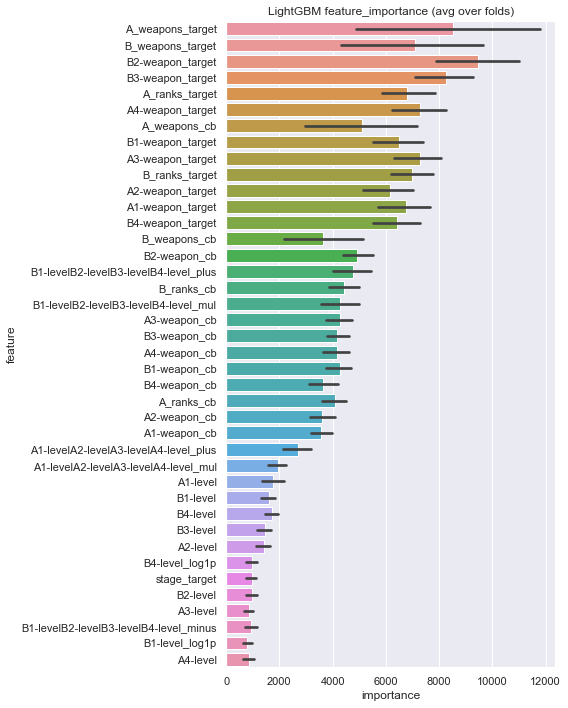

In [16]:
import sys

sys.path.append(r"C:\Users\81908\Git\OptGBM")
import optgbm as lgb


class Model:
    def __init__(self, OUTPUT_DIR):
        self.OUTPUT_DIR = OUTPUT_DIR

    # LightGBM GBDT with KFold or Stratified KFold
    # Parameters from Tilii kernel: https://www.kaggle.com/tilii7/olivier-lightgbm-parameters-by-bayesian-opt/code
    def kfold_cv_LGBMClassifier(
        self,
        lgb_params: dict,
        df: pd.DataFrame,
        num_folds: int,
        target_col: str,
        del_cols=None,
        eval_metric="error",
        stratified=True,  # StratifiedKFoldにするか
        is_submission=False,  # Home_Credit_Default_Risk の submission.csv作成するか
        is_plot_perm_importance=False,  # permutation importanceも出すか. feature_importance はデフォルトでだす
    ):
        """
        LGBMClassifierでcross validation + feature_importance/permutation importance plot
        """
        # Divide in training/validation and test data
        train_df = df[df[target_col].notnull()].reset_index(drop=True)
        test_df = df[df[target_col].isnull()].reset_index(drop=True)
        print(
            "Starting LightGBM. Train shape: {}, test shape: {}".format(
                train_df.shape, test_df.shape
            )
        )
        del df
        gc.collect()

        # Cross validation model
        if stratified:
            folds = StratifiedKFold(n_splits=num_folds, shuffle=True, random_state=1001)
        else:
            folds = KFold(n_splits=num_folds, shuffle=True, random_state=1001)

        # Create arrays and dataframes to store results
        oof_preds = np.zeros(train_df.shape[0])
        sub_preds = np.zeros(test_df.shape[0])
        feature_importance_df = pd.DataFrame()
        permutation_importance_df = pd.DataFrame()
        result_scores = {}
        train_probas = {}
        test_probas = {}

        # 目的変数とID列など削除
        del_cols = del_cols.append(target_col) if del_cols is not None else [target_col]
        feats = [f for f in train_df.columns if f not in del_cols]

        for n_fold, (train_idx, valid_idx) in tqdm(
            enumerate(folds.split(train_df[feats], train_df[target_col]))
        ):
            t_fold_df = train_df.iloc[train_idx]
            v_fold_df = train_df.iloc[valid_idx]

            # カウントエンコディング
            t_fold_df, v_fold_df = count_encoder(
                t_fold_df, v_fold_df, cat_features=None
            )
            # ターゲットエンコディング
            t_fold_df, v_fold_df = target_encoder(
                t_fold_df, v_fold_df, target_col=target_col, cat_features=None
            )
            # CatBoostエンコディング
            t_fold_df, v_fold_df = catboost_encoder(
                t_fold_df, v_fold_df, target_col=target_col, cat_features=None
            )
            # ラベルエンコディング
            cate_cols = t_fold_df.select_dtypes(
                include=["object", "category", "bool"]
            ).columns.to_list()
            for col in cate_cols:
                t_fold_df[col], uni = pd.factorize(t_fold_df[col])
                v_fold_df[col], uni = pd.factorize(v_fold_df[col])
            print(
                "run encoding Train shape: {}, valid shape: {}".format(
                    t_fold_df.shape, v_fold_df.shape
                )
            )

            feats = t_fold_df.columns.to_list()
            feats.remove(target_col)

            train_x, train_y = (
                t_fold_df[feats],
                t_fold_df[target_col],
            )
            valid_x, valid_y = (
                v_fold_df[feats],
                v_fold_df[target_col],
            )

            ############################ train fit ############################
            # LightGBM parameters found by Bayesian optimization
            clf = lgb.LGBMClassifier(**lgb_params)

            clf.fit(
                train_x,
                train_y,
                # eval_set=[(train_x, train_y), (valid_x, valid_y)],
                # eval_metric=eval_metric,
                # verbose=200,
                # early_stopping_rounds=200,
            )

            # モデル保存
            joblib.dump(clf, f"{self.OUTPUT_DIR}/lgb-{n_fold + 1}.model", compress=True)

            # valid pred
            oof_preds[valid_idx] = clf.predict_proba(
                valid_x, num_iteration=clf.best_iteration_
            )[:, 1]

            ############################ test pred ############################
            # カウントエンコディング
            tr_df, te_df = count_encoder(train_df, test_df, cat_features=None)
            # ターゲットエンコディング
            tr_df, te_df = target_encoder(
                tr_df, te_df, target_col=target_col, cat_features=None
            )
            # CatBoostエンコディング
            tr_df, te_df = catboost_encoder(
                tr_df, te_df, target_col=target_col, cat_features=None
            )
            # ラベルエンコディング
            cate_cols = tr_df.select_dtypes(
                include=["object", "category", "bool"]
            ).columns.to_list()
            for col in cate_cols:
                tr_df[col], uni = pd.factorize(tr_df[col])
                te_df[col], uni = pd.factorize(te_df[col])

            # testの確信度
            test_probas[f"fold_{str(n_fold + 1)}"] = clf.predict_proba(
                te_df[feats], num_iteration=clf.best_iteration_
            )[:, 1]
            sub_preds += test_probas[f"fold_{str(n_fold + 1)}"] / folds.n_splits

            # 一応trainの確信度も出しておく
            train_probas[f"fold_{str(n_fold + 1)}"] = clf.predict_proba(
                tr_df[feats], num_iteration=clf.best_iteration_
            )[:, 1]

            if eval_metric == "auc":
                fold_auc = roc_auc_score(valid_y, oof_preds[valid_idx])
                print("Fold %2d AUC : %.6f" % (n_fold + 1, fold_auc))
                result_scores[f"fold_auc_{str(n_fold + 1)}"] = fold_auc
            elif eval_metric == "error":
                # intにしないとaccuracy_score()エラーになる
                _pred = oof_preds[valid_idx]
                _pred[_pred >= 0.5] = 1
                _pred[_pred < 0.5] = 0
                fold_err = 1.0 - accuracy_score(valid_y, _pred)
                print("Fold %2d error : %.6f" % (n_fold + 1, fold_err))
                result_scores[f"fold_err_{str(n_fold + 1)}"] = fold_err

            # feature_importance
            fold_importance_df = pd.DataFrame()
            fold_importance_df["feature"] = feats
            fold_importance_df["importance"] = clf.feature_importances_
            fold_importance_df["fold"] = n_fold + 1
            feature_importance_df = pd.concat(
                [feature_importance_df, fold_importance_df], axis=0
            )

            del clf, train_x, train_y, valid_x, valid_y
            gc.collect()

        if eval_metric == "auc":
            mean_fold_auc = roc_auc_score(train_df[target_col], oof_preds)
            print("Full AUC score %.6f" % mean_fold_auc)
            result_scores["mean_fold_auc"] = mean_fold_auc
        elif eval_metric == "error":
            # intにしないとaccuracy_score()エラーになる
            _pred = oof_preds
            _pred[_pred >= 0.5] = 1
            _pred[_pred < 0.5] = 0
            mean_fold_err = 1.0 - accuracy_score(train_df[target_col], _pred)
            print("Full error score %.6f" % mean_fold_err)
            result_scores["mean_fold_err"] = mean_fold_err

        # モデルのスコア出力
        result_scores_df = pd.DataFrame(
            result_scores.values(), index=result_scores.keys()
        )
        result_scores_df.to_csv(f"{self.OUTPUT_DIR}/result_scores.tsv", sep="\t")

        test_probas_df = pd.DataFrame(test_probas)
        test_probas_df.to_csv(f"{self.OUTPUT_DIR}/test_probas.tsv", index=False)
        train_probas_df = pd.DataFrame(train_probas)
        train_probas_df.to_csv(f"{self.OUTPUT_DIR}/train_probas.tsv", index=False)
        # Write submission file (Home_Credit_Default_Risk)
        if is_submission:
            sub_preds[sub_preds >= 0.5] = 1
            sub_preds[sub_preds < 0.5] = 0
            test_df[target_col] = sub_preds
            submission_file_name = f"{self.OUTPUT_DIR}/submission_kernel.csv"
            sub_df = test_df[[target_col]]
            sub_df["id"] = test_df.index
            sub_df.astype(int)
            sub_df = sub_df[["id", "y"]]
            sub_df.to_csv(submission_file_name, index=False)

        # Plot feature importance
        Model("").display_importances(
            feature_importance_df,
            png_path=f"{self.OUTPUT_DIR}/lgbm_feature_importances.png",
            title="feature_importance",
        )
        if is_plot_perm_importance:
            Model("").display_importances(
                permutation_importance_df,
                png_path=f"{self.OUTPUT_DIR}/lgbm_permutation_importances.png",
                title="permutation_importance",
            )

        return feature_importance_df, permutation_importance_df

    # Display/plot feature/permutation importance
    @staticmethod
    def display_importances(
        importance_df_, png_path, title,
    ):
        cols = (
            importance_df_[["feature", "importance"]]
            .groupby("feature")
            .mean()
            .sort_values(by="importance", ascending=False)[:40]
            .index
        )
        best_features = importance_df_.loc[importance_df_.feature.isin(cols)]
        plt.figure(figsize=(8, 10))
        sns.barplot(
            x="importance",
            y="feature",
            data=best_features.sort_values(by="importance", ascending=False),
        )
        plt.title(f"LightGBM {title} (avg over folds)")
        plt.tight_layout()
        plt.savefig(png_path)


if __name__ == "__main__":
    df = df_all

    # df_all = pd.read_csv(f"{OUT_DATA}/feature_add.csv")
    # cols = pd.read_csv(f"{OUT_DATA}/feature_selections.csv")["feature_selections"].values.tolist()
    # cols.append("y")
    # df = df_all[cols]

    is_debug = False
    # is_debug = True
    if is_debug:
        _df = df.head(1000)
        _df = _df.append(df.tail(100))
        df = _df

    model = Model(OUT_MODEL)
    lgb_params = dict(
        n_estimators=10000,
        learning_rate=0.01,
        silent=-1,
        verbose=-1,
        # verbose=1,
        importance_type="gain",
    )
    params = dict(
        lgb_params=lgb_params,
        df=df,
        num_folds=10,
        target_col="y",
        del_cols=None,
        eval_metric="error",
        stratified=True,
        is_submission=True,
        is_plot_perm_importance=False,
    )
    feat_importance, perm_importance = model.kfold_cv_LGBMClassifier(**params)
